In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import math
%matplotlib inline
plt.style.use('seaborn')
from scipy.ndimage.filters import gaussian_filter1d
import os
from google.colab import files

# This notebook is for ONLY GETTING THE LAST 6 MONTHS (ever since November 1, 2020)

# Load Initial Data

In [3]:
BASE_DIR = '/content/drive/My Drive/4th Year/CS 197 (Thesis)/FINAL - COVID Modeling/notebooks'
file_path = os.path.join(BASE_DIR, 'data/normalized_5day_moving.csv')
moved_scaled = pd.read_csv(file_path, index_col=0)
moved_scaled['Province/State'] = moved_scaled['Province/State'].fillna('no province')
moved_scaled['area']=moved_scaled['Province/State']+" "+moved_scaled['Country/Region']
moved_scaled.head()

,Province/State,Country/Region,Lat,Long,populations,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.137644e-09,...,3.442222e-07,3.955986e-07,5.754162e-07,4.264245e-07,5.600032e-07,4.675256e-07,4.007363e-07,2.928457e-07,4.366998e-07,4.315621e-07,5.548656e-07,5.548656e-07,7.038573e-07,6.833067e-07,6.319303e-07,6.833067e-07,7.757843e-07,7.038573e-07,6.011044e-07,6.678938e-07,8.117478e-07,0.000001,0.000001,0.000001,0.000001,0.000002,0.000001,0.000001,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,2.459520e-04,2.337899e-04,2.241993e-04,2.252417e-04,2.269097e-04,2.207939e-04,2.119677e-04,1.956358e-04,1.881300e-04,1.770799e-04,1.754120e-04,1.881995e-04,1.811108e-04,1.611649e-04,1.579681e-04,1.547017e-04,1.401072e-04,1.457365e-04,1.589410e-04,1.476129e-04,1.359373e-04,0.000135,0.000130,0.000119,0.000123,0.000126,0.000114,0.000099,0.000094,0.000092,0.000088,0.000095,0.000101,0.000092,0.000086,0.000081,0.000068,0.000064,0.000065,0.000059
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,3.343136e-06,3.406988e-06,3.530133e-06,3.470841e-06,3.292966e-06,3.324892e-06,3.142457e-06,3.101408e-06,3.188065e-06,3.215431e-06,2.991947e-06,2.814072e-06,2.586027e-06,2.312374e-06,2.134499e-06,2.175547e-06,2.280447e-06,2.257643e-06,2.221156e-06,2.316935e-06,2.362544e-06,0.000002,0.000003,0.000003,0.000003,0.000003,0.000002,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000004,0.000004,0.000004
3,no province,Andorra,42.50630,1.521800,77265,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,3.416812e-04,2.873228e-04,4.063936e-04,4.115706e-04,4.581635e-04,4.115706e-04,4.892254e-04,4.167476e-04,4.271015e-04,4.271015e-04,4.969909e-04,5.125218e-04,4.788714e-04,5.125218e-04,5.358183e-04,5.332298e-04,5.565262e-04,6.833625e-04,6.704200e-04,6.471235e-04,6.652430e-04,0.000720,0.000632,0.000686,0.000740,0.000743,0.000714,0.000712,0.000642,0.000608,0.000582,0.000546,0.000562,0.000564,0.000531,0.000479,0.000373,0.000432,0.000492,0.000494
4,no province,Angola,-11.20270,17.873900,32866272,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,8.215109e-07,9.127899e-07,1.089263e-06,1.308332e-06,1.618681e-06,1.496975e-06,1.466549e-06,1.363100e-06,1.430037e-06,1.594340e-06,1.758642e-06,1.746471e-06,1.630851e-06,1.314417e-06,1.180542e-06,1.326588e-06,1.387441e-06,1.667363e-06,1.758642e-06,1.801239e-06,1.630851e-06,0.000002,0.000002,0.000002,0.000003,0.000003,0.000002,0.000003,0.000003,0.000003,0.000004,0.000004,0.000003,0.000003,0.000004,0.000004,0.000004,0.000004,0.000005,0.000004


In [4]:
# Keep only the dates ever since this start date
def filter_dates(df, start_col=6):
  START_DATE = '11/1/20'
  df_copy = df.copy()

  first_date = df_copy.columns.get_loc('11/1/20')
  new_columns = df_copy.columns[:start_col].tolist() + df_copy.columns[first_date:].tolist()
  df_copy = df_copy[new_columns]

  return df_copy

In [5]:
moved_scaled = filter_dates(moved_scaled)
moved_scaled.head()

,Province/State,Country/Region,Lat,Long,populations,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.000002,0.000003,0.000002,0.000002,0.000003,0.000002,0.000002,0.000002,0.000002,0.000003,0.000003,0.000004,0.000004,0.000004,0.000004,0.000004,0.000005,0.000005,0.000006,0.000006,0.000005,0.000005,0.000005,0.000005,0.000005,0.000006,0.000005,0.000004,0.000005,0.000005,0.000005,0.000005,0.000005,0.000004,...,3.442222e-07,3.955986e-07,5.754162e-07,4.264245e-07,5.600032e-07,4.675256e-07,4.007363e-07,2.928457e-07,4.366998e-07,4.315621e-07,5.548656e-07,5.548656e-07,7.038573e-07,6.833067e-07,6.319303e-07,6.833067e-07,7.757843e-07,7.038573e-07,6.011044e-07,6.678938e-07,8.117478e-07,0.000001,0.000001,0.000001,0.000001,0.000002,0.000001,0.000001,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.000102,0.000103,0.000110,0.000116,0.000128,0.000140,0.000152,0.000160,0.000169,0.000179,0.000180,0.000174,0.000173,0.000174,0.000176,0.000183,0.000203,0.000218,0.000236,0.000252,0.000262,0.000253,0.000258,0.000256,0.000242,0.000237,0.000242,0.000225,0.000231,0.000225,0.000237,0.000241,0.000258,0.000256,...,2.459520e-04,2.337899e-04,2.241993e-04,2.252417e-04,2.269097e-04,2.207939e-04,2.119677e-04,1.956358e-04,1.881300e-04,1.770799e-04,1.754120e-04,1.881995e-04,1.811108e-04,1.611649e-04,1.579681e-04,1.547017e-04,1.401072e-04,1.457365e-04,1.589410e-04,1.476129e-04,1.359373e-04,0.000135,0.000130,0.000119,0.000123,0.000126,0.000114,0.000099,0.000094,0.000092,0.000088,0.000095,0.000101,0.000092,0.000086,0.000081,0.000068,0.000064,0.000065,0.000059
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.000007,0.000007,0.000008,0.000009,0.000010,0.000012,0.000013,0.000014,0.000014,0.000015,0.000016,0.000017,0.000018,0.000019,0.000019,0.000020,0.000020,0.000021,0.000022,0.000023,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000023,0.000022,0.000022,0.000021,...,3.343136e-06,3.406988e-06,3.530133e-06,3.470841e-06,3.292966e-06,3.324892e-06,3.142457e-06,3.101408e-06,3.188065e-06,3.215431e-06,2.991947e-06,2.814072e-06,2.586027e-06,2.312374e-06,2.134499e-06,2.175547e-06,2.280447e-06,2.257643e-06,2.221156e-06,2.316935e-06,2.362544e-06,0.000002,0.000003,0.000003,0.000003,0.000003,0.000002,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000004,0.000004,0.000004
3,no province,Andorra,42.50630,1.521800,77265,no province Andorra,0.001074,0.000960,0.000888,0.000984,0.000981,0.000802,0.001116,0.001224,0.001015,0.000885,0.001118,0.000769,0.000885,0.000745,0.001022,0.000898,0.000867,0.000758,0.000883,0.000699,0.000758,0.000789,0.000740,0.000738,0.000740,0.000846,0.000916,0.000792,0.000934,0.000821,0.000663,0.000601,0.000761,0.000629,...,3.416812e-04,2.873228e-04,4.063936e-04,4.115706e-04,4.581635e-04,4.115706e-04,4.892254e-04,4.167476e-04,4.271015e-04,4.271015e-04,4.969909e-04,5.125218e-04,4.788714e-04,5.125218e-04,5.358183e-04,5.332298e-04,5.565262e-04,6.833625e-04,6.704200e-04,6.471235e-04,6.652430e-04,0.000720,0.000632,0.000686,0.000740,0.000743,0.000714,0.000712,0.000642,0.000608,0.000582,0.000546,0.000562,0.000564,0.000531,0.000479,0.000373,0.000432,0.000492,0.000494
4,no province,Angola,-11.20270,17.873

In [6]:
moved_scaled.shape

(263, 175)

### Load Graphs

In [7]:
def get_graphs(df, areas=['no province Philippines'], startc=7):
  fig=plt.figure(figsize=(50,20))
  ax=fig.add_axes([0,0,1,1])
  ax.set_xlabel("Dates")
  ax.set_ylabel("Cases")
  for area in areas:
    try:
        df_area = df[df['area'] == area]
        x = df_area.columns[startc:]
        y=[]
        for i in x:
          y.append(df_area[i].values.sum())
        
        ax.plot(x,y,label=area)
        #comment out the line below to remove the labels of the area names.
        #ax.legend()
    except IndexError:
        # No South Korea in the dataset
        print("area is not in the dataset")
        
# get_graphs(moved_scaled, areas=moved_scaled['area'])

In [8]:
# Single country / Multiple countries
def get_graph(df, country='Philippines', index=None, startc=7, endc=None):
  try:
    if index:
      df_country = df.loc[index]
    else:
      if isinstance(country, str):
        df_country = df[df['Country/Region'] == country]
      else:
        df_country = df[df['Country/Region'].isin(country)]
  
    fig=plt.figure()
    ax=fig.add_axes([0,0,1,1])
    fig.suptitle(df_country['area'].values[0], fontsize=16)
    ax.set_xlabel("Dates")
    ax.set_ylabel("Cases")
    ax.get_xaxis().set_ticks([])
    # ax.get_yaxis().set_ticks([])

    if endc:
      x = df_country.columns[startc:-endc]
    else:
      x = df_country.columns[startc:]
    y = df_country[x]

    for idx, row in y.iterrows():
      ax.plot(x, row)

    fig.legend(df_country['area'])

    # ax.plot(x,y)
  except IndexError:
    # No South Korea in the dataset
    print("Country is not in the dataset")

In [9]:
import math

# Multiple countries
def compare_graphs(df, range_of_index=(0,10), num_rows=4, figsize=(10,10)):
  start_index = range_of_index[0]
  end_index = range_of_index[1]
  df_country = df.loc[start_index:end_index]
  num_cols = math.ceil(df_country.shape[0] / num_rows)

  fig, axs = plt.subplots(num_rows, num_cols, figsize=figsize)
  fig.suptitle('Countries from {} to {}'.format(df_country.loc[start_index, 'area'], df_country.loc[end_index, 'area'], fontsize=16))
  x = df.columns[7:]
  ctr = 0

  for i in range(num_rows):
    for j in range(num_cols):
      if start_index + ctr <= end_index:
        try:
          curr_country = df_country.loc[start_index + ctr]
          y = [curr_country[i] for i in x]
          axs[i, j].plot(x, y)
          axs[i, j].set_title(curr_country['area'])
          axs[i, j].get_xaxis().set_ticks([])
          axs[i, j].get_yaxis().set_ticks([])
          ctr += 1
        except KeyError:
          axs[i, j].axis('off')
      else:
        axs[i, j].axis('off')

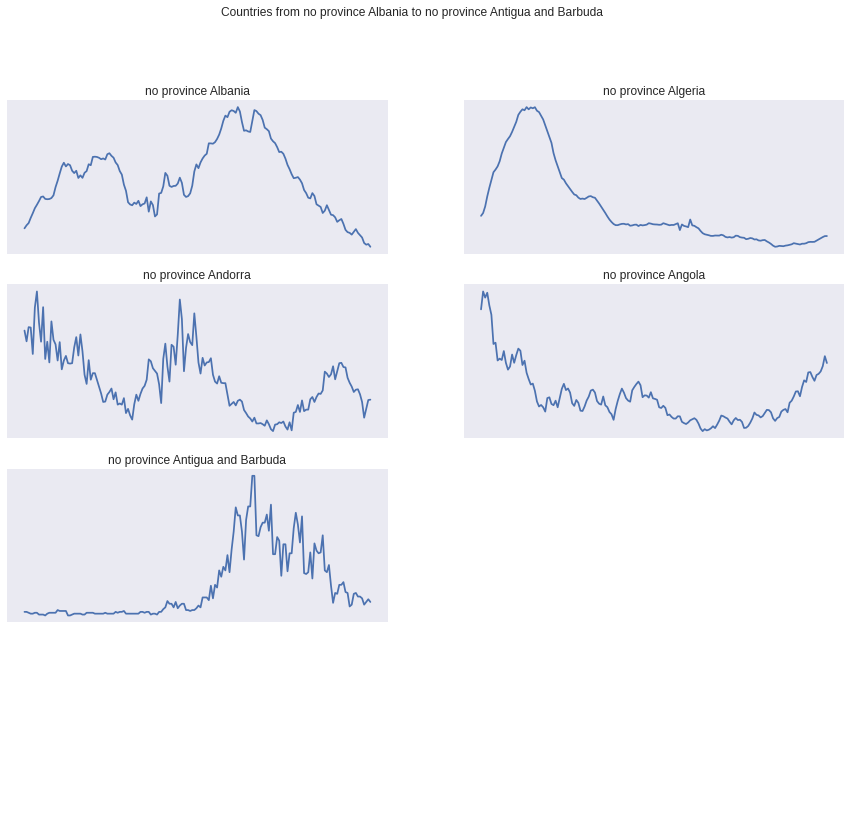

In [10]:
compare_graphs(moved_scaled, range_of_index=(1,5), figsize=(15,13))

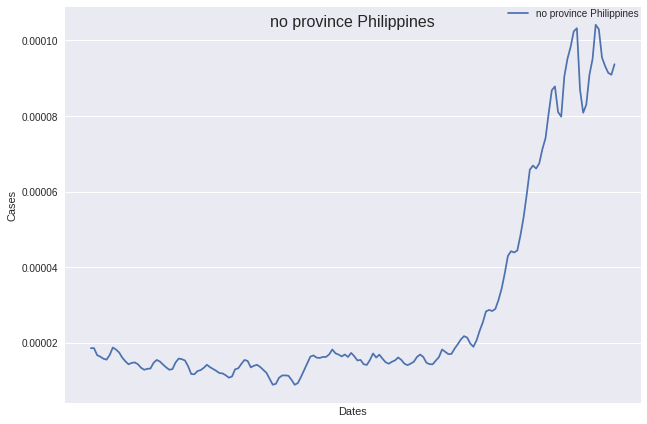

In [11]:
get_graph(moved_scaled, country='Philippines')

# Removing Outliers

In [12]:
df_daily_confirmed = pd.read_csv(
    os.path.join(BASE_DIR, 'data/daily_confirmed_filtered.csv'), index_col=0)

def get_total(df):
  df['total_cases'] = df.iloc[:, -1]
  df['Province/State'] = df['Province/State'].fillna('no province')
  df['area'] = df['Province/State'] + ' ' + df['Country/Region']
  columns = list(df.columns)
  columns = columns[:4] + columns[-2:] + columns[4:-2]
  df = df[columns]
  return df

df_daily_confirmed = get_total(df_daily_confirmed)
df_daily_confirmed.head()

,Province/State,Country/Region,Lat,Long,total_cases,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,72,no province Afghanistan,38928346,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,18,23,42,0,26,0,10,21,28,25,24,10,50,24,15,34,28,36,4,28,62,70,63,55,23,81,41,62,94,70,76,125,16,82,122,128,42,78,109,72
1,no province,Albania,41.15330,20.168300,138,no province Albania,2877797,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,631,602,681,698,653,543,475,446,590,494,519,659,344,303,448,472,449,425,493,285,304,434,349,336,341,348,264,141,256,317,286,360,238,125,234,207,169,179,149,138
2,no province,Algeria,28.03390,1.659600,156,no province Algeria,43851044,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,138,170,157,135,122,145,130,148,154,128,96,91,98,94,89,105,114,93,86,110,115,131,112,125,95,98,117,140,125,112,135,127,138,129,154,176,167,181,163,156
3,no province,Andorra,42.50630,1.521800,34,no province Andorra,77265,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,41,0,69,29,38,23,30,41,33,38,50,36,28,46,47,49,45,77,41,38,56,66,43,62,59,57,55,42,35,46,47,41,48,36,33,27,0,71,59,34
4,no province,Angola,-11.20270,17.873900,89,no province Angola,32866272,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,47,44,60,58,57,27,39,43,69,84,54,37,24,17,62,78,47,70,32,69,50,129,88,68,112,52,86,168,125,98,134,89,126,92,148,144,110,171,178,89


In [13]:
def move_last_cols_to_first(df, num_cols, start_col=7):
  columns = list(df.columns)
  columns = columns[:start_col] + columns[-num_cols:] + columns[start_col:-num_cols]
  df = df[columns]
  return df

In [14]:
dates_cols = df_daily_confirmed.columns[7:]
df_daily_confirmed['peak_cases'] = df_daily_confirmed[dates_cols].max(axis=1)
df_daily_confirmed['normalized_peak'] = df_daily_confirmed['peak_cases'] / df_daily_confirmed['populations']
df_daily_confirmed = move_last_cols_to_first(df_daily_confirmed, 2)
df_daily_confirmed.head()

,Province/State,Country/Region,Lat,Long,total_cases,area,populations,peak_cases,normalized_peak,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,72,no province Afghanistan,38928346,1485,0.000038,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,18,23,42,0,26,0,10,21,28,25,24,10,50,24,15,34,28,36,4,28,62,70,63,55,23,81,41,62,94,70,76,125,16,82,122,128,42,78,109,72
1,no province,Albania,41.15330,20.168300,138,no province Albania,2877797,1239,0.000431,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,631,602,681,698,653,543,475,446,590,494,519,659,344,303,448,472,449,425,493,285,304,434,349,336,341,348,264,141,256,317,286,360,238,125,234,207,169,179,149,138
2,no province,Algeria,28.03390,1.659600,156,no province Algeria,43851044,1133,0.000026,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,138,170,157,135,122,145,130,148,154,128,96,91,98,94,89,105,114,93,86,110,115,131,112,125,95,98,117,140,125,112,135,127,138,129,154,176,167,181,163,156
3,no province,Andorra,42.50630,1.521800,34,no province Andorra,77265,299,0.003870,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,41,0,69,29,38,23,30,41,33,38,50,36,28,46,47,49,45,77,41,38,56,66,43,62,59,57,55,42,35,46,47,41,48,36,33,27,0,71,59,34
4,no province,Angola,-11.20270,17.873900,89,no province Angola,32866272,355,0.000011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,47,44,60,58,57,27,39,43,69,84,54,37,24,17,62,78,47,70,32,69,50,129,88,68,112,52,86,168,125,98,134,89,126,92,148,144,110,171,178,89


In [15]:
df_outliers = df_daily_confirmed[df_daily_confirmed['peak_cases'] < 500]
df_outliers.head()

,Province/State,Country/Region,Lat,Long,total_cases,area,populations,peak_cases,normalized_peak,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
3,no province,Andorra,42.5063,1.5218,34,no province Andorra,77265,299,0.003870,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,41,0,69,29,38,23,30,41,33,38,50,36,28,46,47,49,45,77,41,38,56,66,43,62,59,57,55,42,35,46,47,41,48,36,33,27,0,71,59,34
4,no province,Angola,-11.2027,17.8739,89,no province Angola,32866272,355,0.000011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,47,44,60,58,57,27,39,43,69,84,54,37,24,17,62,78,47,70,32,69,50,129,88,68,112,52,86,168,125,98,134,89,126,92,148,144,110,171,178,89
5,no province,Antigua and Barbuda,17.0608,-61.7964,0,no province Antigua and Barbuda,97929,82,0.000837,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,20,0,63,17,1,0,29,0,16,3,22,0,39,8,0,23,19,0,6,8,0,0,11,5,18,0,3,0,4,3,2,15,1,0,3,0,8,4,3,0
8,Australian Capital Territory,Australia,-35.4735,149.0124,0,Australian Capital Territory Australia,429834,14,0.000033,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,New South Wales,Australia,-33.8688,151.2093,8,New South Wales Australia,8158000,241,0.000030,0,0,0,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,6,8,0,3,3,2,7,2,5,3,2,5,4,3,4,1,3,0,2,5,3,5,0,3,1,3,7,6,2,2,4,6,9,5,3,9,7,7,6,8


In [16]:
df_outliers['area'].values.tolist()

['no province Andorra',
 'no province Angola',
 'no province Antigua and Barbuda',
 'Australian Capital Territory Australia',
 'New South Wales Australia',
 'Northern Territory Australia',
 'Queensland Australia',
 'South Australia Australia',
 'Tasmania Australia',
 'Western Australia Australia',
 'no province Bahamas',
 'no province Barbados',
 'no province Bhutan',
 'no province Brunei',
 'no province Burkina Faso',
 'no province Burundi',
 'no province Cabo Verde',
 'Diamond Princess Canada',
 'Grand Princess Canada',
 'New Brunswick Canada',
 'Newfoundland and Labrador Canada',
 'Northwest Territories Canada',
 'Nova Scotia Canada',
 'Prince Edward Island Canada',
 'Yukon Canada',
 'no province Central African Republic',
 'no province Chad',
 'Anhui China',
 'Beijing China',
 'Chongqing China',
 'Fujian China',
 'Gansu China',
 'Guangdong China',
 'Guangxi China',
 'Guizhou China',
 'Hainan China',
 'Hebei China',
 'Heilongjiang China',
 'Henan China',
 'Hong Kong China',
 'Hunan 

In [17]:
moved_scaled = moved_scaled[~moved_scaled['area'].isin(df_outliers['area'])]
print(moved_scaled.shape)
moved_scaled.head()

(140, 175)


,Province/State,Country/Region,Lat,Long,populations,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.000002,0.000003,0.000002,0.000002,0.000003,0.000002,0.000002,0.000002,0.000002,0.000003,0.000003,0.000004,0.000004,0.000004,0.000004,0.000004,0.000005,0.000005,0.000006,0.000006,0.000005,0.000005,0.000005,0.000005,0.000005,0.000006,0.000005,0.000004,0.000005,0.000005,0.000005,0.000005,0.000005,0.000004,...,3.442222e-07,3.955986e-07,5.754162e-07,4.264245e-07,5.600032e-07,4.675256e-07,4.007363e-07,2.928457e-07,4.366998e-07,4.315621e-07,5.548656e-07,5.548656e-07,7.038573e-07,6.833067e-07,6.319303e-07,6.833067e-07,7.757843e-07,7.038573e-07,6.011044e-07,6.678938e-07,8.117478e-07,0.000001,0.000001,0.000001,0.000001,0.000002,0.000001,0.000001,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.000102,0.000103,0.000110,0.000116,0.000128,0.000140,0.000152,0.000160,0.000169,0.000179,0.000180,0.000174,0.000173,0.000174,0.000176,0.000183,0.000203,0.000218,0.000236,0.000252,0.000262,0.000253,0.000258,0.000256,0.000242,0.000237,0.000242,0.000225,0.000231,0.000225,0.000237,0.000241,0.000258,0.000256,...,2.459520e-04,2.337899e-04,2.241993e-04,2.252417e-04,2.269097e-04,2.207939e-04,2.119677e-04,1.956358e-04,1.881300e-04,1.770799e-04,1.754120e-04,1.881995e-04,1.811108e-04,1.611649e-04,1.579681e-04,1.547017e-04,1.401072e-04,1.457365e-04,1.589410e-04,1.476129e-04,1.359373e-04,0.000135,0.000130,0.000119,0.000123,0.000126,0.000114,0.000099,0.000094,0.000092,0.000088,0.000095,0.000101,0.000092,0.000086,0.000081,0.000068,0.000064,0.000065,0.000059
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.000007,0.000007,0.000008,0.000009,0.000010,0.000012,0.000013,0.000014,0.000014,0.000015,0.000016,0.000017,0.000018,0.000019,0.000019,0.000020,0.000020,0.000021,0.000022,0.000023,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000023,0.000022,0.000022,0.000021,...,3.343136e-06,3.406988e-06,3.530133e-06,3.470841e-06,3.292966e-06,3.324892e-06,3.142457e-06,3.101408e-06,3.188065e-06,3.215431e-06,2.991947e-06,2.814072e-06,2.586027e-06,2.312374e-06,2.134499e-06,2.175547e-06,2.280447e-06,2.257643e-06,2.221156e-06,2.316935e-06,2.362544e-06,0.000002,0.000003,0.000003,0.000003,0.000003,0.000002,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000004,0.000004,0.000004
6,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.000252,0.000233,0.000228,0.000216,0.000222,0.000245,0.000238,0.000208,0.000197,0.000201,0.000197,0.000211,0.000240,0.000240,0.000212,0.000199,0.000197,0.000190,0.000197,0.000215,0.000212,0.000183,0.000156,0.000143,0.000139,0.000147,0.000163,0.000171,0.000164,0.000151,0.000147,0.000145,0.000152,0.000159,...,1.231974e-04,1.379952e-04,1.597981e-04,1.651969e-04,1.492219e-04,1.424558e-04,1.425930e-04,1.446064e-04,1.536781e-04,1.734277e-04,1.763572e-04,1.577581e-04,1.493370e-04,1.541029e-04,1.547224e-04,1.609708e-04,2.003727e-04,2.177947e-04,2.080726e-04,2.333581e-04,2.418368e-04,0.000256,0.000274,0.000286,0.000270,0.000269,0.000258,0.000287,0.000340,0.000399,0.000462,0.000487,0.000463,0.000451,0.000466,0.000470,0.000495,0.000558,0.000556,0.000509
7,no province,Armenia,40.06

# Confirmed

## Smoothing Curves

In [18]:
new_dates = moved_scaled.columns[6:]
new_moved_scaled = moved_scaled.copy()
new_moved_scaled

,Province/State,Country/Region,Lat,Long,populations,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.939110,67.709953,38928346,no province Afghanistan,2.409555e-06,2.507170e-06,2.363316e-06,2.466069e-06,0.000003,0.000002,0.000002,0.000002,0.000002,0.000003,0.000003,0.000004,0.000004,0.000004,0.000004,0.000004,0.000005,0.000005,0.000006,0.000006,0.000005,0.000005,0.000005,0.000005,0.000005,0.000006,0.000005,0.000004,0.000005,0.000005,0.000005,0.000005,0.000005,0.000004,...,3.442222e-07,3.955986e-07,5.754162e-07,4.264245e-07,5.600032e-07,4.675256e-07,4.007363e-07,2.928457e-07,4.366998e-07,4.315621e-07,5.548656e-07,5.548656e-07,7.038573e-07,6.833067e-07,6.319303e-07,6.833067e-07,7.757843e-07,7.038573e-07,6.011044e-07,6.678938e-07,8.117478e-07,0.000001,0.000001,0.000001,1.402577e-06,0.000002,1.351200e-06,1.346063e-06,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002
1,no province,Albania,41.153300,20.168300,2877797,no province Albania,1.023700e-04,1.030649e-04,1.104317e-04,1.157830e-04,0.000128,0.000140,0.000152,0.000160,0.000169,0.000179,0.000180,0.000174,0.000173,0.000174,0.000176,0.000183,0.000203,0.000218,0.000236,0.000252,0.000262,0.000253,0.000258,0.000256,0.000242,0.000237,0.000242,0.000225,0.000231,0.000225,0.000237,0.000241,0.000258,0.000256,...,2.459520e-04,2.337899e-04,2.241993e-04,2.252417e-04,2.269097e-04,2.207939e-04,2.119677e-04,1.956358e-04,1.881300e-04,1.770799e-04,1.754120e-04,1.881995e-04,1.811108e-04,1.611649e-04,1.579681e-04,1.547017e-04,1.401072e-04,1.457365e-04,1.589410e-04,1.476129e-04,1.359373e-04,0.000135,0.000130,0.000119,1.225938e-04,0.000126,1.138371e-04,9.938158e-05,0.000094,0.000092,0.000088,0.000095,0.000101,0.000092,0.000086,0.000081,0.000068,0.000064,0.000065,0.000059
2,no province,Algeria,28.033900,1.659600,43851044,no province Algeria,7.142361e-06,7.060265e-06,7.511794e-06,8.556239e-06,0.000010,0.000012,0.000013,0.000014,0.000014,0.000015,0.000016,0.000017,0.000018,0.000019,0.000019,0.000020,0.000020,0.000021,0.000022,0.000023,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000023,0.000022,0.000022,0.000021,...,3.343136e-06,3.406988e-06,3.530133e-06,3.470841e-06,3.292966e-06,3.324892e-06,3.142457e-06,3.101408e-06,3.188065e-06,3.215431e-06,2.991947e-06,2.814072e-06,2.586027e-06,2.312374e-06,2.134499e-06,2.175547e-06,2.280447e-06,2.257643e-06,2.221156e-06,2.316935e-06,2.362544e-06,0.000002,0.000003,0.000003,2.636197e-06,0.000003,2.494809e-06,2.622515e-06,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000004,0.000004,0.000004
6,no province,Argentina,-38.416100,-63.616700,45195774,no province Argentina,2.518997e-04,2.327563e-04,2.277912e-04,2.157237e-04,0.000222,0.000245,0.000238,0.000208,0.000197,0.000201,0.000197,0.000211,0.000240,0.000240,0.000212,0.000199,0.000197,0.000190,0.000197,0.000215,0.000212,0.000183,0.000156,0.000143,0.000139,0.000147,0.000163,0.000171,0.000164,0.000151,0.000147,0.000145,0.000152,0.000159,...,1.231974e-04,1.379952e-04,1.597981e-04,1.651969e-04,1.492219e-04,1.424558e-04,1.425930e-04,1.446064e-04,1.536781e-04,1.734277e-04,1.763572e-04,1.577581e-04,1.493370e-04,1.541029e-04,1.547224e-04,1.609708e-04,2.003727e-04,2.177947e-04,2.080726e-04,2.333581e-04,2.418368e-04,0.000256,0.000274,0.000286,2.696093e-04,0.000269,2.581569e-04,2.866551e-04,0.000340,0.000399,0

In [19]:
new_moved_scaled.shape

(140, 175)

### Stack 7-day moving average for 5 times on all countries

In [20]:
"""
# Old version of doing moving average
def Moving_Ave_Stack(dff, days, times):
    NUM_DAYS = days
    new_dff = dff.copy()
    if times>0:
        
        dates = new_dff.columns[6:]
        for idx, date in enumerate(dates):
            seven_days = dates[idx : idx+NUM_DAYS]
            new_dff[date] = new_dff.apply(lambda x: x[seven_days].mean(), axis=1)
        times=times-1
        return Moving_Ave_Stack(new_dff, days, times)
    else:
        return new_dff
"""

# Slightly better way of doing a moving average using Pandas' rolling average
def get_moving_average(df, window_size, col_start=6):
  return pd.concat([
                    df[df.columns[:col_start]], 
                    df[df.columns[col_start:]].apply(
                        lambda x: x.rolling(window_size, axis=0).mean(), axis=1
                        ).fillna(0, axis=1)
                    ], axis=1)

def Moving_Ave_Stack(df, window_size, times, col_start=6):
  new_df = df.copy()
  for _ in range(times):
    new_df = get_moving_average(new_df, window_size, col_start)
  
  return new_df

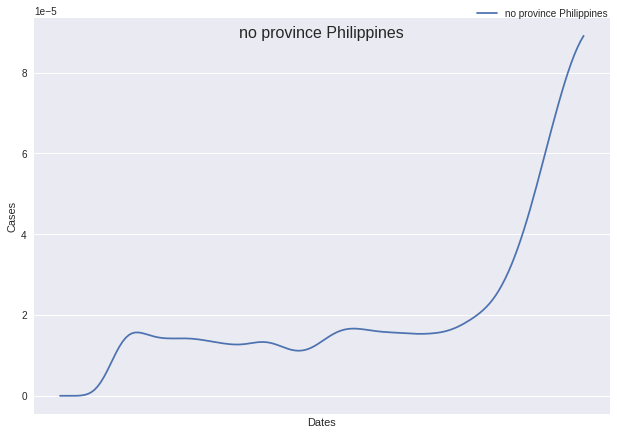

In [21]:
smoothen_moved_scaled = Moving_Ave_Stack(new_moved_scaled, 7, 5)
get_graph(smoothen_moved_scaled, country='Philippines')

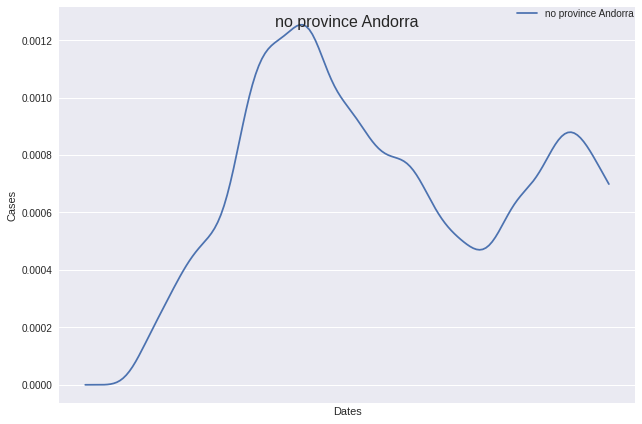

In [ ]:
get_graph(smoothen_moved_scaled, country='Andorra')

In [22]:
smoothen_moved_scaled.head()

,Province/State,Country/Region,Lat,Long,populations,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,1.002952e-09,5.003143e-09,1.498467e-08,3.494222e-08,6.992815e-08,1.261295e-07,2.109708e-07,3.292054e-07,4.830679e-07,6.723950e-07,8.946520e-07,0.000001,0.000001,0.000002,0.000002,0.000002,0.000003,0.000003,0.000003,0.000003,0.000004,0.000004,0.000004,0.000004,0.000004,0.000005,0.000005,0.000005,...,4.408449e-07,4.374796e-07,4.352490e-07,4.340400e-07,4.338294e-07,4.346398e-07,4.364815e-07,4.393253e-07,4.430134e-07,4.472716e-07,4.517334e-07,4.559659e-07,4.595693e-07,4.622715e-07,4.639644e-07,4.647690e-07,4.650655e-07,4.654143e-07,4.665682e-07,4.693393e-07,4.744665e-07,4.825449e-07,4.939888e-07,5.089456e-07,5.273821e-07,5.491053e-07,5.739260e-07,6.017956e-07,6.328739e-07,6.675325e-07,7.063755e-07,7.501364e-07,7.995149e-07,8.549732e-07,9.166289e-07,9.842418e-07,0.000001,0.000001,0.000001,0.000001
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,5.064183e-08,2.566371e-07,7.806871e-07,1.847552e-06,3.747876e-06,6.840914e-06,1.155655e-05,1.819405e-05,2.690931e-05,3.770003e-05,5.039082e-05,0.000065,0.000080,0.000095,0.000110,0.000124,0.000137,0.000149,0.000158,0.000167,0.000175,0.000182,0.000189,0.000195,0.000202,0.000209,0.000215,0.000221,...,3.562117e-04,3.531095e-04,3.490607e-04,3.440523e-04,3.381508e-04,3.314798e-04,3.241949e-04,3.164600e-04,3.084267e-04,3.002208e-04,2.919372e-04,2.836437e-04,2.753913e-04,2.672190e-04,2.591595e-04,2.512424e-04,2.434948e-04,2.359409e-04,2.285996e-04,2.214811e-04,2.145915e-04,2.079334e-04,2.015077e-04,1.953157e-04,1.893590e-04,1.836405e-04,1.781656e-04,1.729350e-04,1.679422e-04,1.631729e-04,1.586020e-04,1.541953e-04,1.499109e-04,1.457012e-04,1.415204e-04,1.373320e-04,0.000133,0.000129,0.000125,0.000120
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,3.853165e-09,1.967451e-08,6.027996e-08,1.436287e-07,2.932522e-07,5.386613e-07,9.157249e-07,1.451616e-06,2.163489e-06,3.057046e-06,4.125089e-06,0.000005,0.000007,0.000008,0.000009,0.000011,0.000012,0.000013,0.000015,0.000016,0.000017,0.000017,0.000018,0.000019,0.000020,0.000020,0.000021,0.000022,...,4.004700e-06,3.950668e-06,3.906281e-06,3.869214e-06,3.837311e-06,3.808759e-06,3.782129e-06,3.756340e-06,3.730518e-06,3.703933e-06,3.675949e-06,3.646024e-06,3.613715e-06,3.578695e-06,3.540722e-06,3.499596e-06,3.455073e-06,3.406814e-06,3.354328e-06,3.297027e-06,3.234286e-06,3.165650e-06,3.091055e-06,3.011048e-06,2.926902e-06,2.840694e-06,2.755178e-06,2.673590e-06,2.599277e-06,2.535307e-06,2.484091e-06,2.447141e-06,2.424887e-06,2.416727e-06,2.421184e-06,2.436225e-06,0.000002,0.000002,0.000003,0.000003
6,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.0,0.0,0.0,0.0,0.0,0.0,9.711674e-08,4.829460e-07,1.441449e-06,3.347366e-06,6.665108e-06,1.194811e-05,1.983857e-05,3.067909e-05,4.452361e-05,6.114587e-05,8.004561e-05,0.000100,0.000121,0.000141,0.000160,0.000175,0.000188,0.000198,0.000204,0.000208,0.000210,0.000210,0.000209,0.000207,0.000204,0.000201,0.000197,0.000193,...,1.340914e-04,1.347156e-04,1.351321e-04,1.353196e-04,1.353059e-04,1.351565e-04,1.349563e-04,1.347967e-04,1.347603e-04,1.349124e-04,1.352952e-04,1.359274e-04,1.368080e-04,1.379244e-04,1.392528e-04,1.407629e-04,1.424197e-04,1.441886e-04,1

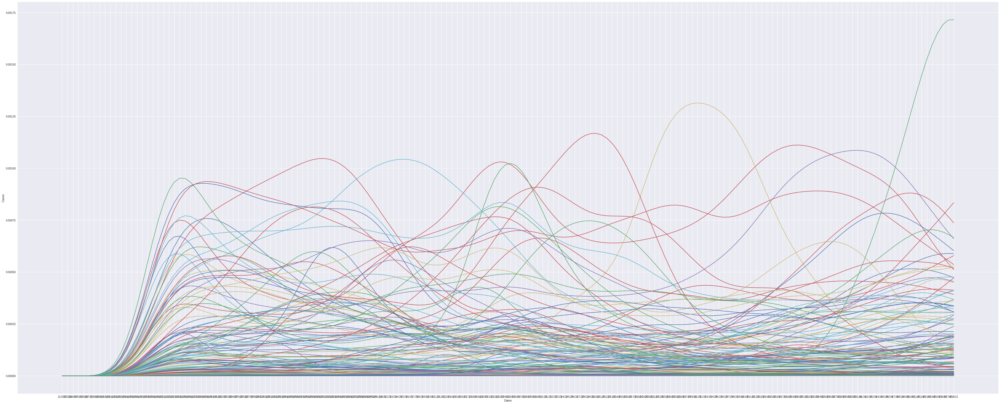

In [23]:
get_graphs(smoothen_moved_scaled, areas=smoothen_moved_scaled['area'])

## Normalize by Peak

In [24]:
def normalize_peak(df, start_col=6):
  smoothen_moved_scaled = df.copy()
  new_dates = df.columns[start_col:]
  peak = smoothen_moved_scaled[new_dates].to_numpy().max()
  print(peak)

  for col in new_dates:
    smoothen_moved_scaled[col] = smoothen_moved_scaled[col] / peak
  
  return smoothen_moved_scaled

In [25]:
smoothen_moved_scaled = normalize_peak(smoothen_moved_scaled)
smoothen_moved_scaled.head()

0.0017158444607138991


,Province/State,Country/Region,Lat,Long,populations,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,5.845237e-07,0.000003,0.000009,0.000020,0.000041,0.000074,0.000123,0.000192,0.000282,0.000392,0.000521,0.000667,0.000825,0.000988,0.001152,0.001314,0.001472,0.001624,0.001771,0.001912,0.002049,0.002183,0.002313,0.002437,0.002555,0.002662,0.002757,0.002838,...,0.000257,0.000255,0.000254,0.000253,0.000253,0.000253,0.000254,0.000256,0.000258,0.000261,0.000263,0.000266,0.000268,0.000269,0.000270,0.000271,0.000271,0.000271,0.000272,0.000274,0.000277,0.000281,0.000288,0.000297,0.000307,0.000320,0.000334,0.000351,0.000369,0.000389,0.000412,0.000437,0.000466,0.000498,0.000534,0.000574,0.000616,0.000661,0.000708,0.000757
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,2.951423e-05,0.000150,0.000455,0.001077,0.002184,0.003987,0.006735,0.010604,0.015683,0.021972,0.029368,0.037661,0.046527,0.055528,0.064289,0.072509,0.079975,0.086579,0.092320,0.097313,0.101777,0.105914,0.109891,0.113821,0.117752,0.121662,0.125465,0.129028,...,0.207601,0.205793,0.203434,0.200515,0.197075,0.193188,0.188942,0.184434,0.179752,0.174970,0.170142,0.165309,0.160499,0.155736,0.151039,0.146425,0.141910,0.137507,0.133229,0.129080,0.125065,0.121184,0.117439,0.113831,0.110359,0.107026,0.103836,0.100787,0.097877,0.095098,0.092434,0.089866,0.087369,0.084915,0.082479,0.080038,0.077578,0.075096,0.072598,0.070098
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,2.245638e-06,0.000011,0.000035,0.000084,0.000171,0.000314,0.000534,0.000846,0.001261,0.001782,0.002404,0.003116,0.003895,0.004710,0.005533,0.006339,0.007109,0.007828,0.008488,0.009091,0.009643,0.010152,0.010625,0.011068,0.011482,0.011871,0.012231,0.012560,...,0.002334,0.002302,0.002277,0.002255,0.002236,0.002220,0.002204,0.002189,0.002174,0.002159,0.002142,0.002125,0.002106,0.002086,0.002064,0.002040,0.002014,0.001986,0.001955,0.001922,0.001885,0.001845,0.001801,0.001755,0.001706,0.001656,0.001606,0.001558,0.001515,0.001478,0.001448,0.001426,0.001413,0.001408,0.001411,0.001420,0.001433,0.001451,0.001471,0.001493
6,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.0,0.0,0.0,0.0,0.0,0.0,5.659997e-05,0.000281,0.000840,0.001951,0.003884,0.006963,0.011562,0.017880,0.025949,0.035636,0.046651,0.058544,0.070710,0.082388,0.092997,0.102127,0.109531,0.115115,0.118937,0.121201,0.122262,0.122397,0.121822,0.120699,0.119149,0.117256,0.115079,0.112649,...,0.078149,0.078513,0.078755,0.078865,0.078857,0.078770,0.078653,0.078560,0.078539,0.078627,0.078850,0.079219,0.079732,0.080383,0.081157,0.082037,0.083003,0.084034,0.085112,0.086227,0.087376,0.088572,0.089850,0.091262,0.092882,0.094796,0.097090,0.099843,0.103114,0.106927,0.111275,0.116123,0.121418,0.127110,0.133167,0.139591,0.146425,0.153746,0.161645,0.170205
7,no province,Armenia,40.06910,45.038200,2963243,no province Armenia,0.0,0.0,0.0,0.0,0.0,0.0,1.689108e-04,0.000844,0.002530,0.005898,0.011781,0.021175,0.035232,0.054578,0.079312,0.108999,0.142673,0.178835,0.215464,0.250027,0.280507,0.305434,0.323894,0.335555,0.340671,0.340089,0.335238,0.327437,0.317864,0.307531,0.297250,0.287610,0.278957,0.271382,...,0.039873,0.041635,0.043621,0.045842,0.048308,0.051018,0.053968,0.057146,0.060540,0.064140,0.067939,0.071938,0.0761

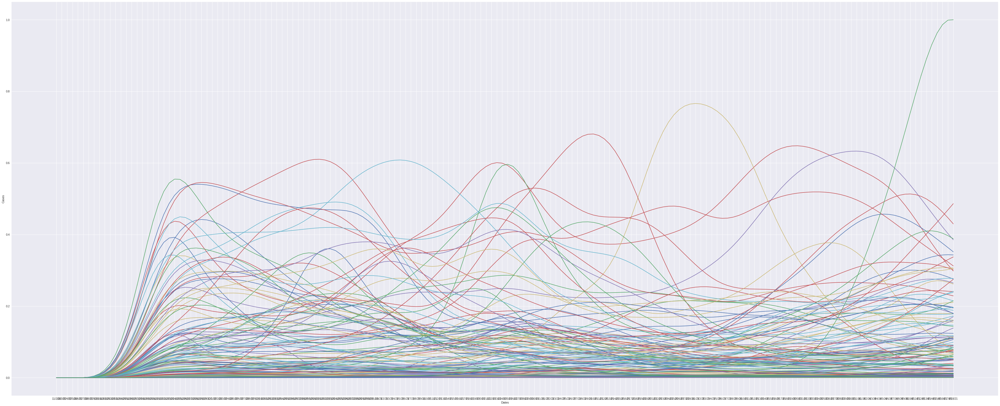

In [26]:
get_graphs(smoothen_moved_scaled, areas=smoothen_moved_scaled['area'])

In [27]:
# (smoothen_moved_scaled[new_dates].max(axis=1) == 1).argmax()
smoothen_moved_scaled.loc[16]

Province/State    no province
Country/Region        Austria
Lat                   47.5162
Long                  14.5501
populations           9006398
                     ...     
4/14/21              0.204831
4/15/21               0.20361
4/16/21              0.201817
4/17/21              0.199492
4/18/21              0.196707
Name: 16, Length: 175, dtype: object

In [28]:
smoothen_moved_scaled.shape

(140, 175)

## Saving as CSV

In [29]:
smoothen_moved_scaled.to_csv(os.path.join(BASE_DIR, 'data/new_normalized_confirmed_6months.csv'))

# Deaths

In [30]:
file_path = os.path.join(BASE_DIR, 'data/time_series_covid19_deaths_global.csv')
deaths = pd.read_csv(file_path)
deaths = deaths.drop(deaths.columns[-1], axis=1)
deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2451,2451,2454,2454,2457,2459,2460,2460,2462,2462,2462,2463,2464,2466,2466,2467,2467,2469,2470,2472,2476,2484,2489,2495,2496,2497,2508,2512,2512,2516,2521,2521,2521,2529,2529,2532,2533,2535,2539,2539
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1986,2002,2018,2030,2045,2060,2077,2092,2106,2122,2133,2137,2145,2156,2171,2184,2192,2204,2210,2216,2227,2235,2241,2247,2256,2265,2274,2283,2291,2297,2304,2310,2317,2321,2326,2331,2335,2337,2340,2342
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,3026,3028,3031,3034,3036,3040,3045,3048,3051,3053,3055,3057,3061,3066,3069,3071,3074,3077,3080,3084,3089,3093,3096,3099,3102,3105,3108,3112,3116,3119,3123,3126,3130,3134,3137,3141,3144,3148,3152,3155
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,112,112,112,112,113,113,113,113,113,113,113,113,113,113,114,114,114,115,115,115,115,115,115,116,117,117,117,117,119,120,120,120,120,121,121,121,121,123,123,123
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,516,517,519,520,521,521,522,522,522,524,526,527,530,530,532,532,532,533,533,534,536,537,538,538,540,542,543,547,547,549,549,550,553,554,554,557,557,560,561,561


In [32]:
columns = deaths.columns

In [33]:
# Copies the specified columns into a new Dataframe
daily_deaths = deaths.copy()
print(len(columns))

for i in range(5, len(columns)):
    daily = deaths[columns[i]] - deaths[columns[i-1]]
    daily_deaths[columns[i]]=daily

daily_deaths.head()

457


,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,17,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,4,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,2,1,0,0,0,1,0,0,0,2,0,0
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,2,1,1,0,1,0,0,2,2,1,3,0,2,0,0,1,0,1,2,1,1,0,2,2,1,4,0,2,0,1,3,1,0,3,0,3,1,0


In [34]:
# Combine province/state and country into one column
daily_deaths['Province/State']=daily_deaths['Province/State'].fillna("no province")
daily_deaths['area']=daily_deaths['Province/State']+" "+daily_deaths['Country/Region']
daily_deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21,area
0,no province,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0,no province Afghanistan
1,no province,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2,no province Albania
2,no province,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3,no province Algeria
3,no province,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,2,1,0,0,0,1,0,0,0,2,0,0,no province Andorra
4,no province,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,2,1,1,0,1,0,0,2,2,1,3,0,2,0,0,1,0,1,2,1,1,0,2,2,1,4,0,2,0,1,3,1,0,3,0,3,1,0,no province Angola


In [35]:
cols = daily_deaths.columns.tolist()
cols = cols[:4] + [cols[-1]] + cols[4:-1]
daily_deaths = daily_deaths[cols]
daily_deaths.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,17,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,4,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,2,1,0,0,0,1,0,0,0,2,0,0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,2,1,1,0,1,0,0,2,2,1,3,0,2,0,0,1,0,1,2,1,1,0,2,2,1,4,0,2,0,1,3,1,0,3,0,3,1,0


In [36]:
filtered_deaths = filter_dates(daily_deaths, start_col=5)
filtered_deaths.head()

,Province/State,Country/Region,Lat,Long,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,12/5/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,6,3,4,6,0,2,6,12,3,4,10,4,10,12,15,6,7,5,13,12,12,12,13,13,9,3,12,22,21,27,19,5,0,18,...,0,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0
1,no province,Albania,41.15330,20.168300,no province Albania,9,9,5,4,7,6,8,2,12,8,11,8,7,7,11,8,6,9,11,15,13,14,17,19,8,10,18,16,11,12,12,17,13,18,19,...,17,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2
2,no province,Algeria,28.03390,1.659600,no province Algeria,9,7,0,19,12,13,12,12,14,15,16,18,13,15,15,14,18,20,18,12,19,17,22,15,20,23,20,21,17,21,16,17,16,12,9,...,4,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,2,1,0,0,0,1,0,0,0,2,0,0
4,no province,Angola,-11.20270,17.873900,no province Angola,2,3,2,5,3,1,3,4,1,0,4,3,2,5,0,2,4,4,1,1,2,1,0,1,2,1,1,3,1,2,2,1,1,1,1,...,0,1,2,1,1,0,1,0,0,2,2,1,3,0,2,0,0,1,0,1,2,1,1,0,2,2,1,4,0,2,0,1,3,1,0,3,0,3,1,0


### Normalize by Population

### Filtered (only since Nov 1 2021)

In [37]:
daily_death_rate = pd.merge(filtered_deaths, moved_scaled[moved_scaled.columns[4:6]], on='area')
daily_death_rate.head()

,Province/State,Country/Region,Lat,Long,area,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,12/5/20,...,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21,populations
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,6,3,4,6,0,2,6,12,3,4,10,4,10,12,15,6,7,5,13,12,12,12,13,13,9,3,12,22,21,27,19,5,0,18,...,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0,38928346
1,no province,Albania,41.15330,20.168300,no province Albania,9,9,5,4,7,6,8,2,12,8,11,8,7,7,11,8,6,9,11,15,13,14,17,19,8,10,18,16,11,12,12,17,13,18,19,...,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2,2877797
2,no province,Algeria,28.03390,1.659600,no province Algeria,9,7,0,19,12,13,12,12,14,15,16,18,13,15,15,14,18,20,18,12,19,17,22,15,20,23,20,21,17,21,16,17,16,12,9,...,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3,43851044
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,138,483,429,468,246,370,212,212,347,276,348,251,263,262,129,291,379,241,185,258,112,100,120,310,282,227,275,106,151,257,198,228,149,207,120,...,134,85,68,24,166,200,195,155,90,41,28,126,152,123,146,143,133,81,162,125,122,83,82,83,93,272,163,198,290,228,297,132,178,217,368,383,159,80,64,45195774
4,no province,Armenia,40.06910,45.038200,no province Armenia,22,28,22,35,28,30,27,26,21,29,27,32,29,41,25,25,23,28,31,30,31,21,24,26,38,28,22,31,21,22,29,35,26,23,32,...,2,4,10,2,10,12,5,19,19,12,16,12,24,14,18,18,16,14,12,21,18,18,19,23,17,22,13,20,28,22,23,15,18,22,19,23,18,24,19,2963243


In [38]:
cols = daily_death_rate.columns.tolist()
cols = cols[:5] + cols[-1::] + cols[5:-1]
daily_death_rate = daily_death_rate[cols]
daily_death_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0,6,3,4,6,0,2,6,12,3,4,10,4,10,12,15,6,7,5,13,12,12,12,13,13,9,3,12,22,21,27,19,5,0,...,0,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,9,9,5,4,7,6,8,2,12,8,11,8,7,7,11,8,6,9,11,15,13,14,17,19,8,10,18,16,11,12,12,17,13,18,...,17,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,9,7,0,19,12,13,12,12,14,15,16,18,13,15,15,14,18,20,18,12,19,17,22,15,20,23,20,21,17,21,16,17,16,12,...,4,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,138,483,429,468,246,370,212,212,347,276,348,251,263,262,129,291,379,241,185,258,112,100,120,310,282,227,275,106,151,257,198,228,149,207,...,107,134,85,68,24,166,200,195,155,90,41,28,126,152,123,146,143,133,81,162,125,122,83,82,83,93,272,163,198,290,228,297,132,178,217,368,383,159,80,64
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,22,28,22,35,28,30,27,26,21,29,27,32,29,41,25,25,23,28,31,30,31,21,24,26,38,28,22,31,21,22,29,35,26,23,...,5,2,4,10,2,10,12,5,19,19,12,16,12,24,14,18,18,16,14,12,21,18,18,19,23,17,22,13,20,28,22,23,15,18,22,19,23,18,24,19


In [39]:
for col in daily_death_rate.columns[6:]:
    daily_death_rate[col]=daily_death_rate[col]/daily_death_rate['populations']
daily_death_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.000000e+00,1.541293e-07,7.706467e-08,1.027529e-07,1.541293e-07,0.000000e+00,5.137644e-08,1.541293e-07,3.082587e-07,7.706467e-08,1.027529e-07,2.568822e-07,1.027529e-07,2.568822e-07,3.082587e-07,3.853233e-07,1.541293e-07,1.798176e-07,1.284411e-07,3.339469e-07,3.082587e-07,3.082587e-07,3.082587e-07,3.339469e-07,3.339469e-07,2.311940e-07,7.706467e-08,3.082587e-07,5.651409e-07,5.394527e-07,6.935820e-07,4.880762e-07,1.284411e-07,0.000000e+00,...,0.000000e+00,0.000000e+00,7.706467e-08,0.000000e+00,7.706467e-08,5.137644e-08,2.568822e-08,0.000000e+00,5.137644e-08,0.000000e+00,0.000000e+00,2.568822e-08,2.568822e-08,5.137644e-08,0.000000e+00,2.568822e-08,0.000000e+00,5.137644e-08,2.568822e-08,5.137644e-08,1.027529e-07,2.055058e-07,1.284411e-07,1.541293e-07,2.568822e-08,2.568822e-08,2.825704e-07,1.027529e-07,0.000000e+00,1.027529e-07,1.284411e-07,0.000000e+00,0.000000e+00,2.055058e-07,0.000000e+00,7.706467e-08,2.568822e-08,5.137644e-08,1.027529e-07,0.000000e+00
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,3.127392e-06,3.127392e-06,1.737440e-06,1.389952e-06,2.432416e-06,2.084928e-06,2.779904e-06,6.949761e-07,4.169856e-06,2.779904e-06,3.822368e-06,2.779904e-06,2.432416e-06,2.432416e-06,3.822368e-06,2.779904e-06,2.084928e-06,3.127392e-06,3.822368e-06,5.212320e-06,4.517344e-06,4.864832e-06,5.907296e-06,6.602273e-06,2.779904e-06,3.474880e-06,6.254784e-06,5.559808e-06,3.822368e-06,4.169856e-06,4.169856e-06,5.907296e-06,4.517344e-06,6.254784e-06,...,5.907296e-06,5.559808e-06,5.559808e-06,4.169856e-06,5.212320e-06,5.212320e-06,5.907296e-06,5.212320e-06,4.864832e-06,5.559808e-06,3.822368e-06,1.389952e-06,2.779904e-06,3.822368e-06,5.212320e-06,4.517344e-06,2.779904e-06,4.169856e-06,2.084928e-06,2.084928e-06,3.822368e-06,2.779904e-06,2.084928e-06,2.084928e-06,3.127392e-06,3.127392e-06,3.127392e-06,3.127392e-06,2.779904e-06,2.084928e-06,2.432416e-06,2.084928e-06,2.432416e-06,1.389952e-06,1.737440e-06,1.737440e-06,1.389952e-06,6.949761e-07,1.042464e-06,6.949761e-07
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,2.052403e-07,1.596313e-07,0.000000e+00,4.332850e-07,2.736537e-07,2.964582e-07,2.736537e-07,2.736537e-07,3.192626e-07,3.420671e-07,3.648716e-07,4.104805e-07,2.964582e-07,3.420671e-07,3.420671e-07,3.192626e-07,4.104805e-07,4.560895e-07,4.104805e-07,2.736537e-07,4.332850e-07,3.876761e-07,5.016984e-07,3.420671e-07,4.560895e-07,5.245029e-07,4.560895e-07,4.788940e-07,3.876761e-07,4.788940e-07,3.648716e-07,3.876761e-07,3.648716e-07,2.736537e-07,...,9.121790e-08,4.560895e-08,6.841342e-08,6.841342e-08,4.560895e-08,9.121790e-08,1.140224e-07,6.841342e-08,6.841342e-08,4.560895e-08,4.560895e-08,4.560895e-08,9.121790e-08,1.140224e-07,6.841342e-08,4.560895e-08,6.841342e-08,6.841342e-08,6.841342e-08,9.121790e-08,1.140224e-07,9.121790e-08,6.841342e-08,6.841342e-08,6.841342e-08,6.841342e-08,6.841342e-08,9.121790e-08,9.121790e-08,6.841342e-08,9.121790e-08,6.841342e-08,9.121790e-08,9.121790e-08,6.841342e-08,9.121790e-08,6.841342e-08,9.121790e-08,9.121790e-08,6.841342e-08
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,3.053383e-06,1.068684e-05,9.492038e-06,1.035495e-05,5.442987e-06,8.186606e-06,4.690704e-06,4.690704e-06,7.677709e-06,6.106766e-06,7.699835e-06,5.

In [40]:
daily_death_rate.shape

(140, 175)

### Complete DF (all dates)

In [41]:
complete_death_rate = pd.merge(daily_deaths, moved_scaled[moved_scaled.columns[4:6]], on='area')
complete_death_rate.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21,populations
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0,38928346
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2,2877797
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3,43851044
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,134,85,68,24,166,200,195,155,90,41,28,126,152,123,146,143,133,81,162,125,122,83,82,83,93,272,163,198,290,228,297,132,178,217,368,383,159,80,64,45195774
4,no province,Armenia,40.06910,45.038200,no province Armenia,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2,4,10,2,10,12,5,19,19,12,16,12,24,14,18,18,16,14,12,21,18,18,19,23,17,22,13,20,28,22,23,15,18,22,19,23,18,24,19,2963243


In [42]:
cols = complete_death_rate.columns.tolist()
cols = cols[:5] + cols[-1::] + cols[5:-1]
complete_death_rate = complete_death_rate[cols]
complete_death_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,3,0,3,2,1,0,2,0,0,1,1,2,0,1,0,2,1,2,4,8,5,6,1,1,11,4,0,4,5,0,0,8,0,3,1,2,4,0
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,17,16,16,12,15,15,17,15,14,16,11,4,8,11,15,13,8,12,6,6,11,8,6,6,9,9,9,9,8,6,7,6,7,4,5,5,4,2,3,2
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,4,2,3,3,2,4,5,3,3,2,2,2,4,5,3,2,3,3,3,4,5,4,3,3,3,3,3,4,4,3,4,3,4,4,3,4,3,4,4,3
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,107,134,85,68,24,166,200,195,155,90,41,28,126,152,123,146,143,133,81,162,125,122,83,82,83,93,272,163,198,290,228,297,132,178,217,368,383,159,80,64
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,5,2,4,10,2,10,12,5,19,19,12,16,12,24,14,18,18,16,14,12,21,18,18,19,23,17,22,13,20,28,22,23,15,18,22,19,23,18,24,19


In [43]:
for col in complete_death_rate.columns[6:]:
    complete_death_rate[col]=complete_death_rate[col]/complete_death_rate['populations']
complete_death_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000e+00,0.000000e+00,7.706467e-08,0.000000e+00,7.706467e-08,5.137644e-08,2.568822e-08,0.000000e+00,5.137644e-08,0.000000e+00,0.000000e+00,2.568822e-08,2.568822e-08,5.137644e-08,0.000000e+00,2.568822e-08,0.000000e+00,5.137644e-08,2.568822e-08,5.137644e-08,1.027529e-07,2.055058e-07,1.284411e-07,1.541293e-07,2.568822e-08,2.568822e-08,2.825704e-07,1.027529e-07,0.000000e+00,1.027529e-07,1.284411e-07,0.000000e+00,0.000000e+00,2.055058e-07,0.000000e+00,7.706467e-08,2.568822e-08,5.137644e-08,1.027529e-07,0.000000e+00
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.907296e-06,5.559808e-06,5.559808e-06,4.169856e-06,5.212320e-06,5.212320e-06,5.907296e-06,5.212320e-06,4.864832e-06,5.559808e-06,3.822368e-06,1.389952e-06,2.779904e-06,3.822368e-06,5.212320e-06,4.517344e-06,2.779904e-06,4.169856e-06,2.084928e-06,2.084928e-06,3.822368e-06,2.779904e-06,2.084928e-06,2.084928e-06,3.127392e-06,3.127392e-06,3.127392e-06,3.127392e-06,2.779904e-06,2.084928e-06,2.432416e-06,2.084928e-06,2.432416e-06,1.389952e-06,1.737440e-06,1.737440e-06,1.389952e-06,6.949761e-07,1.042464e-06,6.949761e-07
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,9.121790e-08,4.560895e-08,6.841342e-08,6.841342e-08,4.560895e-08,9.121790e-08,1.140224e-07,6.841342e-08,6.841342e-08,4.560895e-08,4.560895e-08,4.560895e-08,9.121790e-08,1.140224e-07,6.841342e-08,4.560895e-08,6.841342e-08,6.841342e-08,6.841342e-08,9.121790e-08,1.140224e-07,9.121790e-08,6.841342e-08,6.841342e-08,6.841342e-08,6.841342e-08,6.841342e-08,9.121790e-08,9.121790e-08,6.841342e-08,9.121790e-08,6.841342e-08,9.121790e-08,9.121790e-08,6.841342e-08,9.121790e-08,6.841342e-08,9.121790e-08,9.121790e-08,6.841342e-08
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.367478e-06,2.964879e-06,1.880707e-06,1.504565e-06,5.310231e-07,3.672910e-06,4.425192e-06,4.314563e-06,3.429524e-06,1.991337e-06,9.071645e-07,6.195269e-07,2.787871e-06,3.363146e-06,2.721493e-06,3.230391e-06,3.164013e-06,2.942753e-06,1.792203e-06,3.584406e-06,2.765745e-06,2.699367e-06,1.836455e-06,1.814329e-06,1.836455e-06,2.057715e-06,6.018262e-06,3.606532e-06,4.380941e-06,6.416529e-06,5.044719e-06,6.571411e-06,2.920627e-06,3.938421e-06,4.801334e-06,8.142354e-06,8.474244e-06,3.518028e-06,1.770077e-06,1.416062e-06
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.687341e-06,6.749362e-07,1.349872e-06,3.374681e-06,6.749362e-07,3.374681e-06,4.049617e-06,1.687341e-06,6.411894e-06,6.411894e-06,4.049617e-06,5.399490e-06,4.049617e-06,8.099235e-06,4.724553e-06,6.074426e-06,6.074426e-06,5.3

In [44]:
complete_death_rate.shape

(140, 459)

### Removing Negatives

In [45]:
# this whole block deals with negatives by replacing them with the moving average--with that column as the center
def remove_negatives(df, mean_constant, start_col=6, complete_df=None):
  df_copy = df.copy()
  columns = df_copy.columns
  for idx, col in enumerate(columns[START_COL:], start=START_COL):
    if (df_copy[col] < 0).any():
      neg_cols = df_copy[df_copy[col] < 0][col]
      for country_idx, value in neg_cols.items():
        if complete_df is not None:
          complete_idx = complete_df.columns.get_loc(col)
          columns_complete = complete_df.columns
          surrounding = pd.concat([complete_df.loc[country_idx, columns_complete[complete_idx-MEAN_CONSTANT:complete_idx]], 
                              complete_df.loc[country_idx, columns_complete[complete_idx+1:complete_idx+1+MEAN_CONSTANT]]])
        else:
          surrounding = pd.concat([df_copy.loc[country_idx, columns[idx-MEAN_CONSTANT:idx]], 
                              df_copy.loc[country_idx, columns[idx+1:idx+1+MEAN_CONSTANT]]])

        curr_mean = int(surrounding[surrounding >= 0].mean())
        df_copy.loc[country_idx, col] = curr_mean
  
  return df_copy

In [46]:
MEAN_CONSTANT = 4
START_COL = 6
daily_death_rate = remove_negatives(daily_death_rate, MEAN_CONSTANT, complete_df=complete_death_rate)

In [47]:
NUM_DAYS = 7
moving_ave_deaths = Moving_Ave_Stack(daily_death_rate, NUM_DAYS, times=5, col_start=START_COL)
moving_ave_deaths.head()

,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,3.209690e-11,1.696551e-10,5.364768e-10,1.306803e-09,2.705310e-09,5.013231e-09,8.574459e-09,1.367939e-08,2.053743e-08,2.924486e-08,3.978946e-08,5.205506e-08,6.578948e-08,8.059380e-08,9.606909e-08,1.118348e-07,1.275607e-07,1.429596e-07,1.577777e-07,1.718682e-07,1.851579e-07,1.975794e-07,2.091052e-07,2.197706e-07,2.296793e-07,2.390042e-07,2.478859e-07,2.565475e-07,...,3.328602e-08,3.390503e-08,3.413888e-08,3.390809e-08,3.320501e-08,3.207703e-08,3.063420e-08,2.902783e-08,2.743674e-08,2.602142e-08,2.490414e-08,2.416285e-08,2.384036e-08,2.392289e-08,2.434779e-08,2.500196e-08,2.575242e-08,2.645702e-08,2.700114e-08,2.729918e-08,2.731294e-08,2.706228e-08,2.665266e-08,2.625527e-08,2.609173e-08,2.639741e-08,2.742145e-08,2.941452e-08,3.256766e-08,3.696493e-08,4.256355e-08,4.921678e-08,5.668925e-08,6.461260e-08,7.249315e-08,7.983876e-08,8.620617e-08,9.125303e-08,9.472866e-08,9.647718e-08
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,9.924094e-10,4.817321e-09,1.422454e-08,3.293559e-08,6.578848e-08,1.187583e-07,1.989781e-07,3.107482e-07,4.563016e-07,6.354728e-07,8.454088e-07,1.079948e-06,1.329601e-06,1.581632e-06,1.826219e-06,2.054908e-06,2.261494e-06,2.442836e-06,2.599865e-06,2.737437e-06,2.863866e-06,2.986387e-06,3.112547e-06,3.248611e-06,3.397844e-06,3.559959e-06,3.731542e-06,3.906723e-06,...,6.109210e-06,6.242421e-06,6.369532e-06,6.485334e-06,6.583892e-06,6.659129e-06,6.705876e-06,6.720390e-06,6.700252e-06,6.644925e-06,6.556663e-06,6.440138e-06,6.301738e-06,6.148038e-06,5.985325e-06,5.819406e-06,5.654770e-06,5.493441e-06,5.335358e-06,5.179013e-06,5.023018e-06,4.866094e-06,4.707060e-06,4.545897e-06,4.384258e-06,4.224501e-06,4.069147e-06,3.919645e-06,3.777028e-06,3.642453e-06,3.516293e-06,3.398341e-06,3.288555e-06,3.186999e-06,3.094498e-06,3.011673e-06,2.938069e-06,2.872384e-06,2.812178e-06,2.753915e-06
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,9.769276e-11,4.925343e-10,1.495242e-09,3.548147e-09,7.221123e-09,1.321973e-08,2.238521e-08,3.530779e-08,5.231447e-08,7.343103e-08,9.830469e-08,1.262258e-07,1.560954e-07,1.864236e-07,2.159051e-07,2.434300e-07,2.681517e-07,2.895885e-07,3.075775e-07,3.223305e-07,3.344498e-07,3.445434e-07,3.532217e-07,3.610154e-07,3.683356e-07,3.755187e-07,3.827575e-07,3.900383e-07,...,7.557077e-08,7.710401e-08,7.894524e-08,8.102529e-08,8.323694e-08,8.544181e-08,8.746894e-08,8.912971e-08,9.026404e-08,9.076064e-08,9.057611e-08,8.972537e-08,8.828847e-08,8.640110e-08,8.424236e-08,8.197915e-08,7.975121e-08,7.766981e-08,7.581772e-08,7.423700e-08,7.293850e-08,7.190322e-08,7.112304e-08,7.059930e-08,7.033064e-08,7.031165e-08,7.053824e-08,7.100092e-08,7.168342e-08,7.253823e-08,7.349887e-08,7.449344e-08,7.545273e-08,7.631568e-08,7.703481e-08,7.758297e-08,7.796832e-08,7.822205e-08,7.839301e-08,7.853548e-08
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0.0,0.0,0.0,0.0,0.0,0.0,3.088446e-09,1.553965e-08,4.663474e-08,1.084603e-07,2.157502e-07,3.858925e-07,6.387883e-07,9.845639e-07,1.423072e-06,1.944533e-06,2.530480e-06,3.154243e-06,3.780843e-06,4.367545e-06,4.881928e-06,5.302869e-06,5.619539e-06,5.829560e-06,5.938676e-06,5.961194e-06,5.919189e-06,5.831327e-

## Normalize Deaths

In [48]:
scaled_deaths = normalize_peak(moving_ave_deaths, start_col=6)
scaled_deaths.head()

2.6477696209777726e-05


,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.000001,0.000006,0.000020,0.000049,0.000102,0.000189,0.000324,0.000517,0.000776,0.001105,0.001503,0.001966,0.002485,0.003044,0.003628,0.004224,0.004818,0.005399,0.005959,0.006491,0.006993,0.007462,0.007897,0.008300,0.008674,0.009027,0.009362,0.009689,...,0.001257,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.000037,0.000182,0.000537,0.001244,0.002485,0.004485,0.007515,0.011736,0.017233,0.024000,0.031929,0.040787,0.050216,0.059734,0.068972,0.077609,0.085411,0.092260,0.098191,0.103387,0.108161,0.112789,0.117554,0.122692,0.128329,0.134451,0.140932,0.147548,...,0.230730,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.000004,0.000019,0.000056,0.000134,0.000273,0.000499,0.000845,0.001333,0.001976,0.002773,0.003713,0.004767,0.005895,0.007041,0.008154,0.009194,0.010127,0.010937,0.011616,0.012174,0.012631,0.013013,0.013340,0.013635,0.013911,0.014182,0.014456,0.014731,...,0.002854,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0.0,0.0,0.0,0.0,0.0,0.0,0.000117,0.000587,0.001761,0.004096,0.008148,0.014574,0.024126,0.037185,0.053746,0.073440,0.095570,0.119128,0.142794,0.164952,0.184379,0.200277,0.212237,0.220169,0.224290,0.225140,0.223554,0.220235,0.215730,0.210474,0.204864,0.199238,0.193843,0.188849,...,0.106465,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,0.0,0.0,0.0,0.0,0.0,0.0,0.000146,0.000731,0.002194,0.005120,0.010239,0.018425,0.030696,0.047646,0.069426,0.095773,0.125984,0.158937,0.193082,0.226443,0.257444,0.284923,0.308091,0.326582,0.340424,0.350052,0.356303,0.359920,0.361552,0.361793,0.361125,0.359920,0.358425,0.356796,...,0.045710,0.047092,0.048440,0.049711,0.050879,0.051939,0.052911,0.053824,0.054738,0.055771,0.057050,0.058735,0.061003,0.064048,0.068109

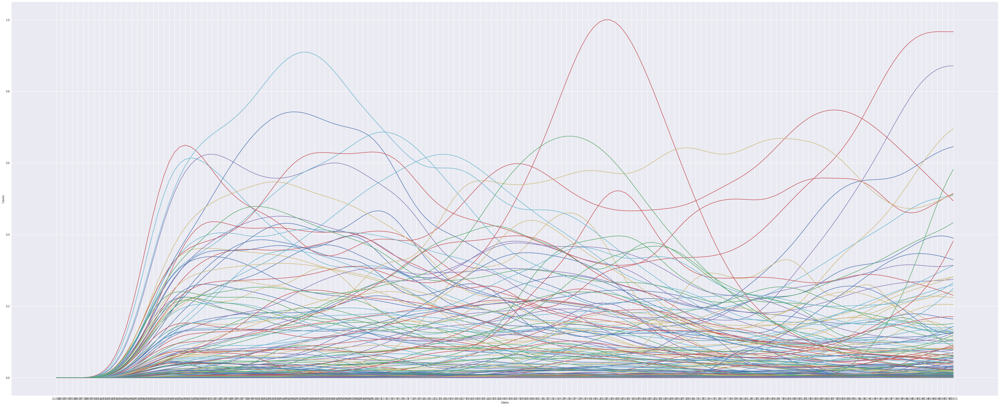

In [49]:
get_graphs(scaled_deaths, areas=scaled_deaths['area'])

In [50]:
scaled_deaths.shape

(140, 175)

## Removing Outlier Deaths

In [51]:
scaled_deaths = scaled_deaths[~scaled_deaths['area'].isin(df_outliers['area'])]
scaled_deaths.head()

,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.000001,0.000006,0.000020,0.000049,0.000102,0.000189,0.000324,0.000517,0.000776,0.001105,0.001503,0.001966,0.002485,0.003044,0.003628,0.004224,0.004818,0.005399,0.005959,0.006491,0.006993,0.007462,0.007897,0.008300,0.008674,0.009027,0.009362,0.009689,...,0.001257,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.000037,0.000182,0.000537,0.001244,0.002485,0.004485,0.007515,0.011736,0.017233,0.024000,0.031929,0.040787,0.050216,0.059734,0.068972,0.077609,0.085411,0.092260,0.098191,0.103387,0.108161,0.112789,0.117554,0.122692,0.128329,0.134451,0.140932,0.147548,...,0.230730,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.000004,0.000019,0.000056,0.000134,0.000273,0.000499,0.000845,0.001333,0.001976,0.002773,0.003713,0.004767,0.005895,0.007041,0.008154,0.009194,0.010127,0.010937,0.011616,0.012174,0.012631,0.013013,0.013340,0.013635,0.013911,0.014182,0.014456,0.014731,...,0.002854,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0.0,0.0,0.0,0.0,0.0,0.0,0.000117,0.000587,0.001761,0.004096,0.008148,0.014574,0.024126,0.037185,0.053746,0.073440,0.095570,0.119128,0.142794,0.164952,0.184379,0.200277,0.212237,0.220169,0.224290,0.225140,0.223554,0.220235,0.215730,0.210474,0.204864,0.199238,0.193843,0.188849,...,0.106465,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,0.0,0.0,0.0,0.0,0.0,0.0,0.000146,0.000731,0.002194,0.005120,0.010239,0.018425,0.030696,0.047646,0.069426,0.095773,0.125984,0.158937,0.193082,0.226443,0.257444,0.284923,0.308091,0.326582,0.340424,0.350052,0.356303,0.359920,0.361552,0.361793,0.361125,0.359920,0.358425,0.356796,...,0.045710,0.047092,0.048440,0.049711,0.050879,0.051939,0.052911,0.053824,0.054738,0.055771,0.057050,0.058735,0.061003,0.064048,0.068109

In [52]:
# Remove the ones without a population
scaled_deaths = scaled_deaths.merge(df_daily_confirmed[df_daily_confirmed.columns[:2]], 
                                    how='inner', 
                                    on=['Country/Region', 'Province/State'])
scaled_deaths.head()

,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.000001,0.000006,0.000020,0.000049,0.000102,0.000189,0.000324,0.000517,0.000776,0.001105,0.001503,0.001966,0.002485,0.003044,0.003628,0.004224,0.004818,0.005399,0.005959,0.006491,0.006993,0.007462,0.007897,0.008300,0.008674,0.009027,0.009362,0.009689,...,0.001257,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.000037,0.000182,0.000537,0.001244,0.002485,0.004485,0.007515,0.011736,0.017233,0.024000,0.031929,0.040787,0.050216,0.059734,0.068972,0.077609,0.085411,0.092260,0.098191,0.103387,0.108161,0.112789,0.117554,0.122692,0.128329,0.134451,0.140932,0.147548,...,0.230730,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.000004,0.000019,0.000056,0.000134,0.000273,0.000499,0.000845,0.001333,0.001976,0.002773,0.003713,0.004767,0.005895,0.007041,0.008154,0.009194,0.010127,0.010937,0.011616,0.012174,0.012631,0.013013,0.013340,0.013635,0.013911,0.014182,0.014456,0.014731,...,0.002854,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0.0,0.0,0.0,0.0,0.0,0.0,0.000117,0.000587,0.001761,0.004096,0.008148,0.014574,0.024126,0.037185,0.053746,0.073440,0.095570,0.119128,0.142794,0.164952,0.184379,0.200277,0.212237,0.220169,0.224290,0.225140,0.223554,0.220235,0.215730,0.210474,0.204864,0.199238,0.193843,0.188849,...,0.106465,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,0.0,0.0,0.0,0.0,0.0,0.0,0.000146,0.000731,0.002194,0.005120,0.010239,0.018425,0.030696,0.047646,0.069426,0.095773,0.125984,0.158937,0.193082,0.226443,0.257444,0.284923,0.308091,0.326582,0.340424,0.350052,0.356303,0.359920,0.361552,0.361793,0.361125,0.359920,0.358425,0.356796,...,0.045710,0.047092,0.048440,0.049711,0.050879,0.051939,0.052911,0.053824,0.054738,0.055771,0.057050,0.058735,0.061003,0.064048,0.068109

In [53]:
scaled_deaths.shape

(140, 175)

## Saving as CSV

In [54]:
scaled_deaths.to_csv(os.path.join(BASE_DIR, 'data/new_normalized_deaths_6months.csv'))

## Old Method (death rate by previous infections)

###merge the different dataset first to get rid of countries with incomplete data

In [ ]:
scaled_deaths.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/7/21,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.003193,0.003399,0.001391,0.001700,0.002266,0.002472,0.002266,0.002575,0.002421,0.002472,0.001957,0.002163,0.001648,0.001545,0.001391,0.001597,0.001545,0.001648,0.001597,0.001339,0.000979,0.001236,0.001082,0.000773,0.000567,0.000773,0.000412,0.000361,0.000361,0.000361,0.000206,0.000258,0.000361,0.000361,0.000567,0.000567,0.000721,0.000721,0.000670,0.000464
1,no province,Albania,41.15330,20.168300,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001700,0.001906,0.001751,0.001597,0.001545,0.001494,0.001339,0.001442,0.001236,0.001185,0.001288,0.001288,0.001339,0.001339,0.001339,0.001339,0.001494,0.001442,0.001700,0.001854,0.001854,0.002060,0.002215,0.002318,0.002472,0.002781,0.002472,0.002369,0.002524,0.002730,0.002730,0.003193,0.003502,0.003605,0.003605,0.003657,0.003657,0.003657,0.003451,0.003296
2,no province,Algeria,28.03390,1.659600,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001185,0.001339,0.001339,0.001288,0.001339,0.001236,0.001082,0.000979,0.001030,0.000979,0.001030,0.001082,0.001082,0.001133,0.001133,0.001030,0.001082,0.001030,0.000876,0.000927,0.001082,0.001030,0.001082,0.001133,0.001030,0.000876,0.000876,0.000824,0.000824,0.000927,0.000773,0.000824,0.000927,0.001030,0.000876,0.001082,0.000927,0.000876,0.000773,0.000876
3,no province,Andorra,42.50630,1.521800,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000052,0.000052,0.000052,0.000103,0.000155,0.000155,0.000155,0.000309,0.000258,0.000206,0.000206,0.000206,0.000103,0.000103,0.000258,0.000206,0.000258,0.000206,0.000258,0.000206,0.000206,0.000206,0.000206,0.000155,0.000103,0.000155,0.000103,0.000155,0.000206,0.000206,0.000155,0.000155,0.000103,0.000052,0.000000,0.000052,0.000052,0.000052
4,no province,Angola,-11.20270,17.873900,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000309,0.000361,0.000412,0.000309,0.000361,0.000464,0.000464,0.000464,0.000618,0.000567,0.000721,0.000773,0.000876,0.000824,0.000876,0.000824,0.000927,0.000876,0.000876,0.000721,0.000515,0.000361,0.000258,0.000155,0.000206,0.000206,0.000206,0.000309,0.000464,0.000412,0.000464,0.000361,0.000258,0.000258,0.000670,0.000618,0.000773,0.000824,0.000721,0.000309


In [ ]:
#deaths.head()
confi = pd.read_csv(os.path.join(BASE_DIR, 'data/time_series_covid19_confirmed_global.csv'))
reco = pd.read_csv(os.path.join(BASE_DIR, 'data/time_series_covid19_recovered_global.csv'))
confi['Province/State']=confi['Province/State'].fillna("no province")
confi['area']=confi['Province/State']+" "+confi['Country/Region']
cols = confi.columns.tolist()
cols = cols[:4] + cols[-1::] + cols[4:-1]
confi = confi[cols]
reco['Province/State']=reco['Province/State'].fillna("no province")
reco['area']=reco['Province/State']+" "+reco['Country/Region']
cols = reco.columns.tolist()
cols = cols[:4] + cols[-1::] + cols[4:-1]
reco = reco[cols]
deaths['Province/State']=deaths['Province/State'].fillna("no province")
deaths['area']=deaths['Province/State']+" "+deaths['Country/Region']
cols = deaths.columns.tolist()
cols = cols[:4] + cols[-1::] + cols[4:-1]
deaths = deaths[cols]
reco.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,43440.0,43740.0,43948.0,44137.0,44608.0,44850.0,45298.0,45434.0,45465.0,45868.0,46359.0,46554.0,46759.0,46887.0,46912.0,46943.0,47298.0,47365.0,47459.0,47549.0,47583.0,47606.0,47609.0,47679.0,47723.0,47798.0,47982.0,47995.0,48018.0,48027.0,48041.0,48042.0,48109.0,48133.0,48279.0,48390.0,48392.0,48395.0,48433.0,48514.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,36971.0,37327.0,37648.0,37981.0,38421.0,38860.0,39246.0,39625.0,40090.0,40453.0,40870.0,41464.0,41969.0,42426.0,42895.0,43384.0,43890.0,44291.0,44880.0,45383.0,45906.0,46420.0,46927.0,47424.0,47922.0,48377.0,48958.0,49543.0,50219.0,50875.0,51444.0,52128.0,52933.0,53616.0,54362.0,55243.0,55983.0,56764.0,57736.0,58794.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,68802.0,69011.0,69212.0,69403.0,69608.0,69791.0,69992.0,70188.0,70373.0,70554.0,70747.0,70933.0,71127.0,71343.0,71552.0,71755.0,71945.0,72143.0,72336.0,72538.0,72745.0,72956.0,73152.0,73344.0,73530.0,73732.0,73940.0,74136.0,74330.0,74330.0,74692.0,74871.0,75057.0,75243.0,75436.0,75628.0,75816.0,75999.0,76168.0,76330.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,7724.0,7724.0,7724.0,7724.0,7930.0,8070.0,8091.0,8116.0,8116.0,8154.0,8154.0,8349.0,8399.0,8474.0,8537.0,8588.0,8652.0,8724.0,8774.0,8851.0,8942.0,8986.0,9045.0,9093.0,9206.0,9252.0,9313.0,9395.0,9444.0,9492.0,9533.0,9610.0,9674.0,9732.0,9781.0,9833.0,9868.0,9911.0,9965.0,10022.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,12712.0,13205.0,13872.0,14825.0,15512.0,15631.0,16008.0,16120.0,16225.0,16347.0,16677.0,16822.0,16921.0,17176.0,17223.0,17249.0,17266.0,17327.0,17388.0,17602.0,17692.0,17918.0,18015.0,18035.0,18180.0,18232.0,18335.0,18381.0,18431.0,18475.0,18540.0,18596.0,18623.0,18687.0,18710.0,18786.0,18790.0,18795.0,18884.0,18929.0


In [ ]:
confi.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,...,53332,53400,53489,53538,53584,53584,53775,53831,53938,53984,54062,54141,54278,54403,54483,54559,54595,54672,54750,54854,54891,54939,55008,55023,55059,55121,55174,55231,55265,55330,55335,55359,55384,55402,55420,55445,55473,55492,55514,55518
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,62378,63033,63595,63971,64627,65334,65994,66635,67216,67690,67982,68568,69238,69916,70655,71441,72274,72812,73691,74567,75454,76350,77251,78127,78992,79934,80941,81993,83082,84212,85336,86289,87528,88671,89776,90835,91987,93075,93850,94651
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,...,101657,101913,102144,102369,102641,102860,103127,103381,103611,103833,104092,104341,104606,104852,105124,105369,105596,105854,106097,106359,106610,106887,107122,107339,107578,107841,108116,108381,108629,108629,109088,109313,109559,109782,110049,110303,110513,110711,110894,111069
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,8489,8586,8586,8586,8682,8818,8868,8946,9038,9083,9083,9194,9308,9379,9416,9499,9549,9596,9638,9716,9779,9837,9885,9937,9972,10017,10070,10137,10172,10206,10251,10275,10312,10352,10391,10427,10463,10503,10538,10555
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,18066,18156,18193,18254,18343,18425,18613,18679,18765,18875,18926,19011,19093,19177,19269,19367,19399,19476,19553,19580,19672,19723,19782,19796,19829,19900,19937,19996,20030,20062,20086,20112,20163,20210,20261,20294,20329,20366,20381,20389


In [ ]:
active_deaths = pd.merge(scaled_deaths, 'Country)

In [ ]:
active_cases = deaths.copy()
active_cases=pd.merge(active_cases, confi[confi.columns[4:]], on='area')
active_cases=pd.merge(active_cases, reco[confi.columns[4:]], on='area')
active_cases.shape

NameError: ignored

In [ ]:
active_cases.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20_x,1/23/20_x,1/24/20_x,1/25/20_x,1/26/20_x,1/27/20_x,1/28/20_x,1/29/20_x,1/30/20_x,1/31/20_x,2/1/20_x,2/2/20_x,2/3/20_x,2/4/20_x,2/5/20_x,2/6/20_x,2/7/20_x,2/8/20_x,2/9/20_x,2/10/20_x,2/11/20_x,2/12/20_x,2/13/20_x,2/14/20_x,2/15/20_x,2/16/20_x,2/17/20_x,2/18/20_x,2/19/20_x,2/20/20_x,2/21/20_x,2/22/20_x,2/23/20_x,2/24/20_x,2/25/20_x,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,43440.0,43740.0,43948.0,44137.0,44608.0,44850.0,45298.0,45434.0,45465.0,45868.0,46359.0,46554.0,46759.0,46887.0,46912.0,46943.0,47298.0,47365.0,47459.0,47549.0,47583.0,47606.0,47609.0,47679.0,47723.0,47798.0,47982.0,47995.0,48018.0,48027.0,48041.0,48042.0,48109.0,48133.0,48279.0,48390.0,48392.0,48395.0,48433.0,48514.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,36971.0,37327.0,37648.0,37981.0,38421.0,38860.0,39246.0,39625.0,40090.0,40453.0,40870.0,41464.0,41969.0,42426.0,42895.0,43384.0,43890.0,44291.0,44880.0,45383.0,45906.0,46420.0,46927.0,47424.0,47922.0,48377.0,48958.0,49543.0,50219.0,50875.0,51444.0,52128.0,52933.0,53616.0,54362.0,55243.0,55983.0,56764.0,57736.0,58794.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,68802.0,69011.0,69212.0,69403.0,69608.0,69791.0,69992.0,70188.0,70373.0,70554.0,70747.0,70933.0,71127.0,71343.0,71552.0,71755.0,71945.0,72143.0,72336.0,72538.0,72745.0,72956.0,73152.0,73344.0,73530.0,73732.0,73940.0,74136.0,74330.0,74330.0,74692.0,74871.0,75057.0,75243.0,75436.0,75628.0,75816.0,75999.0,76168.0,76330.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,7724.0,7724.0,7724.0,7724.0,7930.0,8070.0,8091.0,8116.0,8116.0,8154.0,8154.0,8349.0,8399.0,8474.0,8537.0,8588.0,8652.0,8724.0,8774.0,8851.0,8942.0,8986.0,9045.0,9093.0,9206.0,9252.0,9313.0,9395.0,9444.0,9492.0,9533.0,9610.0,9674.0,9732.0,9781.0,9833.0,9868.0,9911.0,9965.0,10022.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,12712.0,13205.0,13872.0,14825.0,15512.0,15631.0,16008.0,16120.0,16225.0,16347.0,16677.0,16822.0,16921.0,17176.0,17223.0,17249.0,17266.0,17327.0,17388.0,17602.0,17692.0,17918.0,18015.0,18035.0,18180.0,18232.0,18335.0,18381.0,18431.0,18475.0,18540.0,18596.0,18623.0,18687.0,18710.0,18786.0,18790.0,18795.0,18884.0,18929.0


In [ ]:
dates_length=392
info_length=5

In [ ]:
active_cases[active_cases.columns[5:info_length+dates_length]].head()

,1/22/20_x,1/23/20_x,1/24/20_x,1/25/20_x,1/26/20_x,1/27/20_x,1/28/20_x,1/29/20_x,1/30/20_x,1/31/20_x,2/1/20_x,2/2/20_x,2/3/20_x,2/4/20_x,2/5/20_x,2/6/20_x,2/7/20_x,2/8/20_x,2/9/20_x,2/10/20_x,2/11/20_x,2/12/20_x,2/13/20_x,2/14/20_x,2/15/20_x,2/16/20_x,2/17/20_x,2/18/20_x,2/19/20_x,2/20/20_x,2/21/20_x,2/22/20_x,2/23/20_x,2/24/20_x,2/25/20_x,2/26/20_x,2/27/20_x,2/28/20_x,2/29/20_x,3/1/20_x,...,1/8/21_x,1/9/21_x,1/10/21_x,1/11/21_x,1/12/21_x,1/13/21_x,1/14/21_x,1/15/21_x,1/16/21_x,1/17/21_x,1/18/21_x,1/19/21_x,1/20/21_x,1/21/21_x,1/22/21_x,1/23/21_x,1/24/21_x,1/25/21_x,1/26/21_x,1/27/21_x,1/28/21_x,1/29/21_x,1/30/21_x,1/31/21_x,2/1/21_x,2/2/21_x,2/3/21_x,2/4/21_x,2/5/21_x,2/6/21_x,2/7/21_x,2/8/21_x,2/9/21_x,2/10/21_x,2/11/21_x,2/12/21_x,2/13/21_x,2/14/21_x,2/15/21_x,2/16/21_x
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2257,2264,2277,2288,2301,2301,2314,2324,2336,2339,2343,2346,2354,2363,2370,2373,2378,2385,2389,2389,2397,2399,2400,2400,2404,2405,2406,2407,2407,2408,2410,2413,2414,2418,2419,2424,2427,2427,2427,2428
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1230,1233,1241,1247,1252,1256,1261,1265,1270,1277,1281,1287,1291,1296,1303,1310,1315,1324,1332,1339,1350,1358,1369,1380,1393,1398,1404,1418,1433,1446,1460,1472,1488,1503,1517,1531,1543,1555,1567,1582
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2798,2803,2807,2812,2816,2819,2822,2827,2831,2836,2840,2843,2849,2853,2856,2861,2863,2866,2871,2877,2881,2884,2888,2891,2894,2898,2900,2904,2909,2909,2914,2918,2924,2926,2930,2932,2935,2939,2943,2945
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,84,85,85,85,86,87,88,88,91,91,91,92,92,93,93,96,96,97,97,98,100,100,101,101,101,102,103,103,104,105,106,106,106,106,106,106,107,107,107,107
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,415,416,416,420,422,424,425,428,431,436,439,442,444,448,452,457,459,461,462,462,464,464,464,466,466,468,470,473,474,475,475,475,478,487,487,490,491,492,493,494


###Get active cases

In [ ]:
for i in (1, len(columns[4:])-1):
    active_cases[active_cases.columns[i+info_length]]=active_cases[active_cases.columns[i+info_length+dates_length]]-active_cases[active_cases.columns[i+info_length-1]]-active_cases[active_cases.columns[i+info_length+dates_length+dates_length-1]]
active_cases.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20_x,1/23/20_x,1/24/20_x,1/25/20_x,1/26/20_x,1/27/20_x,1/28/20_x,1/29/20_x,1/30/20_x,1/31/20_x,2/1/20_x,2/2/20_x,2/3/20_x,2/4/20_x,2/5/20_x,2/6/20_x,2/7/20_x,2/8/20_x,2/9/20_x,2/10/20_x,2/11/20_x,2/12/20_x,2/13/20_x,2/14/20_x,2/15/20_x,2/16/20_x,2/17/20_x,2/18/20_x,2/19/20_x,2/20/20_x,2/21/20_x,2/22/20_x,2/23/20_x,2/24/20_x,2/25/20_x,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,43440.0,43740.0,43948.0,44137.0,44608.0,44850.0,45298.0,45434.0,45465.0,45868.0,46359.0,46554.0,46759.0,46887.0,46912.0,46943.0,47298.0,47365.0,47459.0,47549.0,47583.0,47606.0,47609.0,47679.0,47723.0,47798.0,47982.0,47995.0,48018.0,48027.0,48041.0,48042.0,48109.0,48133.0,48279.0,48390.0,48392.0,48395.0,48433.0,48514.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,36971.0,37327.0,37648.0,37981.0,38421.0,38860.0,39246.0,39625.0,40090.0,40453.0,40870.0,41464.0,41969.0,42426.0,42895.0,43384.0,43890.0,44291.0,44880.0,45383.0,45906.0,46420.0,46927.0,47424.0,47922.0,48377.0,48958.0,49543.0,50219.0,50875.0,51444.0,52128.0,52933.0,53616.0,54362.0,55243.0,55983.0,56764.0,57736.0,58794.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,68802.0,69011.0,69212.0,69403.0,69608.0,69791.0,69992.0,70188.0,70373.0,70554.0,70747.0,70933.0,71127.0,71343.0,71552.0,71755.0,71945.0,72143.0,72336.0,72538.0,72745.0,72956.0,73152.0,73344.0,73530.0,73732.0,73940.0,74136.0,74330.0,74330.0,74692.0,74871.0,75057.0,75243.0,75436.0,75628.0,75816.0,75999.0,76168.0,76330.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,7724.0,7724.0,7724.0,7724.0,7930.0,8070.0,8091.0,8116.0,8116.0,8154.0,8154.0,8349.0,8399.0,8474.0,8537.0,8588.0,8652.0,8724.0,8774.0,8851.0,8942.0,8986.0,9045.0,9093.0,9206.0,9252.0,9313.0,9395.0,9444.0,9492.0,9533.0,9610.0,9674.0,9732.0,9781.0,9833.0,9868.0,9911.0,9965.0,10022.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,12712.0,13205.0,13872.0,14825.0,15512.0,15631.0,16008.0,16120.0,16225.0,16347.0,16677.0,16822.0,16921.0,17176.0,17223.0,17249.0,17266.0,17327.0,17388.0,17602.0,17692.0,17918.0,18015.0,18035.0,18180.0,18232.0,18335.0,18381.0,18431.0,18475.0,18540.0,18596.0,18623.0,18687.0,18710.0,18786.0,18790.0,18795.0,18884.0,18929.0


In [ ]:
scaled_deaths.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,9.6,8.8,10.0,9.4,9.6,7.6,8.4,6.4,6.0,5.4,6.2,6.0,6.4,6.2,5.2,3.8,4.8,4.2,3.0,2.2,3.0,1.6,1.4,1.4,1.4,0.8,1.0,1.4,1.4,2.2,2.2,2.8,2.8,2.6,1.8,1.8,1.00,0.333333,0.5,1.0
1,no province,Albania,41.15330,20.168300,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.8,5.2,5.6,4.8,4.6,5.0,5.0,5.2,5.2,5.2,5.2,5.8,5.6,6.6,7.2,7.2,8.0,8.6,9.0,9.6,10.8,9.6,9.2,9.8,10.6,10.6,12.4,13.6,14.0,14.0,14.2,14.2,14.2,13.4,12.8,13.0,12.75,13.000000,13.5,15.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.8,4.2,3.8,4.0,3.8,4.0,4.2,4.2,4.4,4.4,4.0,4.2,4.0,3.4,3.6,4.2,4.0,4.2,4.4,4.0,3.4,3.4,3.2,3.2,3.6,3.0,3.2,3.6,4.0,3.4,4.2,3.6,3.4,3.0,3.4,3.0,3.25,3.333333,3.0,2.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.4,0.6,0.6,0.6,1.2,1.0,0.8,0.8,0.8,0.4,0.4,1.0,0.8,1.0,0.8,1.0,0.8,0.8,0.8,0.8,0.6,0.4,0.6,0.4,0.6,0.8,0.8,0.6,0.6,0.4,0.2,0.0,0.2,0.2,0.2,0.2,0.25,0.000000,0.0,0.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.8,1.8,1.8,2.4,2.2,2.8,3.0,3.4,3.2,3.4,3.2,3.6,3.4,3.4,2.8,2.0,1.4,1.0,0.6,0.8,0.8,0.8,1.2,1.8,1.6,1.8,1.4,1.0,1.0,2.6,2.4,3.0,3.2,2.8,1.2,1.4,1.00,1.000000,1.0,1.0


In [ ]:
death_rate=pd.merge(active_cases[active_cases.columns[:info_length+dates_length]], scaled_deaths[scaled_deaths.columns[4:]], on='area')

In [ ]:
death_rate.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20_x,1/23/20_x,1/24/20_x,1/25/20_x,1/26/20_x,1/27/20_x,1/28/20_x,1/29/20_x,1/30/20_x,1/31/20_x,2/1/20_x,2/2/20_x,2/3/20_x,2/4/20_x,2/5/20_x,2/6/20_x,2/7/20_x,2/8/20_x,2/9/20_x,2/10/20_x,2/11/20_x,2/12/20_x,2/13/20_x,2/14/20_x,2/15/20_x,2/16/20_x,2/17/20_x,2/18/20_x,2/19/20_x,2/20/20_x,2/21/20_x,2/22/20_x,2/23/20_x,2/24/20_x,2/25/20_x,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,9.6,8.8,10.0,9.4,9.6,7.6,8.4,6.4,6.0,5.4,6.2,6.0,6.4,6.2,5.2,3.8,4.8,4.2,3.0,2.2,3.0,1.6,1.4,1.4,1.4,0.8,1.0,1.4,1.4,2.2,2.2,2.8,2.8,2.6,1.8,1.8,1.00,0.333333,0.5,1.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,5.8,5.2,5.6,4.8,4.6,5.0,5.0,5.2,5.2,5.2,5.2,5.8,5.6,6.6,7.2,7.2,8.0,8.6,9.0,9.6,10.8,9.6,9.2,9.8,10.6,10.6,12.4,13.6,14.0,14.0,14.2,14.2,14.2,13.4,12.8,13.0,12.75,13.000000,13.5,15.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,4.8,4.2,3.8,4.0,3.8,4.0,4.2,4.2,4.4,4.4,4.0,4.2,4.0,3.4,3.6,4.2,4.0,4.2,4.4,4.0,3.4,3.4,3.2,3.2,3.6,3.0,3.2,3.6,4.0,3.4,4.2,3.6,3.4,3.0,3.4,3.0,3.25,3.333333,3.0,2.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.4,0.6,0.6,0.6,1.2,1.0,0.8,0.8,0.8,0.4,0.4,1.0,0.8,1.0,0.8,1.0,0.8,0.8,0.8,0.8,0.6,0.4,0.6,0.4,0.6,0.8,0.8,0.6,0.6,0.4,0.2,0.0,0.2,0.2,0.2,0.2,0.25,0.000000,0.0,0.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1.8,1.8,1.8,2.4,2.2,2.8,3.0,3.4,3.2,3.4,3.2,3.6,3.4,3.4,2.8,2.0,1.4,1.0,0.6,0.8,0.8,0.8,1.2,1.8,1.6,1.8,1.4,1.0,1.0,2.6,2.4,3.0,3.2,2.8,1.2,1.4,1.00,1.000000,1.0,1.0


In [ ]:
death_rate.shape

(213, 789)

In [ ]:
daily_columns = scaled_deaths.columns[info_length:]
for col in range(0, len(daily_columns)-1):
    death_rate[death_rate.columns[col+info_length+dates_length]] = death_rate[death_rate.columns[col+info_length+dates_length]] / death_rate[death_rate.columns[col+info_length]]
    death_rate[death_rate.columns[col+info_length+dates_length]].fillna(0)

death_rate[death_rate.columns[info_length+dates_length:]].head()

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.004253,0.003887,0.004392,0.004108,0.004172,0.003303,0.003630,0.002754,0.002568,0.002309,0.002646,0.002558,0.002719,0.002624,0.002194,0.001601,0.002019,0.001761,0.001256,0.000921,0.001252,0.000667,0.000583,0.000583,0.000582,0.000333,0.000416,0.000582,0.000582,0.000914,0.000913,0.001160,0.001160,0.001075,0.000744,0.000743,0.000412,0.000137,0.000206,1.0
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.004715,0.004217,0.004512,0.003849,0.003674,0.003981,0.003965,0.004111,0.004094,0.004072,0.004059,0.004507,0.004338,0.005093,0.005526,0.005496,0.006084,0.006495,0.006757,0.007170,0.008000,0.007069,0.006720,0.007101,0.007609,0.007582,0.008832,0.009591,0.009770,0.009682,0.009726,0.009647,0.009543,0.008916,0.008438,0.008491,0.008263,0.008360,0.008615,15.0
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.001716,0.001498,0.001354,0.001422,0.001349,0.001419,0.001488,0.001486,0.001554,0.001551,0.001408,0.001477,0.001404,0.001192,0.001261,0.001468,0.001397,0.001465,0.001533,0.001390,0.001180,0.001179,0.001108,0.001107,0.001244,0.001035,0.001103,0.001240,0.001375,0.001169,0.001441,0.001234,0.001163,0.001025,0.001160,0.001023,0.001107,0.001134,0.001019,2.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.004762,0.007059,0.007059,0.007059,0.013953,0.011494,0.009091,0.009091,0.008791,0.004396,0.004396,0.010870,0.008696,0.010753,0.008602,0.010417,0.008333,0.008247,0.008247,0.008163,0.006000,0.004000,0.005941,0.003960,0.005941,0.007843,0.007767,0.005825,0.005769,0.003810,0.001887,0.000000,0.001887,0.001887,0.001887,0.001887,0.002336,0.000000,0.000000,0.0
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.004337,0.004327,0.004327,0.005714,0.005213,0.006604,0.007059,0.007944,0.007425,0.007798,0.007289,0.008145,0.007658,0.007589,0.006195,0.004376,0.003050,0.002169,0.001299,0.001732,0.001724,0.001724,0.002586,0.003863,0.003433,0.003846,0.002979,0.002114,0.002110,0.005474,0.005053,0.006316,0.006695,0.005749,0.002464,0.002857,0.002037,0.002033,0.002028,1.0


In [ ]:
pd.set_option('use_inf_as_na', True)
for col in death_rate.columns:
    death_rate[col].replace([np.inf, -np.inf], np.nan)
    death_rate[col].fillna(0, inplace=True)
death_rate[death_rate.columns[info_length+dates_length:]].head()

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004253,0.003887,0.004392,0.004108,0.004172,0.003303,0.003630,0.002754,0.002568,0.002309,0.002646,0.002558,0.002719,0.002624,0.002194,0.001601,0.002019,0.001761,0.001256,0.000921,0.001252,0.000667,0.000583,0.000583,0.000582,0.000333,0.000416,0.000582,0.000582,0.000914,0.000913,0.001160,0.001160,0.001075,0.000744,0.000743,0.000412,0.000137,0.000206,1.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004715,0.004217,0.004512,0.003849,0.003674,0.003981,0.003965,0.004111,0.004094,0.004072,0.004059,0.004507,0.004338,0.005093,0.005526,0.005496,0.006084,0.006495,0.006757,0.007170,0.008000,0.007069,0.006720,0.007101,0.007609,0.007582,0.008832,0.009591,0.009770,0.009682,0.009726,0.009647,0.009543,0.008916,0.008438,0.008491,0.008263,0.008360,0.008615,15.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001716,0.001498,0.001354,0.001422,0.001349,0.001419,0.001488,0.001486,0.001554,0.001551,0.001408,0.001477,0.001404,0.001192,0.001261,0.001468,0.001397,0.001465,0.001533,0.001390,0.001180,0.001179,0.001108,0.001107,0.001244,0.001035,0.001103,0.001240,0.001375,0.001169,0.001441,0.001234,0.001163,0.001025,0.001160,0.001023,0.001107,0.001134,0.001019,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004762,0.007059,0.007059,0.007059,0.013953,0.011494,0.009091,0.009091,0.008791,0.004396,0.004396,0.010870,0.008696,0.010753,0.008602,0.010417,0.008333,0.008247,0.008247,0.008163,0.006000,0.004000,0.005941,0.003960,0.005941,0.007843,0.007767,0.005825,0.005769,0.003810,0.001887,0.000000,0.001887,0.001887,0.001887,0.001887,0.002336,0.000000,0.000000,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004337,0.004327,0.004327,0.005714,0.005213,0.006604,0.007059,0.007944,0.007425,0.007798,0.007289,0.008145,0.007658,0.007589,0.006195,0.004376,0.003050,0.002169,0.001299,0.001732,0.001724,0.001724,0.002586,0.003863,0.003433,0.003846,0.002979,0.002114,0.002110,0.005474,0.005053,0.006316,0.006695,0.005749,0.002464,0.002857,0.002037,0.002033,0.002028,1.0


In [ ]:
peak2 = death_rate[death_rate.columns[info_length+dates_length:-1]].to_numpy().max()
peak2

3.0

###Filter out countries with faulty data with death rate higher than 1

In [ ]:
filtered_dr=death_rate.copy()
for cols in filtered_dr.columns[info_length+dates_length:-1]:
    filtered_dr=filtered_dr[filtered_dr[cols]<5]
filtered_dr[filtered_dr.columns[info_length+dates_length:-1]].shape

(213, 391)

In [ ]:
peak2 = filtered_dr[filtered_dr.columns[info_length+dates_length:-1]].to_numpy().max()
peak2

3.0

In [ ]:
for col in filtered_dr.columns[info_length+dates_length:-1]:
  filtered_dr[col] = filtered_dr[col] / peak2

filtered_dr.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20_x,1/23/20_x,1/24/20_x,1/25/20_x,1/26/20_x,1/27/20_x,1/28/20_x,1/29/20_x,1/30/20_x,1/31/20_x,2/1/20_x,2/2/20_x,2/3/20_x,2/4/20_x,2/5/20_x,2/6/20_x,2/7/20_x,2/8/20_x,2/9/20_x,2/10/20_x,2/11/20_x,2/12/20_x,2/13/20_x,2/14/20_x,2/15/20_x,2/16/20_x,2/17/20_x,2/18/20_x,2/19/20_x,2/20/20_x,2/21/20_x,2/22/20_x,2/23/20_x,2/24/20_x,2/25/20_x,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.001418,0.001296,0.001464,0.001369,0.001391,0.001101,0.001210,0.000918,0.000856,0.000770,0.000882,0.000853,0.000906,0.000875,0.000731,0.000534,0.000673,0.000587,0.000419,0.000307,0.000417,0.000222,0.000194,0.000194,0.000194,0.000111,0.000139,0.000194,0.000194,0.000305,0.000304,0.000387,0.000387,0.000358,0.000248,0.000248,0.000137,0.000046,0.000069,1.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.001572,0.001406,0.001504,0.001283,0.001225,0.001327,0.001322,0.001370,0.001365,0.001357,0.001353,0.001502,0.001446,0.001698,0.001842,0.001832,0.002028,0.002165,0.002252,0.002390,0.002667,0.002356,0.002240,0.002367,0.002536,0.002527,0.002944,0.003197,0.003257,0.003227,0.003242,0.003216,0.003181,0.002972,0.002813,0.002830,0.002754,0.002787,0.002872,15.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.000572,0.000499,0.000451,0.000474,0.000450,0.000473,0.000496,0.000495,0.000518,0.000517,0.000469,0.000492,0.000468,0.000397,0.000420,0.000489,0.000466,0.000488,0.000511,0.000463,0.000393,0.000393,0.000369,0.000369,0.000415,0.000345,0.000368,0.000413,0.000458,0.000390,0.000480,0.000411,0.000388,0.000342,0.000387,0.000341,0.000369,0.000378,0.000340,2.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.001587,0.002353,0.002353,0.002353,0.004651,0.003831,0.003030,0.003030,0.002930,0.001465,0.001465,0.003623,0.002899,0.003584,0.002867,0.003472,0.002778,0.002749,0.002749,0.002721,0.002000,0.001333,0.001980,0.001320,0.001980,0.002614,0.002589,0.001942,0.001923,0.001270,0.000629,0.000000,0.000629,0.000629,0.000629,0.000629,0.000779,0.000000,0.000000,0.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.001446,0.001442,0.001442,0.001905,0.001738,0.002201,0.002353,0.002648,0.002475,0.002599,0.002430,0.002715,0.002553,0.002530,0.002065,0.001459,0.001017,0.000723,0.000433,0.000577,0.000575,0.000575,0.000862,0.001288,0.001144,0.001282,0.000993,0.000705,0.000703,0.001825,0.001684,0.002105,0.002232,0.001916,0.000821,0.000952,0.000679,0.000678,0.000676,1.0


In [ ]:
peak2 = filtered_dr[filtered_dr.columns[info_length+dates_length:-1]].to_numpy().max()
peak2

1.0

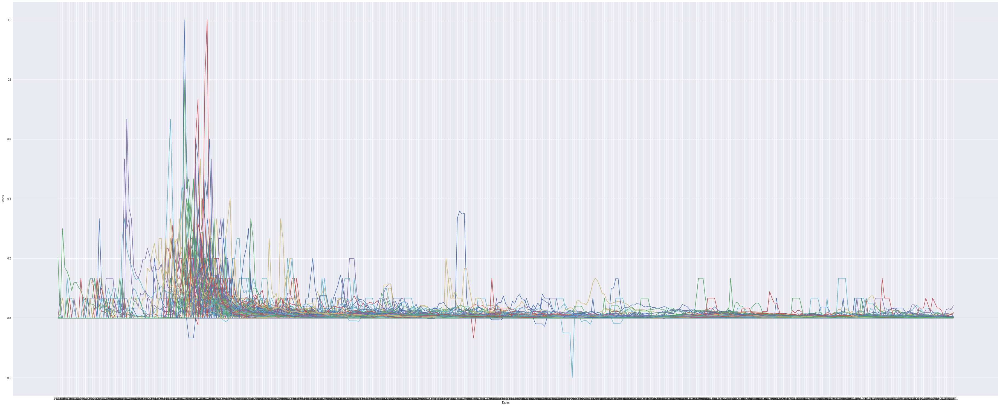

In [ ]:
filtered_dr = filtered_dr[~filtered_dr.area.str.contains("Diamond Princess")]
get_graphs(filtered_dr[filtered_dr.columns[:-1]], areas=filtered_dr['area'], startc=info_length+dates_length)

In [ ]:
df=filtered_dr.copy()
df=df.iloc[:, list(range(info_length)) + list(range(-dates_length,-1))]
df.shape

(212, 396)

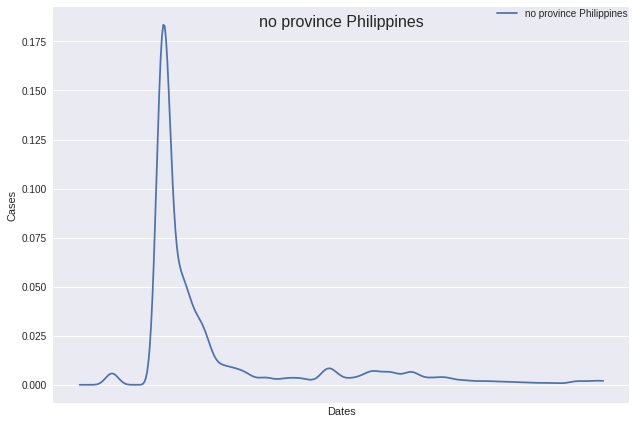

In [ ]:
smoothen_scaled_deaths = Moving_Ave_Stack(df, 7, 5)
get_graph(smoothen_scaled_deaths, country='Philippines')

In [ ]:
smoothen_scaled_deaths.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/7/21,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001877,0.001772,0.001669,0.001575,0.001494,0.001429,0.001383,0.001353,0.001338,0.001334,0.001336,0.001340,0.001344,0.001343,0.001337,0.001325,0.001306,0.001281,0.001251,0.001216,0.001176,0.001133,0.001087,0.001040,0.000991,0.000941,0.000891,0.000841,0.000790,0.000739,0.000687,0.000635,0.000582,0.000530,0.000479,0.000430,0.000385,0.000346,0.000313,0.000286
1,no province,Albania,41.15330,20.168300,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.002678,0.002537,0.002401,0.002275,0.002160,0.002058,0.001971,0.001898,0.001840,0.001794,0.001757,0.001726,0.001697,0.001668,0.001638,0.001604,0.001569,0.001533,0.001500,0.001470,0.001448,0.001436,0.001433,0.001443,0.001466,0.001500,0.001547,0.001604,0.001671,0.001745,0.001826,0.001909,0.001995,0.002081,0.002167,0.002251,0.002335,0.002418,0.002499,0.002580
2,no province,Algeria,28.03390,1.659600,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001025,0.000985,0.000944,0.000902,0.000860,0.000819,0.000780,0.000744,0.000711,0.000681,0.000655,0.000632,0.000611,0.000593,0.000577,0.000562,0.000548,0.000536,0.000525,0.000515,0.000507,0.000500,0.000494,0.000488,0.000484,0.000480,0.000477,0.000473,0.000470,0.000466,0.000461,0.000457,0.000451,0.000446,0.000439,0.000433,0.000426,0.000420,0.000415,0.000410
3,no province,Andorra,42.50630,1.521800,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001195,0.001091,0.000980,0.000867,0.000760,0.000666,0.000590,0.000539,0.000519,0.000535,0.000590,0.000687,0.000826,0.001001,0.001206,0.001432,0.001667,0.001899,0.002116,0.002309,0.002471,0.002599,0.002694,0.002760,0.002802,0.002824,0.002833,0.002830,0.002818,0.002795,0.002761,0.002714,0.002654,0.002582,0.002500,0.002410,0.002315,0.002217,0.002116,0.002014
4,no province,Angola,-11.20270,17.873900,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001454,0.001376,0.001304,0.001238,0.001181,0.001132,0.001094,0.001069,0.001057,0.001060,0.001078,0.001112,0.001160,0.001222,0.001296,0.001382,0.001478,0.001581,0.001690,0.001799,0.001904,0.001999,0.002080,0.002138,0.002170,0.002171,0.002139,0.002074,0.001979,0.001860,0.001725,0.001582,0.001440,0.001310,0.001198,0.001110,0.001049,0.001016,0.001010,0.001026


In [ ]:
peak2 = smoothen_scaled_deaths[smoothen_scaled_deaths.columns[5:]].to_numpy().max()
peak2

0.2378602456382177

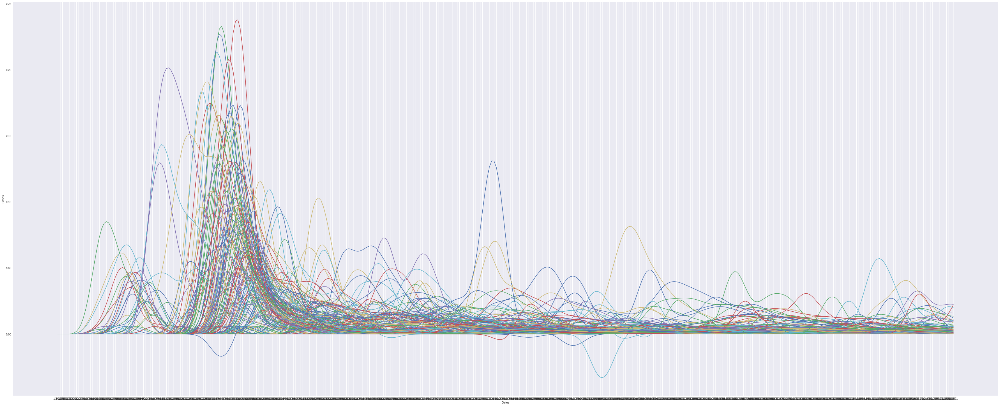

In [ ]:
get_graphs(smoothen_scaled_deaths, areas=smoothen_scaled_deaths['area'])

# Recoveries

In [ ]:
file_path = os.path.join(BASE_DIR, 'data/time_series_covid19_recovered_global.csv')
recovered = pd.read_csv(file_path)
recovered.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,43440.0,43740.0,43948.0,44137.0,44608.0,44850.0,45298.0,45434.0,45465.0,45868.0,46359.0,46554.0,46759.0,46887.0,46912.0,46943.0,47298.0,47365.0,47459.0,47549.0,47583.0,47606.0,47609.0,47679.0,47723.0,47798.0,47982.0,47995.0,48018.0,48027.0,48041.0,48042.0,48109.0,48133.0,48279.0,48390.0,48392.0,48395.0,48433.0,48514.0
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,36971.0,37327.0,37648.0,37981.0,38421.0,38860.0,39246.0,39625.0,40090.0,40453.0,40870.0,41464.0,41969.0,42426.0,42895.0,43384.0,43890.0,44291.0,44880.0,45383.0,45906.0,46420.0,46927.0,47424.0,47922.0,48377.0,48958.0,49543.0,50219.0,50875.0,51444.0,52128.0,52933.0,53616.0,54362.0,55243.0,55983.0,56764.0,57736.0,58794.0
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,68802.0,69011.0,69212.0,69403.0,69608.0,69791.0,69992.0,70188.0,70373.0,70554.0,70747.0,70933.0,71127.0,71343.0,71552.0,71755.0,71945.0,72143.0,72336.0,72538.0,72745.0,72956.0,73152.0,73344.0,73530.0,73732.0,73940.0,74136.0,74330.0,74330.0,74692.0,74871.0,75057.0,75243.0,75436.0,75628.0,75816.0,75999.0,76168.0,76330.0
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,7724.0,7724.0,7724.0,7724.0,7930.0,8070.0,8091.0,8116.0,8116.0,8154.0,8154.0,8349.0,8399.0,8474.0,8537.0,8588.0,8652.0,8724.0,8774.0,8851.0,8942.0,8986.0,9045.0,9093.0,9206.0,9252.0,9313.0,9395.0,9444.0,9492.0,9533.0,9610.0,9674.0,9732.0,9781.0,9833.0,9868.0,9911.0,9965.0,10022.0
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,12712.0,13205.0,13872.0,14825.0,15512.0,15631.0,16008.0,16120.0,16225.0,16347.0,16677.0,16822.0,16921.0,17176.0,17223.0,17249.0,17266.0,17327.0,17388.0,17602.0,17692.0,17918.0,18015.0,18035.0,18180.0,18232.0,18335.0,18381.0,18431.0,18475.0,18540.0,18596.0,18623.0,18687.0,18710.0,18786.0,18790.0,18795.0,18884.0,18929.0


In [ ]:
recovered.shape

(214, 396)

In [ ]:
# Combine province/state and country into one column
recovered['Province/State']=recovered['Province/State'].fillna("no province")
recovered['area']=recovered['Province/State']+" "+recovered['Country/Region']
recovered.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21,area
0,no province,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,43740.0,43948.0,44137.0,44608.0,44850.0,45298.0,45434.0,45465.0,45868.0,46359.0,46554.0,46759.0,46887.0,46912.0,46943.0,47298.0,47365.0,47459.0,47549.0,47583.0,47606.0,47609.0,47679.0,47723.0,47798.0,47982.0,47995.0,48018.0,48027.0,48041.0,48042.0,48109.0,48133.0,48279.0,48390.0,48392.0,48395.0,48433.0,48514.0,no province Afghanistan
1,no province,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,37327.0,37648.0,37981.0,38421.0,38860.0,39246.0,39625.0,40090.0,40453.0,40870.0,41464.0,41969.0,42426.0,42895.0,43384.0,43890.0,44291.0,44880.0,45383.0,45906.0,46420.0,46927.0,47424.0,47922.0,48377.0,48958.0,49543.0,50219.0,50875.0,51444.0,52128.0,52933.0,53616.0,54362.0,55243.0,55983.0,56764.0,57736.0,58794.0,no province Albania
2,no province,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,69011.0,69212.0,69403.0,69608.0,69791.0,69992.0,70188.0,70373.0,70554.0,70747.0,70933.0,71127.0,71343.0,71552.0,71755.0,71945.0,72143.0,72336.0,72538.0,72745.0,72956.0,73152.0,73344.0,73530.0,73732.0,73940.0,74136.0,74330.0,74330.0,74692.0,74871.0,75057.0,75243.0,75436.0,75628.0,75816.0,75999.0,76168.0,76330.0,no province Algeria
3,no province,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,7724.0,7724.0,7724.0,7930.0,8070.0,8091.0,8116.0,8116.0,8154.0,8154.0,8349.0,8399.0,8474.0,8537.0,8588.0,8652.0,8724.0,8774.0,8851.0,8942.0,8986.0,9045.0,9093.0,9206.0,9252.0,9313.0,9395.0,9444.0,9492.0,9533.0,9610.0,9674.0,9732.0,9781.0,9833.0,9868.0,9911.0,9965.0,10022.0,no province Andorra
4,no province,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,13205.0,13872.0,14825.0,15512.0,15631.0,16008.0,16120.0,16225.0,16347.0,16677.0,16822.0,16921.0,17176.0,17223.0,17249.0,17266.0,17327.0,17388.0,17602.0,17692.0,17918.0,18015.0,18035.0,18180.0,18232.0,18335.0,18381.0,18431.0,18475.0,18540.0,18596.0,18623.0,18687.0,18710.0,18786.0,18790.0,18795.0,18884.0,18929.0,no province Angola


In [ ]:
cols = recovered.columns.tolist()
cols = cols[:4] + cols[-1::] + cols[4:-1]
recovered = recovered[cols]
recovered.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,43440.0,43740.0,43948.0,44137.0,44608.0,44850.0,45298.0,45434.0,45465.0,45868.0,46359.0,46554.0,46759.0,46887.0,46912.0,46943.0,47298.0,47365.0,47459.0,47549.0,47583.0,47606.0,47609.0,47679.0,47723.0,47798.0,47982.0,47995.0,48018.0,48027.0,48041.0,48042.0,48109.0,48133.0,48279.0,48390.0,48392.0,48395.0,48433.0,48514.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,36971.0,37327.0,37648.0,37981.0,38421.0,38860.0,39246.0,39625.0,40090.0,40453.0,40870.0,41464.0,41969.0,42426.0,42895.0,43384.0,43890.0,44291.0,44880.0,45383.0,45906.0,46420.0,46927.0,47424.0,47922.0,48377.0,48958.0,49543.0,50219.0,50875.0,51444.0,52128.0,52933.0,53616.0,54362.0,55243.0,55983.0,56764.0,57736.0,58794.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,68802.0,69011.0,69212.0,69403.0,69608.0,69791.0,69992.0,70188.0,70373.0,70554.0,70747.0,70933.0,71127.0,71343.0,71552.0,71755.0,71945.0,72143.0,72336.0,72538.0,72745.0,72956.0,73152.0,73344.0,73530.0,73732.0,73940.0,74136.0,74330.0,74330.0,74692.0,74871.0,75057.0,75243.0,75436.0,75628.0,75816.0,75999.0,76168.0,76330.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,7724.0,7724.0,7724.0,7724.0,7930.0,8070.0,8091.0,8116.0,8116.0,8154.0,8154.0,8349.0,8399.0,8474.0,8537.0,8588.0,8652.0,8724.0,8774.0,8851.0,8942.0,8986.0,9045.0,9093.0,9206.0,9252.0,9313.0,9395.0,9444.0,9492.0,9533.0,9610.0,9674.0,9732.0,9781.0,9833.0,9868.0,9911.0,9965.0,10022.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,12712.0,13205.0,13872.0,14825.0,15512.0,15631.0,16008.0,16120.0,16225.0,16347.0,16677.0,16822.0,16921.0,17176.0,17223.0,17249.0,17266.0,17327.0,17388.0,17602.0,17692.0,17918.0,18015.0,18035.0,18180.0,18232.0,18335.0,18381.0,18431.0,18475.0,18540.0,18596.0,18623.0,18687.0,18710.0,18786.0,18790.0,18795.0,18884.0,18929.0


In [ ]:
columns = recovered.columns
# Copies the specified columns into a new Dataframe
daily_recovered = recovered.copy()
print(len(columns))

for i in range(6, len(columns)):
    daily = recovered[columns[i]] - recovered[columns[i-1]]
    daily_recovered[columns[i]]=daily

daily_recovered.head()

397


,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,149.0,300.0,208.0,189.0,471.0,242.0,448.0,136.0,31.0,403.0,491.0,195.0,205.0,128.0,25.0,31.0,355.0,67.0,94.0,90.0,34.0,23.0,3.0,70.0,44.0,75.0,184.0,13.0,23.0,9.0,14.0,1.0,67.0,24.0,146.0,111.0,2.0,3.0,38.0,81.0
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,436.0,356.0,321.0,333.0,440.0,439.0,386.0,379.0,465.0,363.0,417.0,594.0,505.0,457.0,469.0,489.0,506.0,401.0,589.0,503.0,523.0,514.0,507.0,497.0,498.0,455.0,581.0,585.0,676.0,656.0,569.0,684.0,805.0,683.0,746.0,881.0,740.0,781.0,972.0,1058.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,213.0,209.0,201.0,191.0,205.0,183.0,201.0,196.0,185.0,181.0,193.0,186.0,194.0,216.0,209.0,203.0,190.0,198.0,193.0,202.0,207.0,211.0,196.0,192.0,186.0,202.0,208.0,196.0,194.0,0.0,362.0,179.0,186.0,186.0,193.0,192.0,188.0,183.0,169.0,162.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,109.0,0.0,0.0,0.0,206.0,140.0,21.0,25.0,0.0,38.0,0.0,195.0,50.0,75.0,63.0,51.0,64.0,72.0,50.0,77.0,91.0,44.0,59.0,48.0,113.0,46.0,61.0,82.0,49.0,48.0,41.0,77.0,64.0,58.0,49.0,52.0,35.0,43.0,54.0,57.0
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,757.0,493.0,667.0,953.0,687.0,119.0,377.0,112.0,105.0,122.0,330.0,145.0,99.0,255.0,47.0,26.0,17.0,61.0,61.0,214.0,90.0,226.0,97.0,20.0,145.0,52.0,103.0,46.0,50.0,44.0,65.0,56.0,27.0,64.0,23.0,76.0,4.0,5.0,89.0,45.0


## Normalize by population

In [ ]:
scaled_recovered=daily_recovered.copy()
#active_cases[active_cases.columns[:info_length+dates_length]].head()
scaled_recovered.shape

(214, 397)

In [ ]:
reco_rate = pd.merge(scaled_recovered, moved_scaled[moved_scaled.columns[4:6]], on='area')
reco_rate.head()

,Province/State,Country/Region,Lat,Long,area,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,...,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21,populations
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,300.0,208.0,189.0,471.0,242.0,448.0,136.0,31.0,403.0,491.0,195.0,205.0,128.0,25.0,31.0,355.0,67.0,94.0,90.0,34.0,23.0,3.0,70.0,44.0,75.0,184.0,13.0,23.0,9.0,14.0,1.0,67.0,24.0,146.0,111.0,2.0,3.0,38.0,81.0,38928346
1,no province,Albania,41.15330,20.168300,no province Albania,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,356.0,321.0,333.0,440.0,439.0,386.0,379.0,465.0,363.0,417.0,594.0,505.0,457.0,469.0,489.0,506.0,401.0,589.0,503.0,523.0,514.0,507.0,497.0,498.0,455.0,581.0,585.0,676.0,656.0,569.0,684.0,805.0,683.0,746.0,881.0,740.0,781.0,972.0,1058.0,2877797
2,no province,Algeria,28.03390,1.659600,no province Algeria,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,209.0,201.0,191.0,205.0,183.0,201.0,196.0,185.0,181.0,193.0,186.0,194.0,216.0,209.0,203.0,190.0,198.0,193.0,202.0,207.0,211.0,196.0,192.0,186.0,202.0,208.0,196.0,194.0,0.0,362.0,179.0,186.0,186.0,193.0,192.0,188.0,183.0,169.0,162.0,43851044
3,no province,Andorra,42.50630,1.521800,no province Andorra,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,206.0,140.0,21.0,25.0,0.0,38.0,0.0,195.0,50.0,75.0,63.0,51.0,64.0,72.0,50.0,77.0,91.0,44.0,59.0,48.0,113.0,46.0,61.0,82.0,49.0,48.0,41.0,77.0,64.0,58.0,49.0,52.0,35.0,43.0,54.0,57.0,77265
4,no province,Angola,-11.20270,17.873900,no province Angola,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,493.0,667.0,953.0,687.0,119.0,377.0,112.0,105.0,122.0,330.0,145.0,99.0,255.0,47.0,26.0,17.0,61.0,61.0,214.0,90.0,226.0,97.0,20.0,145.0,52.0,103.0,46.0,50.0,44.0,65.0,56.0,27.0,64.0,23.0,76.0,4.0,5.0,89.0,45.0,32866272


In [ ]:
cols = reco_rate.columns.tolist()
cols = cols[:5] + cols[-1::] + cols[5:-1]
reco_rate = reco_rate[cols]
reco_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,149.0,300.0,208.0,189.0,471.0,242.0,448.0,136.0,31.0,403.0,491.0,195.0,205.0,128.0,25.0,31.0,355.0,67.0,94.0,90.0,34.0,23.0,3.0,70.0,44.0,75.0,184.0,13.0,23.0,9.0,14.0,1.0,67.0,24.0,146.0,111.0,2.0,3.0,38.0,81.0
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,436.0,356.0,321.0,333.0,440.0,439.0,386.0,379.0,465.0,363.0,417.0,594.0,505.0,457.0,469.0,489.0,506.0,401.0,589.0,503.0,523.0,514.0,507.0,497.0,498.0,455.0,581.0,585.0,676.0,656.0,569.0,684.0,805.0,683.0,746.0,881.0,740.0,781.0,972.0,1058.0
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,213.0,209.0,201.0,191.0,205.0,183.0,201.0,196.0,185.0,181.0,193.0,186.0,194.0,216.0,209.0,203.0,190.0,198.0,193.0,202.0,207.0,211.0,196.0,192.0,186.0,202.0,208.0,196.0,194.0,0.0,362.0,179.0,186.0,186.0,193.0,192.0,188.0,183.0,169.0,162.0
3,no province,Andorra,42.50630,1.521800,no province Andorra,77265,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,109.0,0.0,0.0,0.0,206.0,140.0,21.0,25.0,0.0,38.0,0.0,195.0,50.0,75.0,63.0,51.0,64.0,72.0,50.0,77.0,91.0,44.0,59.0,48.0,113.0,46.0,61.0,82.0,49.0,48.0,41.0,77.0,64.0,58.0,49.0,52.0,35.0,43.0,54.0,57.0
4,no province,Angola,-11.20270,17.873900,no province Angola,32866272,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,757.0,493.0,667.0,953.0,687.0,119.0,377.0,112.0,105.0,122.0,330.0,145.0,99.0,255.0,47.0,26.0,17.0,61.0,61.0,214.0,90.0,226.0,97.0,20.0,145.0,52.0,103.0,46.0,50.0,44.0,65.0,56.0,27.0,64.0,23.0,76.0,4.0,5.0,89.0,45.0


In [ ]:
for col in reco_rate.columns[6:]:
  reco_rate[col]=reco_rate[col]/reco_rate['populations']

reco_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000008,0.000005,0.000005,0.000012,0.000006,0.000012,0.000003,7.963349e-07,0.000010,0.000013,0.000005,0.000005,0.000003,6.422056e-07,7.963349e-07,9.119319e-06,0.000002,0.000002,0.000002,8.733996e-07,5.908291e-07,7.706467e-08,1.798176e-06,0.000001,0.000002,0.000005,3.339469e-07,5.908291e-07,2.311940e-07,3.596351e-07,2.568822e-08,1.721111e-06,6.165173e-07,3.750480e-06,0.000003,5.137644e-08,7.706467e-08,9.761524e-07,0.000002
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000152,0.000124,0.000112,0.000116,0.000153,0.000153,0.000134,0.000132,1.615819e-04,0.000126,0.000145,0.000206,0.000175,0.000159,1.629719e-04,1.699216e-04,1.758289e-04,0.000139,0.000205,0.000175,1.817362e-04,1.786088e-04,1.761764e-04,1.727015e-04,0.000173,0.000158,0.000202,2.032805e-04,2.349019e-04,2.279521e-04,1.977207e-04,2.376818e-04,2.797279e-04,2.373343e-04,2.592261e-04,0.000306,2.571411e-04,2.713881e-04,3.377584e-04,0.000368
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000005,0.000005,0.000005,0.000004,0.000005,0.000004,0.000005,0.000004,4.218828e-06,0.000004,0.000004,0.000004,0.000004,0.000005,4.766135e-06,4.629308e-06,4.332850e-06,0.000005,0.000004,0.000005,4.720526e-06,4.811744e-06,4.469677e-06,4.378459e-06,0.000004,0.000005,0.000005,4.469677e-06,4.424068e-06,0.000000e+00,8.255220e-06,4.082001e-06,4.241632e-06,4.241632e-06,4.401264e-06,0.000004,4.287241e-06,4.173219e-06,3.853956e-06,0.000004
3,no province,Andorra,42.50630,1.521800,no province Andorra,77265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001411,0.000000,0.000000,0.000000,0.002666,0.001812,0.000272,0.000324,0.000000e+00,0.000492,0.000000,0.002524,0.000647,0.000971,8.153757e-04,6.600660e-04,8.283181e-04,0.000932,0.000647,0.000997,1.177765e-03,5.694687e-04,7.636058e-04,6.212386e-04,0.001462,0.000595,0.000789,1.061283e-03,6.341811e-04,6.212386e-04,5.306413e-04,9.965702e-04,8.283181e-04,7.506633e-04,6.341811e-04,0.000673,4.529865e-04,5.565262e-04,6.988934e-04,0.000738
4,no province,Angola,-11.20270,17.873900,no province Angola,32866272,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000023,0.000015,0.000020,0.000029,0.000021,0.000004,0.000011,0.000003,3.194765e-06,0.000004,0.000010,0.000004,0.000003,0.000008,1.430037e-06,7.910846e-07,5.172476e-07,0.000002,0.000002,0.000007,2.738370e-06,6.876350e-06,2.951354e-06,6.085266e-07,0.000004,0.000002,0.000003,1.399611e-06,1.521316e-06,1.338758e-06,1.977711e-06,1.703874e-06,8.215109e-07,1.947285e-06,6.998056e-07,0.000002,1.217053e-07,1.521316e-07,2.707943e-06,0.000001


In [ ]:
pd.set_option('use_inf_as_na', True)
for col in reco_rate.columns:
    reco_rate[col].replace([np.inf, -np.inf], np.nan)
    reco_rate[col].fillna(0, inplace=True)
reco_rate.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,2/16/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000008,0.000005,0.000005,0.000012,0.000006,0.000012,0.000003,7.963349e-07,0.000010,0.000013,0.000005,0.000005,0.000003,6.422056e-07,7.963349e-07,9.119319e-06,0.000002,0.000002,0.000002,8.733996e-07,5.908291e-07,7.706467e-08,1.798176e-06,0.000001,0.000002,0.000005,3.339469e-07,5.908291e-07,2.311940e-07,3.596351e-07,2.568822e-08,1.721111e-06,6.165173e-07,3.750480e-06,0.000003,5.137644e-08,7.706467e-08,9.761524e-07,0.000002
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000152,0.000124,0.000112,0.000116,0.000153,0.000153,0.000134,0.000132,1.615819e-04,0.000126,0.000145,0.000206,0.000175,0.000159,1.629719e-04,1.699216e-04,1.758289e-04,0.000139,0.000205,0.000175,1.817362e-04,1.786088e-04,1.761764e-04,1.727015e-04,0.000173,0.000158,0.000202,2.032805e-04,2.349019e-04,2.279521e-04,1.977207e-04,2.376818e-04,2.797279e-04,2.373343e-04,2.592261e-04,0.000306,2.571411e-04,2.713881e-04,3.377584e-04,0.000368
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000005,0.000005,0.000005,0.000004,0.000005,0.000004,0.000005,0.000004,4.218828e-06,0.000004,0.000004,0.000004,0.000004,0.000005,4.766135e-06,4.629308e-06,4.332850e-06,0.000005,0.000004,0.000005,4.720526e-06,4.811744e-06,4.469677e-06,4.378459e-06,0.000004,0.000005,0.000005,4.469677e-06,4.424068e-06,0.000000e+00,8.255220e-06,4.082001e-06,4.241632e-06,4.241632e-06,4.401264e-06,0.000004,4.287241e-06,4.173219e-06,3.853956e-06,0.000004
3,no province,Andorra,42.50630,1.521800,no province Andorra,77265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001411,0.000000,0.000000,0.000000,0.002666,0.001812,0.000272,0.000324,0.000000e+00,0.000492,0.000000,0.002524,0.000647,0.000971,8.153757e-04,6.600660e-04,8.283181e-04,0.000932,0.000647,0.000997,1.177765e-03,5.694687e-04,7.636058e-04,6.212386e-04,0.001462,0.000595,0.000789,1.061283e-03,6.341811e-04,6.212386e-04,5.306413e-04,9.965702e-04,8.283181e-04,7.506633e-04,6.341811e-04,0.000673,4.529865e-04,5.565262e-04,6.988934e-04,0.000738
4,no province,Angola,-11.20270,17.873900,no province Angola,32866272,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000023,0.000015,0.000020,0.000029,0.000021,0.000004,0.000011,0.000003,3.194765e-06,0.000004,0.000010,0.000004,0.000003,0.000008,1.430037e-06,7.910846e-07,5.172476e-07,0.000002,0.000002,0.000007,2.738370e-06,6.876350e-06,2.951354e-06,6.085266e-07,0.000004,0.000002,0.000003,1.399611e-06,1.521316e-06,1.338758e-06,1.977711e-06,1.703874e-06,8.215109e-07,1.947285e-06,6.998056e-07,0.000002,1.217053e-07,1.521316e-07,2.707943e-06,0.000001


In [ ]:
reco_rate.shape

(177, 398)

In [ ]:
NUM_DAYS = 5
info_length = 6
dates_length = 392
moving_ave_recovered = reco_rate[reco_rate.columns[:info_length+dates_length-1]].copy()
dates = reco_rate.columns[info_length:info_length+dates_length-1]

for idx, date in enumerate(dates):
  seven_days = dates[idx : idx+NUM_DAYS]
  moving_ave_recovered[date] = reco_rate.apply(lambda x: x[seven_days].mean(), axis=1)

moving_ave_recovered.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,1/7/21,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000008,0.000007,0.000007,0.000008,0.000008,0.000007,0.000006,0.000008,0.000006,0.000007,0.000007,0.000005,0.000003,0.000004,0.000003,0.000003,0.000003,0.000003,0.000002,0.000001,0.000001,8.939501e-07,0.000001,0.000002,0.000002,0.000002,0.000002,0.000001,3.082587e-07,5.856915e-07,5.908291e-07,0.000001,0.000002,0.000002,0.000001,0.000002,9.889966e-07,3.681979e-07,5.266086e-07,9.761524e-07
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000131,0.000131,0.000131,0.000133,0.000137,0.000147,0.000141,0.000140,0.000154,0.000163,0.000162,0.000170,0.000175,0.000169,0.000161,0.000171,0.000173,0.000175,0.000176,0.000183,0.000177,1.764544e-04,0.000172,0.000176,0.000182,0.000194,0.000205,0.000213,2.203074e-04,2.355969e-04,2.360834e-04,0.000242,0.000264,0.000268,0.000266,0.000286,2.931062e-04,2.887625e-04,3.045733e-04,3.377584e-04
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000005,0.000005,0.000005,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000005,0.000005,0.000005,0.000005,0.000005,0.000004,0.000005,0.000005,0.000005,0.000005,4.524408e-06,0.000005,0.000004,0.000004,0.000004,0.000004,0.000004,4.246193e-06,4.200584e-06,4.164097e-06,0.000005,0.000004,0.000004,0.000004,0.000004,4.173219e-06,4.104805e-06,4.013587e-06,3.853956e-06
3,no province,Andorra,42.50630,1.521800,no province Andorra,77265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000282,0.000815,0.000896,0.000950,0.001015,0.001015,0.000580,0.000217,0.000668,0.000733,0.000927,0.000991,0.001123,0.000784,0.000841,0.000777,0.000813,0.000916,0.000865,0.000831,0.000826,9.189154e-04,0.000802,0.000846,0.000906,0.000909,0.000740,0.000727,7.687828e-04,7.221899e-04,7.454863e-04,0.000748,0.000777,0.000668,0.000613,0.000603,5.953537e-04,5.694687e-04,6.277098e-04,6.988934e-04
4,no province,Angola,-11.20270,17.873900,no province Angola,32866272,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000020,0.000022,0.000018,0.000017,0.000014,0.000009,0.000005,0.000006,0.000005,0.000005,0.000006,0.000005,0.000003,0.000003,0.000002,0.000001,0.000002,0.000003,0.000004,0.000004,0.000004,3.517284e-06,0.000003,0.000003,0.000002,0.000002,0.000002,0.000002,1.588254e-06,1.472634e-06,1.557828e-06,0.000001,0.000001,0.000001,0.000001,0.000001,1.323545e-06,9.939267e-07,1.430037e-06,2.707943e-06


In [ ]:
moving_ave_recovered.shape

(177, 397)

## Normalize by Peak

In [ ]:
for col in dates:
    moving_ave_recovered[col].replace([np.inf, -np.inf], np.nan)
    moving_ave_recovered[col].fillna(0, inplace=True)
moving_ave_recovered.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,1/7/21,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000008,0.000007,0.000007,0.000008,0.000008,0.000007,0.000006,0.000008,0.000006,0.000007,0.000007,0.000005,0.000003,0.000004,0.000003,0.000003,0.000003,0.000003,0.000002,0.000001,0.000001,8.939501e-07,0.000001,0.000002,0.000002,0.000002,0.000002,0.000001,3.082587e-07,5.856915e-07,5.908291e-07,0.000001,0.000002,0.000002,0.000001,0.000002,9.889966e-07,3.681979e-07,5.266086e-07,9.761524e-07
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000131,0.000131,0.000131,0.000133,0.000137,0.000147,0.000141,0.000140,0.000154,0.000163,0.000162,0.000170,0.000175,0.000169,0.000161,0.000171,0.000173,0.000175,0.000176,0.000183,0.000177,1.764544e-04,0.000172,0.000176,0.000182,0.000194,0.000205,0.000213,2.203074e-04,2.355969e-04,2.360834e-04,0.000242,0.000264,0.000268,0.000266,0.000286,2.931062e-04,2.887625e-04,3.045733e-04,3.377584e-04
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000005,0.000005,0.000005,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000005,0.000005,0.000005,0.000005,0.000005,0.000004,0.000005,0.000005,0.000005,0.000005,4.524408e-06,0.000005,0.000004,0.000004,0.000004,0.000004,0.000004,4.246193e-06,4.200584e-06,4.164097e-06,0.000005,0.000004,0.000004,0.000004,0.000004,4.173219e-06,4.104805e-06,4.013587e-06,3.853956e-06
3,no province,Andorra,42.50630,1.521800,no province Andorra,77265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000282,0.000815,0.000896,0.000950,0.001015,0.001015,0.000580,0.000217,0.000668,0.000733,0.000927,0.000991,0.001123,0.000784,0.000841,0.000777,0.000813,0.000916,0.000865,0.000831,0.000826,9.189154e-04,0.000802,0.000846,0.000906,0.000909,0.000740,0.000727,7.687828e-04,7.221899e-04,7.454863e-04,0.000748,0.000777,0.000668,0.000613,0.000603,5.953537e-04,5.694687e-04,6.277098e-04,6.988934e-04
4,no province,Angola,-11.20270,17.873900,no province Angola,32866272,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000020,0.000022,0.000018,0.000017,0.000014,0.000009,0.000005,0.000006,0.000005,0.000005,0.000006,0.000005,0.000003,0.000003,0.000002,0.000001,0.000002,0.000003,0.000004,0.000004,0.000004,3.517284e-06,0.000003,0.000003,0.000002,0.000002,0.000002,0.000002,1.588254e-06,1.472634e-06,1.557828e-06,0.000001,0.000001,0.000001,0.000001,0.000001,1.323545e-06,9.939267e-07,1.430037e-06,2.707943e-06


In [ ]:
peak3 = moving_ave_recovered[dates].to_numpy().max()
peak3

0.012061013890383773

In [ ]:

for col in dates:
  moving_ave_recovered[col] = moving_ave_recovered[col] / peak3

moving_ave_recovered.head()

,Province/State,Country/Region,Lat,Long,area,populations,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,1/7/21,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000627,0.000561,0.000601,0.000664,0.000633,0.000566,0.000537,0.000643,0.000535,0.000564,0.000606,0.000445,0.000249,0.000317,0.000258,0.000244,0.000271,0.000273,0.000131,0.000104,0.000094,0.000074,0.000092,0.000160,0.000164,0.000144,0.000129,0.000104,0.000026,0.000049,0.000049,0.000107,0.000149,0.000149,0.000122,0.000128,0.000082,0.000031,0.000044,0.000081
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.010827,0.010867,0.010885,0.011058,0.011392,0.012152,0.011709,0.011582,0.012780,0.013507,0.013460,0.014071,0.014486,0.013979,0.013380,0.014140,0.014336,0.014532,0.014578,0.015189,0.014659,0.014630,0.014238,0.014624,0.015074,0.016105,0.017016,0.017673,0.018266,0.019534,0.019574,0.020093,0.021890,0.022213,0.022075,0.023740,0.024302,0.023942,0.025253,0.028004
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000386,0.000385,0.000374,0.000371,0.000369,0.000367,0.000358,0.000362,0.000356,0.000355,0.000367,0.000377,0.000381,0.000383,0.000384,0.000376,0.000373,0.000374,0.000382,0.000382,0.000381,0.000375,0.000373,0.000372,0.000372,0.000373,0.000303,0.000363,0.000352,0.000348,0.000345,0.000418,0.000354,0.000357,0.000356,0.000350,0.000346,0.000340,0.000333,0.000320
3,no province,Andorra,42.50630,1.521800,no province Andorra,77265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.023393,0.067604,0.074257,0.078764,0.084130,0.084130,0.048074,0.018028,0.055371,0.060737,0.076833,0.082198,0.093144,0.065029,0.069750,0.064385,0.067390,0.075974,0.071682,0.068892,0.068463,0.076189,0.066531,0.070180,0.075116,0.075330,0.061380,0.060307,0.063741,0.059878,0.061810,0.062024,0.064385,0.055371,0.050864,0.050006,0.049362,0.047216,0.052045,0.057946
4,no province,Angola,-11.20270,17.873900,no province Angola,32866272,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001689,0.001795,0.001473,0.001414,0.001134,0.000706,0.000421,0.000528,0.000411,0.000404,0.000480,0.000442,0.000289,0.000224,0.000205,0.000107,0.000191,0.000224,0.000329,0.000347,0.000326,0.000292,0.000272,0.000210,0.000185,0.000200,0.000149,0.000155,0.000132,0.000122,0.000129,0.000119,0.000124,0.000098,0.000087,0.000099,0.000110,0.000082,0.000119,0.000225


In [ ]:
moving_ave_recovered[dates].to_numpy().max()

1.0

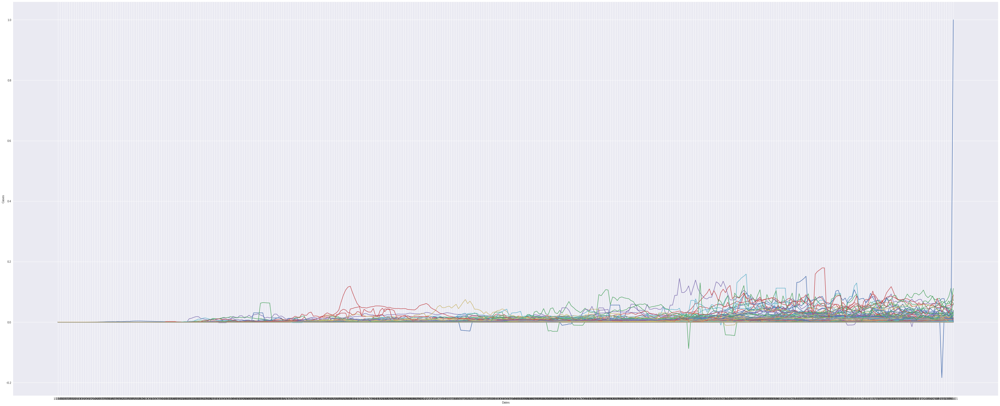

In [ ]:
moving_ave_recovered = moving_ave_recovered[~moving_ave_recovered.area.str.contains("Diamond Princess")]
get_graphs(moving_ave_recovered, areas=scaled_deaths['area'])

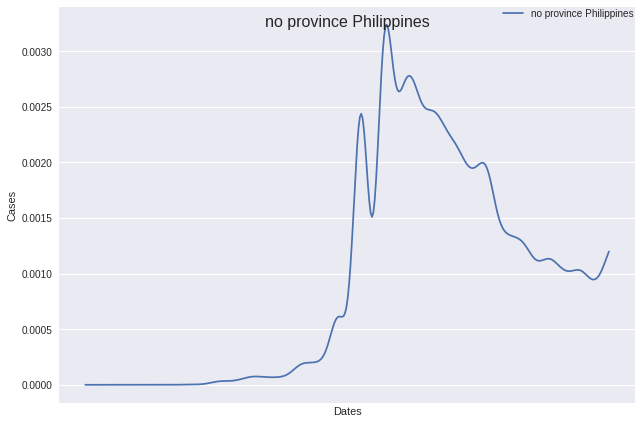

In [ ]:
smoothen_recovered = Moving_Ave_Stack(moving_ave_recovered, 7, 6)
get_graph(smoothen_recovered, country='Philippines')

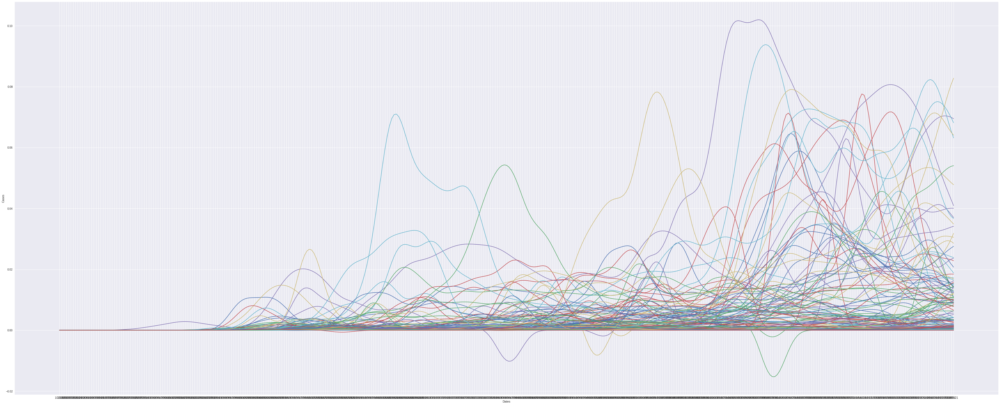

In [ ]:
get_graphs(smoothen_recovered, areas=smoothen_recovered['area'], startc=6)

In [ ]:
peak3 = smoothen_recovered[dates].to_numpy().max()
peak3

0.10198376840597112

In [ ]:
smoothen_scaled_deaths.to_csv(os.path.join(BASE_DIR, 'data/new_normalized_deaths.csv'))

In [ ]:
smoothen_recovered.to_csv(os.path.join(BASE_DIR, 'data/new_normalized_recovered.csv'))

# ADDING SHIFTS

## Load All Datasets

In [55]:
confi = pd.read_csv(os.path.join(BASE_DIR, 'data/new_normalized_confirmed_6months.csv'), index_col=0)
dea = pd.read_csv(os.path.join(BASE_DIR, 'data/new_normalized_deaths_6months.csv'), index_col=0)
# reco = pd.read_csv(os.path.join(BASE_DIR, 'data/new_normalized_recovered.csv'), index_col=0)

dea.head()

,Province/State,Country/Region,Lat,Long,area,populations,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20,11/18/20,11/19/20,11/20/20,11/21/20,11/22/20,11/23/20,11/24/20,11/25/20,11/26/20,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,...,3/10/21,3/11/21,3/12/21,3/13/21,3/14/21,3/15/21,3/16/21,3/17/21,3/18/21,3/19/21,3/20/21,3/21/21,3/22/21,3/23/21,3/24/21,3/25/21,3/26/21,3/27/21,3/28/21,3/29/21,3/30/21,3/31/21,4/1/21,4/2/21,4/3/21,4/4/21,4/5/21,4/6/21,4/7/21,4/8/21,4/9/21,4/10/21,4/11/21,4/12/21,4/13/21,4/14/21,4/15/21,4/16/21,4/17/21,4/18/21
0,no province,Afghanistan,33.93911,67.709953,no province Afghanistan,38928346,0.0,0.0,0.0,0.0,0.0,0.0,0.000001,0.000006,0.000020,0.000049,0.000102,0.000189,0.000324,0.000517,0.000776,0.001105,0.001503,0.001966,0.002485,0.003044,0.003628,0.004224,0.004818,0.005399,0.005959,0.006491,0.006993,0.007462,0.007897,0.008300,0.008674,0.009027,0.009362,0.009689,...,0.001257,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644
1,no province,Albania,41.15330,20.168300,no province Albania,2877797,0.0,0.0,0.0,0.0,0.0,0.0,0.000037,0.000182,0.000537,0.001244,0.002485,0.004485,0.007515,0.011736,0.017233,0.024000,0.031929,0.040787,0.050216,0.059734,0.068972,0.077609,0.085411,0.092260,0.098191,0.103387,0.108161,0.112789,0.117554,0.122692,0.128329,0.134451,0.140932,0.147548,...,0.230730,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009
2,no province,Algeria,28.03390,1.659600,no province Algeria,43851044,0.0,0.0,0.0,0.0,0.0,0.0,0.000004,0.000019,0.000056,0.000134,0.000273,0.000499,0.000845,0.001333,0.001976,0.002773,0.003713,0.004767,0.005895,0.007041,0.008154,0.009194,0.010127,0.010937,0.011616,0.012174,0.012631,0.013013,0.013340,0.013635,0.013911,0.014182,0.014456,0.014731,...,0.002854,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966
3,no province,Argentina,-38.41610,-63.616700,no province Argentina,45195774,0.0,0.0,0.0,0.0,0.0,0.0,0.000117,0.000587,0.001761,0.004096,0.008148,0.014574,0.024126,0.037185,0.053746,0.073440,0.095570,0.119128,0.142794,0.164952,0.184379,0.200277,0.212237,0.220169,0.224290,0.225140,0.223554,0.220235,0.215730,0.210474,0.204864,0.199238,0.193843,0.188849,...,0.106465,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255
4,no province,Armenia,40.06910,45.038200,no province Armenia,2963243,0.0,0.0,0.0,0.0,0.0,0.0,0.000146,0.000731,0.002194,0.005120,0.010239,0.018425,0.030696,0.047646,0.069426,0.095773,0.125984,0.158937,0.193082,0.226443,0.257444,0.284923,0.308091,0.326582,0.340424,0.350052,0.356303,0.359920,0.361552,0.361793,0.361125,0.359920,0.358425,0.356796,...,0.045710,0.047092,0.048440,0.049711,0.050879,0.051939,0.052911,0.053824,0.054738,0.055771,0.057050,0.058735,0.061003,0.064048,0.068109

In [56]:
# Combine all datasets into one

# Deaths
combined = confi.copy()
dea_cols = dea.columns[4:].tolist()
dea_cols = dea_cols[0:1]+dea_cols[2:]
combined = pd.merge(confi, dea[dea_cols], on=['area'])

# Recoveries
# reco_cols = reco.columns[4:].tolist()
# reco_cols = reco_cols[0:1]+reco_cols[2:]
# combined = pd.merge(combined, reco[reco_cols], on=['area'])

print(combined.shape)
combined.head()

(140, 344)


,Province/State,Country/Region,Lat,Long,populations,area,11/1/20_x,11/2/20_x,11/3/20_x,11/4/20_x,11/5/20_x,11/6/20_x,11/7/20_x,11/8/20_x,11/9/20_x,11/10/20_x,11/11/20_x,11/12/20_x,11/13/20_x,11/14/20_x,11/15/20_x,11/16/20_x,11/17/20_x,11/18/20_x,11/19/20_x,11/20/20_x,11/21/20_x,11/22/20_x,11/23/20_x,11/24/20_x,11/25/20_x,11/26/20_x,11/27/20_x,11/28/20_x,11/29/20_x,11/30/20_x,12/1/20_x,12/2/20_x,12/3/20_x,12/4/20_x,...,3/10/21_y,3/11/21_y,3/12/21_y,3/13/21_y,3/14/21_y,3/15/21_y,3/16/21_y,3/17/21_y,3/18/21_y,3/19/21_y,3/20/21_y,3/21/21_y,3/22/21_y,3/23/21_y,3/24/21_y,3/25/21_y,3/26/21_y,3/27/21_y,3/28/21_y,3/29/21_y,3/30/21_y,3/31/21_y,4/1/21_y,4/2/21_y,4/3/21_y,4/4/21_y,4/5/21_y,4/6/21_y,4/7/21_y,4/8/21_y,4/9/21_y,4/10/21_y,4/11/21_y,4/12/21_y,4/13/21_y,4/14/21_y,4/15/21_y,4/16/21_y,4/17/21_y,4/18/21_y
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,5.845237e-07,0.000003,0.000009,0.000020,0.000041,0.000074,0.000123,0.000192,0.000282,0.000392,0.000521,0.000667,0.000825,0.000988,0.001152,0.001314,0.001472,0.001624,0.001771,0.001912,0.002049,0.002183,0.002313,0.002437,0.002555,0.002662,0.002757,0.002838,...,0.001257,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,2.951423e-05,0.000150,0.000455,0.001077,0.002184,0.003987,0.006735,0.010604,0.015683,0.021972,0.029368,0.037661,0.046527,0.055528,0.064289,0.072509,0.079975,0.086579,0.092320,0.097313,0.101777,0.105914,0.109891,0.113821,0.117752,0.121662,0.125465,0.129028,...,0.230730,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,2.245638e-06,0.000011,0.000035,0.000084,0.000171,0.000314,0.000534,0.000846,0.001261,0.001782,0.002404,0.003116,0.003895,0.004710,0.005533,0.006339,0.007109,0.007828,0.008488,0.009091,0.009643,0.010152,0.010625,0.011068,0.011482,0.011871,0.012231,0.012560,...,0.002854,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966
3,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.0,0.0,0.0,0.0,0.0,0.0,5.659997e-05,0.000281,0.000840,0.001951,0.003884,0.006963,0.011562,0.017880,0.025949,0.035636,0.046651,0.058544,0.070710,0.082388,0.092997,0.102127,0.109531,0.115115,0.118937,0.121201,0.122262,0.122397,0.121822,0.120699,0.119149,0.117256,0.115079,0.112649,...,0.106465,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255
4,no province,Armenia,40.06910,45.038200,2963243,no province Armenia,0.0,0.0,0.0,0.0,0.0,0.0,1.689108e-04,0.000844,0.002530,0.005898,0.011781,0.021175,0.035232,0.054578,0.079312,0.108999,0.142673,0.178835,0.215464,0.250027,0.280507,0.305434,0.323894,0.335555,0.340671,0.340089,0.335238,0.327437,0.317864,0.307531,0.2972

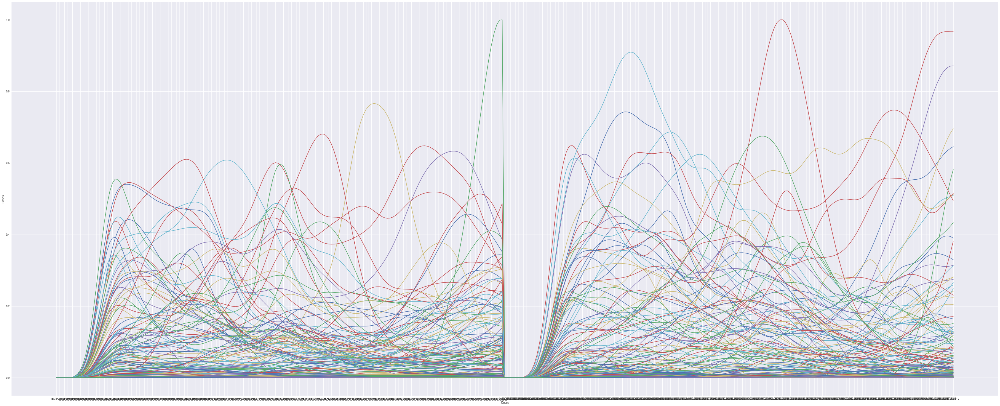

In [57]:
get_graphs(combined, areas = combined['area'])

## Normalize by Peaks

In [58]:
combined.head()

,Province/State,Country/Region,Lat,Long,populations,area,11/1/20_x,11/2/20_x,11/3/20_x,11/4/20_x,11/5/20_x,11/6/20_x,11/7/20_x,11/8/20_x,11/9/20_x,11/10/20_x,11/11/20_x,11/12/20_x,11/13/20_x,11/14/20_x,11/15/20_x,11/16/20_x,11/17/20_x,11/18/20_x,11/19/20_x,11/20/20_x,11/21/20_x,11/22/20_x,11/23/20_x,11/24/20_x,11/25/20_x,11/26/20_x,11/27/20_x,11/28/20_x,11/29/20_x,11/30/20_x,12/1/20_x,12/2/20_x,12/3/20_x,12/4/20_x,...,3/10/21_y,3/11/21_y,3/12/21_y,3/13/21_y,3/14/21_y,3/15/21_y,3/16/21_y,3/17/21_y,3/18/21_y,3/19/21_y,3/20/21_y,3/21/21_y,3/22/21_y,3/23/21_y,3/24/21_y,3/25/21_y,3/26/21_y,3/27/21_y,3/28/21_y,3/29/21_y,3/30/21_y,3/31/21_y,4/1/21_y,4/2/21_y,4/3/21_y,4/4/21_y,4/5/21_y,4/6/21_y,4/7/21_y,4/8/21_y,4/9/21_y,4/10/21_y,4/11/21_y,4/12/21_y,4/13/21_y,4/14/21_y,4/15/21_y,4/16/21_y,4/17/21_y,4/18/21_y
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,5.845237e-07,0.000003,0.000009,0.000020,0.000041,0.000074,0.000123,0.000192,0.000282,0.000392,0.000521,0.000667,0.000825,0.000988,0.001152,0.001314,0.001472,0.001624,0.001771,0.001912,0.002049,0.002183,0.002313,0.002437,0.002555,0.002662,0.002757,0.002838,...,0.001257,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,2.951423e-05,0.000150,0.000455,0.001077,0.002184,0.003987,0.006735,0.010604,0.015683,0.021972,0.029368,0.037661,0.046527,0.055528,0.064289,0.072509,0.079975,0.086579,0.092320,0.097313,0.101777,0.105914,0.109891,0.113821,0.117752,0.121662,0.125465,0.129028,...,0.230730,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,2.245638e-06,0.000011,0.000035,0.000084,0.000171,0.000314,0.000534,0.000846,0.001261,0.001782,0.002404,0.003116,0.003895,0.004710,0.005533,0.006339,0.007109,0.007828,0.008488,0.009091,0.009643,0.010152,0.010625,0.011068,0.011482,0.011871,0.012231,0.012560,...,0.002854,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966
3,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.0,0.0,0.0,0.0,0.0,0.0,5.659997e-05,0.000281,0.000840,0.001951,0.003884,0.006963,0.011562,0.017880,0.025949,0.035636,0.046651,0.058544,0.070710,0.082388,0.092997,0.102127,0.109531,0.115115,0.118937,0.121201,0.122262,0.122397,0.121822,0.120699,0.119149,0.117256,0.115079,0.112649,...,0.106465,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255
4,no province,Armenia,40.06910,45.038200,2963243,no province Armenia,0.0,0.0,0.0,0.0,0.0,0.0,1.689108e-04,0.000844,0.002530,0.005898,0.011781,0.021175,0.035232,0.054578,0.079312,0.108999,0.142673,0.178835,0.215464,0.250027,0.280507,0.305434,0.323894,0.335555,0.340671,0.340089,0.335238,0.327437,0.317864,0.307531,0.2972

In [59]:
info_length = 6
dates_length = combined.columns[info_length:].shape[0] // 2
confirmed_columns = combined.columns[info_length:info_length+dates_length]
death_columns = combined.columns[info_length+dates_length:]
combined_copy = combined.copy()
confirmed_columns

Index(['11/1/20_x', '11/2/20_x', '11/3/20_x', '11/4/20_x', '11/5/20_x',
       '11/6/20_x', '11/7/20_x', '11/8/20_x', '11/9/20_x', '11/10/20_x',
       ...
       '4/9/21_x', '4/10/21_x', '4/11/21_x', '4/12/21_x', '4/13/21_x',
       '4/14/21_x', '4/15/21_x', '4/16/21_x', '4/17/21_x', '4/18/21_x'],
      dtype='object', length=169)

In [60]:
peak = combined_copy[confirmed_columns].to_numpy().max()
peak

1.0

In [61]:
for cols in confirmed_columns:
    combined_copy[cols] = combined_copy[cols]/peak
peak = combined_copy[confirmed_columns].to_numpy().max()
peak

1.0

In [62]:
# Get the peak of the subset of DEATHS
peak_deaths = combined_copy[death_columns].to_numpy().max()
peak_deaths

1.0

In [63]:
for cols in death_columns:
    combined_copy[cols] = combined_copy[cols]/peak_deaths
peak = combined_copy[death_columns].to_numpy().max()
peak

1.0

In [64]:
combined_copy[combined_copy.columns[info_length:info_length+dates_length]].head()

,11/1/20_x,11/2/20_x,11/3/20_x,11/4/20_x,11/5/20_x,11/6/20_x,11/7/20_x,11/8/20_x,11/9/20_x,11/10/20_x,11/11/20_x,11/12/20_x,11/13/20_x,11/14/20_x,11/15/20_x,11/16/20_x,11/17/20_x,11/18/20_x,11/19/20_x,11/20/20_x,11/21/20_x,11/22/20_x,11/23/20_x,11/24/20_x,11/25/20_x,11/26/20_x,11/27/20_x,11/28/20_x,11/29/20_x,11/30/20_x,12/1/20_x,12/2/20_x,12/3/20_x,12/4/20_x,12/5/20_x,12/6/20_x,12/7/20_x,12/8/20_x,12/9/20_x,12/10/20_x,...,3/10/21_x,3/11/21_x,3/12/21_x,3/13/21_x,3/14/21_x,3/15/21_x,3/16/21_x,3/17/21_x,3/18/21_x,3/19/21_x,3/20/21_x,3/21/21_x,3/22/21_x,3/23/21_x,3/24/21_x,3/25/21_x,3/26/21_x,3/27/21_x,3/28/21_x,3/29/21_x,3/30/21_x,3/31/21_x,4/1/21_x,4/2/21_x,4/3/21_x,4/4/21_x,4/5/21_x,4/6/21_x,4/7/21_x,4/8/21_x,4/9/21_x,4/10/21_x,4/11/21_x,4/12/21_x,4/13/21_x,4/14/21_x,4/15/21_x,4/16/21_x,4/17/21_x,4/18/21_x
0,0.0,0.0,0.0,0.0,0.0,0.0,5.845237e-07,0.000003,0.000009,0.000020,0.000041,0.000074,0.000123,0.000192,0.000282,0.000392,0.000521,0.000667,0.000825,0.000988,0.001152,0.001314,0.001472,0.001624,0.001771,0.001912,0.002049,0.002183,0.002313,0.002437,0.002555,0.002662,0.002757,0.002838,0.002902,0.002949,0.002979,0.002992,0.002990,0.002976,...,0.000257,0.000255,0.000254,0.000253,0.000253,0.000253,0.000254,0.000256,0.000258,0.000261,0.000263,0.000266,0.000268,0.000269,0.000270,0.000271,0.000271,0.000271,0.000272,0.000274,0.000277,0.000281,0.000288,0.000297,0.000307,0.000320,0.000334,0.000351,0.000369,0.000389,0.000412,0.000437,0.000466,0.000498,0.000534,0.000574,0.000616,0.000661,0.000708,0.000757
1,0.0,0.0,0.0,0.0,0.0,0.0,2.951423e-05,0.000150,0.000455,0.001077,0.002184,0.003987,0.006735,0.010604,0.015683,0.021972,0.029368,0.037661,0.046527,0.055528,0.064289,0.072509,0.079975,0.086579,0.092320,0.097313,0.101777,0.105914,0.109891,0.113821,0.117752,0.121662,0.125465,0.129028,0.132218,0.134925,0.137085,0.138690,0.139798,0.140515,...,0.207601,0.205793,0.203434,0.200515,0.197075,0.193188,0.188942,0.184434,0.179752,0.174970,0.170142,0.165309,0.160499,0.155736,0.151039,0.146425,0.141910,0.137507,0.133229,0.129080,0.125065,0.121184,0.117439,0.113831,0.110359,0.107026,0.103836,0.100787,0.097877,0.095098,0.092434,0.089866,0.087369,0.084915,0.082479,0.080038,0.077578,0.075096,0.072598,0.070098
2,0.0,0.0,0.0,0.0,0.0,0.0,2.245638e-06,0.000011,0.000035,0.000084,0.000171,0.000314,0.000534,0.000846,0.001261,0.001782,0.002404,0.003116,0.003895,0.004710,0.005533,0.006339,0.007109,0.007828,0.008488,0.009091,0.009643,0.010152,0.010625,0.011068,0.011482,0.011871,0.012231,0.012560,0.012854,0.013107,0.013315,0.013476,0.013584,0.013638,...,0.002334,0.002302,0.002277,0.002255,0.002236,0.002220,0.002204,0.002189,0.002174,0.002159,0.002142,0.002125,0.002106,0.002086,0.002064,0.002040,0.002014,0.001986,0.001955,0.001922,0.001885,0.001845,0.001801,0.001755,0.001706,0.001656,0.001606,0.001558,0.001515,0.001478,0.001448,0.001426,0.001413,0.001408,0.001411,0.001420,0.001433,0.001451,0.001471,0.001493
3,0.0,0.0,0.0,0.0,0.0,0.0,5.659997e-05,0.000281,0.000840,0.001951,0.003884,0.006963,0.011562,0.017880,0.025949,0.035636,0.046651,0.058544,0.070710,0.082388,0.092997,0.102127,0.109531,0.115115,0.118937,0.121201,0.122262,0.122397,0.121822,0.120699,0.119149,0.117256,0.115079,0.112649,0.110028,0.107301,0.104563,0.101908,0.099417,0.097142,...,0.078149,0.078513,0.078755,0.078865,0.078857,0.078770,0.078653,0.078560,0.078539,0.078627,0.078850,0.079219,0.079732,0.080383,0.081157,0.082037,0.083003,0.084034,0.085112,0.086227,0.087376,0.088572,0.089850,0.091262,0.092882,0.094796,0.097090,0.099843,0.103114,0.106927,0.111275,0.116123,0.121418,0.127110,0.133167,0.139591,0.146425,0.153746,0.161645,0.170205
4,0.0,0.0,0.0,0.0,0.0,0.0,1.689108e-04,0.000844,0.002530,0.005898,0.011781,0.021175,0.035232,0.054578,0.079312,0.108999,0.142673,0.178835,0.215464,0.250027,0.280507,0.305434,0.323894,0.335555,0.340671,0.340089,0.335238,0.327437,0.317864,0.307531,0.297250,0.287610,0.278957,0.271382,0.264893,0.259419,0.254823,0.250925,0.247512,0.244374,...,0.039873,0.041635,0.043621,0.045842,0.0483

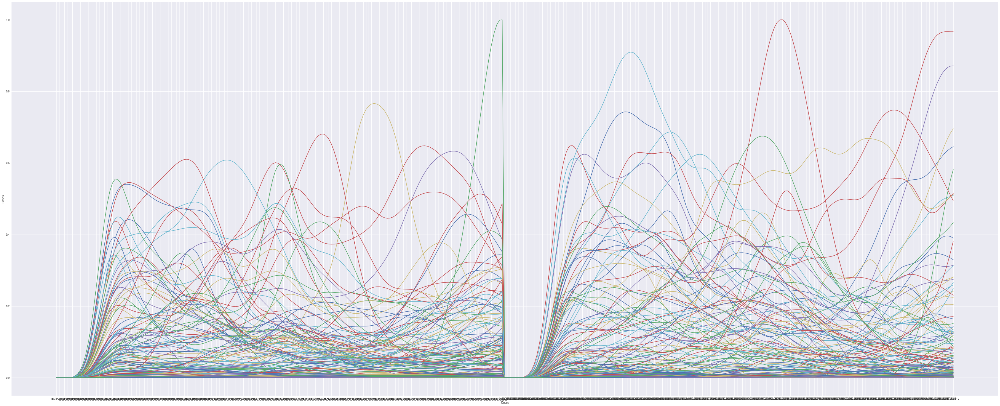

In [65]:
get_graphs(combined_copy, areas = combined['area'])

## Determine Shift Thresholds

In [66]:
# Get the index of the last column belonging to the CONFIRMED subset
last_index_confirmed = info_length+dates_length
combined[combined.columns[6:last_index_confirmed]].quantile([0.33, 0.66])

,11/1/20_x,11/2/20_x,11/3/20_x,11/4/20_x,11/5/20_x,11/6/20_x,11/7/20_x,11/8/20_x,11/9/20_x,11/10/20_x,11/11/20_x,11/12/20_x,11/13/20_x,11/14/20_x,11/15/20_x,11/16/20_x,11/17/20_x,11/18/20_x,11/19/20_x,11/20/20_x,11/21/20_x,11/22/20_x,11/23/20_x,11/24/20_x,11/25/20_x,11/26/20_x,11/27/20_x,11/28/20_x,11/29/20_x,11/30/20_x,12/1/20_x,12/2/20_x,12/3/20_x,12/4/20_x,12/5/20_x,12/6/20_x,12/7/20_x,12/8/20_x,12/9/20_x,12/10/20_x,...,3/10/21_x,3/11/21_x,3/12/21_x,3/13/21_x,3/14/21_x,3/15/21_x,3/16/21_x,3/17/21_x,3/18/21_x,3/19/21_x,3/20/21_x,3/21/21_x,3/22/21_x,3/23/21_x,3/24/21_x,3/25/21_x,3/26/21_x,3/27/21_x,3/28/21_x,3/29/21_x,3/30/21_x,3/31/21_x,4/1/21_x,4/2/21_x,4/3/21_x,4/4/21_x,4/5/21_x,4/6/21_x,4/7/21_x,4/8/21_x,4/9/21_x,4/10/21_x,4/11/21_x,4/12/21_x,4/13/21_x,4/14/21_x,4/15/21_x,4/16/21_x,4/17/21_x,4/18/21_x
0.33,0.0,0.0,0.0,0.0,0.0,0.0,0.000006,0.000029,0.000086,0.000202,0.000405,0.000731,0.001222,0.001905,0.002788,0.003869,0.005128,0.006519,0.007983,0.009438,0.010817,0.012066,0.013148,0.014039,0.014673,0.014888,0.014944,0.014885,0.014794,0.014676,0.014550,0.014441,0.014418,0.014865,0.015378,0.015979,0.016279,0.016224,0.016169,0.016118,...,0.017064,0.016831,0.016411,0.016000,0.015577,0.015122,0.014956,0.015159,0.015298,0.015952,0.015936,0.015672,0.015327,0.015391,0.014976,0.014749,0.015835,0.016970,0.017563,0.017095,0.016600,0.016056,0.015456,0.014874,0.014765,0.015667,0.016630,0.017618,0.018627,0.019606,0.019562,0.019483,0.019381,0.019809,0.019791,0.019095,0.018781,0.018699,0.019072,0.019900
0.66,0.0,0.0,0.0,0.0,0.0,0.0,0.000032,0.000160,0.000486,0.001140,0.002292,0.004144,0.006954,0.010895,0.016034,0.022354,0.029738,0.037967,0.046714,0.055540,0.064215,0.072342,0.079094,0.084535,0.088033,0.093234,0.093165,0.093045,0.092699,0.097396,0.103655,0.106233,0.109359,0.108828,0.107607,0.106337,0.106277,0.109307,0.112531,0.116066,...,0.075860,0.077158,0.078712,0.078918,0.078371,0.078087,0.078318,0.078001,0.077551,0.076536,0.075979,0.077409,0.078800,0.080532,0.084241,0.084965,0.086033,0.089088,0.092422,0.093920,0.094731,0.095386,0.096091,0.096843,0.097152,0.098265,0.098866,0.099890,0.101330,0.101724,0.097983,0.095018,0.094706,0.096082,0.099636,0.106673,0.104880,0.105680,0.109822,0.111816


In [67]:
# Get only the quantile of the confirmed
dates = combined[confirmed_columns]
vals = dates.to_numpy().flatten()
vals = vals[vals > 0]

In [68]:
num_countries = combined.shape[0]
shifts = [[] for i in range(num_countries)]
lows = np.quantile(vals, 0.33)
mids = np.quantile(vals, 0.66)
print(lows, mids)

0.012912996664063207 0.08568996604916768


In [69]:
rown=0
for i in combined.iterrows():
    cur_tmp='low'
    next_tmp='low'
    same_counter=15
    for j in range(6,last_index_confirmed):
        if i[1][j]<lows:
            next_tmp='low'
        elif i[1][j]<mids:
            next_tmp='mid'
        else:
            next_tmp='high'
        if cur_tmp==next_tmp:
            same_counter=same_counter+1
            if same_counter>=15:
                shifts[rown].append(next_tmp)
                cur_tmp=next_tmp
                same_counter=0
        else:
            shifts[rown].append(next_tmp)
            cur_tmp=next_tmp
            same_counter=0
    rown=rown+1

In [70]:
vector_shifts=[[] for i in range(num_countries)]
shift_change = {'lowlow':0, 'lowmid':1, 'lowhigh':6, 'midlow':2, 'midmid':5, 'midhigh':7, 'highmid':4, 'highhigh':8, 'highlow':3}

In [71]:
for i in range(0, num_countries):
    for j in range(1, len(shifts[i])):
        vector_shifts[i].append(shift_change[shifts[i][j-1]+shifts[i][j]])

In [72]:
number_of_shifts = [len(i) for i in shifts]

In [73]:
number_of_shifts_added = combined.copy()
number_of_shifts_added['shifts']=number_of_shifts
number_of_shifts_added.head()

,Province/State,Country/Region,Lat,Long,populations,area,11/1/20_x,11/2/20_x,11/3/20_x,11/4/20_x,11/5/20_x,11/6/20_x,11/7/20_x,11/8/20_x,11/9/20_x,11/10/20_x,11/11/20_x,11/12/20_x,11/13/20_x,11/14/20_x,11/15/20_x,11/16/20_x,11/17/20_x,11/18/20_x,11/19/20_x,11/20/20_x,11/21/20_x,11/22/20_x,11/23/20_x,11/24/20_x,11/25/20_x,11/26/20_x,11/27/20_x,11/28/20_x,11/29/20_x,11/30/20_x,12/1/20_x,12/2/20_x,12/3/20_x,12/4/20_x,...,3/11/21_y,3/12/21_y,3/13/21_y,3/14/21_y,3/15/21_y,3/16/21_y,3/17/21_y,3/18/21_y,3/19/21_y,3/20/21_y,3/21/21_y,3/22/21_y,3/23/21_y,3/24/21_y,3/25/21_y,3/26/21_y,3/27/21_y,3/28/21_y,3/29/21_y,3/30/21_y,3/31/21_y,4/1/21_y,4/2/21_y,4/3/21_y,4/4/21_y,4/5/21_y,4/6/21_y,4/7/21_y,4/8/21_y,4/9/21_y,4/10/21_y,4/11/21_y,4/12/21_y,4/13/21_y,4/14/21_y,4/15/21_y,4/16/21_y,4/17/21_y,4/18/21_y,shifts
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,5.845237e-07,0.000003,0.000009,0.000020,0.000041,0.000074,0.000123,0.000192,0.000282,0.000392,0.000521,0.000667,0.000825,0.000988,0.001152,0.001314,0.001472,0.001624,0.001771,0.001912,0.002049,0.002183,0.002313,0.002437,0.002555,0.002662,0.002757,0.002838,...,0.001281,0.001289,0.001281,0.001254,0.001211,0.001157,0.001096,0.001036,0.000983,0.000941,0.000913,0.000900,0.000904,0.000920,0.000944,0.000973,0.000999,0.001020,0.001031,0.001032,0.001022,0.001007,0.000992,0.000985,0.000997,0.001036,0.001111,0.001230,0.001396,0.001608,0.001859,0.002141,0.002440,0.002738,0.003015,0.003256,0.003446,0.003578,0.003644,12
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,2.951423e-05,0.000150,0.000455,0.001077,0.002184,0.003987,0.006735,0.010604,0.015683,0.021972,0.029368,0.037661,0.046527,0.055528,0.064289,0.072509,0.079975,0.086579,0.092320,0.097313,0.101777,0.105914,0.109891,0.113821,0.117752,0.121662,0.125465,0.129028,...,0.235761,0.240562,0.244936,0.248658,0.251500,0.253265,0.253813,0.253053,0.250963,0.247630,0.243229,0.238002,0.232197,0.226052,0.219785,0.213567,0.207474,0.201504,0.195599,0.189708,0.183781,0.177775,0.171688,0.165583,0.159549,0.153682,0.148036,0.142649,0.137567,0.132802,0.128347,0.124201,0.120365,0.116872,0.113744,0.110964,0.108483,0.106209,0.104009,13
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,2.245638e-06,0.000011,0.000035,0.000084,0.000171,0.000314,0.000534,0.000846,0.001261,0.001782,0.002404,0.003116,0.003895,0.004710,0.005533,0.006339,0.007109,0.007828,0.008488,0.009091,0.009643,0.010152,0.010625,0.011068,0.011482,0.011871,0.012231,0.012560,...,0.002912,0.002982,0.003060,0.003144,0.003227,0.003303,0.003366,0.003409,0.003428,0.003421,0.003389,0.003334,0.003263,0.003182,0.003096,0.003012,0.002933,0.002863,0.002804,0.002755,0.002716,0.002686,0.002666,0.002656,0.002656,0.002664,0.002682,0.002707,0.002740,0.002776,0.002813,0.002850,0.002882,0.002909,0.002930,0.002945,0.002954,0.002961,0.002966,13
3,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.0,0.0,0.0,0.0,0.0,0.0,5.659997e-05,0.000281,0.000840,0.001951,0.003884,0.006963,0.011562,0.017880,0.025949,0.035636,0.046651,0.058544,0.070710,0.082388,0.092997,0.102127,0.109531,0.115115,0.118937,0.121201,0.122262,0.122397,0.121822,0.120699,0.119149,0.117256,0.115079,0.112649,...,0.104659,0.103210,0.102268,0.101930,0.102175,0.102844,0.103721,0.104581,0.105226,0.105503,0.105317,0.104691,0.103763,0.102699,0.101650,0.100731,0.100015,0.099535,0.099250,0.099062,0.098896,0.098721,0.098546,0.098400,0.098320,0.098356,0.098552,0.098908,0.099384,0.099940,0.100583,0.101386,0.102475,0.104026,0.106282,0.109498,0.113878,0.119493,0.126255,15
4,no province,Armenia,40.06910,45.038200,2963243,no province Armenia,0.0,0.0,0.0,0.0,0.0,0.0,1.689108e-04,0.000844,0.002530,0.005898,0.011781,0.021175,0.035232,0.054578,0.079312,0.108999,0.142673,0.178835,0.215464,0.250027,0.280507,0.305434,0.323894,0.335555,0.340671,0.340089,0.335238,0.327437,0.317864,0.307531,0.297250,0.287610,0.278957,0.2713

In [74]:
max_shifts = max(number_of_shifts)
max_shifts

16

In [75]:
for i in vector_shifts:
    while(len(i))<max_shifts:
        i.append(-1)

In [76]:
shifts_added = number_of_shifts_added.copy()
for i in range(1, max_shifts+1):
    name='shift '+str(i)
    tmp=[]
    for j in vector_shifts:
        tmp.append(j[i-1])
    shifts_added[name] = tmp
shifts_added[shifts_added.columns[-max_shifts:]].head()

,shift 1,shift 2,shift 3,shift 4,shift 5,shift 6,shift 7,shift 8,shift 9,shift 10,shift 11,shift 12,shift 13,shift 14,shift 15,shift 16
0,0,0,0,0,0,0,0,0,0,0,0,-1,-1,-1,-1,-1
1,1,7,8,8,8,8,8,8,8,8,8,4,-1,-1,-1,-1
2,0,0,1,2,0,0,0,0,0,0,0,0,-1,-1,-1,-1
3,1,7,8,4,5,7,8,8,8,4,5,5,7,8,-1,-1
4,1,7,8,8,8,4,5,5,5,5,7,8,-1,-1,-1,-1


In [77]:
shifts_added.to_csv(os.path.join(BASE_DIR, 'data/combined_added_shifts_6months.csv'))

## Do the same for deaths and recoveries

In [ ]:
combined[death_columns].quantile([0.33, 0.66])

,9/1/20_y,9/2/20_y,9/3/20_y,9/4/20_y,9/5/20_y,9/6/20_y,9/7/20_y,9/8/20_y,9/9/20_y,9/10/20_y,9/11/20_y,9/12/20_y,9/13/20_y,9/14/20_y,9/15/20_y,9/16/20_y,9/17/20_y,9/18/20_y,9/19/20_y,9/20/20_y,9/21/20_y,9/22/20_y,9/23/20_y,9/24/20_y,9/25/20_y,9/26/20_y,9/27/20_y,9/28/20_y,9/29/20_y,9/30/20_y,10/1/20_y,10/2/20_y,10/3/20_y,10/4/20_y,10/5/20_y,10/6/20_y,10/7/20_y,10/8/20_y,10/9/20_y,10/10/20_y,...,1/7/21_y,1/8/21_y,1/9/21_y,1/10/21_y,1/11/21_y,1/12/21_y,1/13/21_y,1/14/21_y,1/15/21_y,1/16/21_y,1/17/21_y,1/18/21_y,1/19/21_y,1/20/21_y,1/21/21_y,1/22/21_y,1/23/21_y,1/24/21_y,1/25/21_y,1/26/21_y,1/27/21_y,1/28/21_y,1/29/21_y,1/30/21_y,1/31/21_y,2/1/21_y,2/2/21_y,2/3/21_y,2/4/21_y,2/5/21_y,2/6/21_y,2/7/21_y,2/8/21_y,2/9/21_y,2/10/21_y,2/11/21_y,2/12/21_y,2/13/21_y,2/14/21_y,2/15/21_y
0.33,0.0,0.0,0.0,0.0,0.0,0.0,1.526741e-08,9.493593e-08,3.084331e-07,7.606362e-07,0.000002,0.000004,0.000007,0.000011,0.000017,0.000025,0.000034,0.000047,0.000062,0.000080,0.000095,0.000102,0.000107,0.000109,0.000101,0.000093,0.000110,0.000114,0.000111,0.00011,0.000091,0.000088,0.000096,0.000081,0.000077,0.000083,0.000088,0.000087,0.000079,0.000088,...,0.000306,0.000367,0.000430,0.000461,0.000484,0.000490,0.000501,0.000474,0.000492,0.000511,0.000513,0.000515,0.000543,0.000639,0.000668,0.000757,0.000718,0.000660,0.000685,0.000801,0.000823,0.000809,0.000759,0.000751,0.000751,0.000759,0.000729,0.000704,0.000634,0.000570,0.000586,0.000659,0.000656,0.000606,0.000619,0.000620,0.000729,0.000693,0.000652,0.000627
0.66,0.0,0.0,0.0,0.0,0.0,0.0,9.886786e-07,4.682819e-06,1.403193e-05,3.268927e-05,0.000068,0.000129,0.000219,0.000340,0.000492,0.000661,0.000842,0.001085,0.001324,0.001545,0.001785,0.001988,0.002138,0.002232,0.002520,0.002666,0.002645,0.002769,0.002870,0.00292,0.003001,0.003280,0.003474,0.003424,0.003898,0.004067,0.004079,0.004291,0.004403,0.004279,...,0.012774,0.013191,0.013997,0.014546,0.014996,0.014481,0.014555,0.014742,0.014655,0.014448,0.014517,0.015441,0.016747,0.017898,0.018559,0.018765,0.019273,0.018921,0.018757,0.018211,0.018024,0.017885,0.017548,0.017386,0.018254,0.017781,0.017355,0.017799,0.017606,0.017779,0.018046,0.017641,0.017927,0.017586,0.017221,0.017576,0.017654,0.017346,0.017270,0.017552


In [ ]:
dates = combined[death_columns]
vals = dates.to_numpy().flatten()
vals = vals[vals > 0]

In [ ]:
num_countries = combined.shape[0]
shifts = [[] for i in range(num_countries)]
lows = np.quantile(vals, 0.33)
mids = np.quantile(vals, 0.66)
print(lows, mids)

0.000873770282499985 0.011463239667652725


In [ ]:
rown=0
for i in combined.iterrows():
    cur_tmp='low'
    next_tmp='low'
    same_counter=15
    for j in range(last_index_confirmed, last_index_confirmed + dates_length):
        if i[1][j]<lows:
            next_tmp='low'
        elif i[1][j]<mids:
            next_tmp='mid'
        else:
            next_tmp='high'
        if cur_tmp==next_tmp:
            same_counter=same_counter+1
            if same_counter>=15:
                shifts[rown].append(next_tmp)
                cur_tmp=next_tmp
                same_counter=0
        else:
            shifts[rown].append(next_tmp)
            cur_tmp=next_tmp
            same_counter=0
    rown=rown+1

In [ ]:
vector_shifts=[[] for i in range(num_countries)]
shift_change = {'lowlow':0, 'lowmid':1, 'lowhigh':6, 'midlow':2, 'midmid':5, 'midhigh':7, 'highmid':4, 'highhigh':8, 'highlow':3}

In [ ]:
for i in range(0, num_countries):
    for j in range(1, len(shifts[i])):
        vector_shifts[i].append(shift_change[shifts[i][j-1]+shifts[i][j]])

In [ ]:
number_of_shifts = [len(i) for i in shifts]

In [ ]:
number_of_shifts_added = combined.copy()
number_of_shifts_added['shifts']=number_of_shifts
number_of_shifts_added.head()

,Province/State,Country/Region,Lat,Long,populations,area,9/1/20_x,9/2/20_x,9/3/20_x,9/4/20_x,9/5/20_x,9/6/20_x,9/7/20_x,9/8/20_x,9/9/20_x,9/10/20_x,9/11/20_x,9/12/20_x,9/13/20_x,9/14/20_x,9/15/20_x,9/16/20_x,9/17/20_x,9/18/20_x,9/19/20_x,9/20/20_x,9/21/20_x,9/22/20_x,9/23/20_x,9/24/20_x,9/25/20_x,9/26/20_x,9/27/20_x,9/28/20_x,9/29/20_x,9/30/20_x,10/1/20_x,10/2/20_x,10/3/20_x,10/4/20_x,...,1/8/21_y,1/9/21_y,1/10/21_y,1/11/21_y,1/12/21_y,1/13/21_y,1/14/21_y,1/15/21_y,1/16/21_y,1/17/21_y,1/18/21_y,1/19/21_y,1/20/21_y,1/21/21_y,1/22/21_y,1/23/21_y,1/24/21_y,1/25/21_y,1/26/21_y,1/27/21_y,1/28/21_y,1/29/21_y,1/30/21_y,1/31/21_y,2/1/21_y,2/2/21_y,2/3/21_y,2/4/21_y,2/5/21_y,2/6/21_y,2/7/21_y,2/8/21_y,2/9/21_y,2/10/21_y,2/11/21_y,2/12/21_y,2/13/21_y,2/14/21_y,2/15/21_y,shifts
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,1.067715e-07,5.490283e-07,0.000002,0.000004,0.000008,0.000015,0.000026,0.000040,0.000060,0.000084,0.000111,0.000142,0.000175,0.000208,0.000238,0.000266,0.000289,0.000308,0.000322,0.000332,0.000339,0.000342,0.000344,0.000344,0.000342,0.000340,0.000337,0.000332,...,0.002984,0.002837,0.002683,0.002532,0.002394,0.002278,0.002189,0.002130,0.002100,0.002094,0.002104,0.002123,0.002144,0.002162,0.002172,0.002171,0.002159,0.002136,0.002103,0.002060,0.002008,0.001948,0.001882,0.001811,0.001737,0.001659,0.001580,0.001500,0.001420,0.001339,0.001256,0.001171,0.001084,0.000994,0.000905,0.000816,0.000731,0.000653,0.000584,13
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,5.356425e-06,2.702371e-05,0.000082,0.000193,0.000389,0.000706,0.001188,0.001861,0.002739,0.003819,0.005080,0.006483,0.007970,0.009462,0.010892,0.012205,0.013357,0.014321,0.015085,0.015654,0.016053,0.016306,0.016436,0.016465,0.016415,0.016304,0.016146,0.015951,...,0.030152,0.028826,0.027503,0.026218,0.025002,0.023887,0.022905,0.022080,0.021422,0.020930,0.020572,0.020310,0.020103,0.019906,0.019688,0.019425,0.019107,0.018751,0.018382,0.018032,0.017737,0.017529,0.017437,0.017485,0.017687,0.018053,0.018583,0.019270,0.020106,0.021078,0.022163,0.023333,0.024559,0.025819,0.027098,0.028386,0.029674,0.030964,0.032269,12
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,9.793922e-07,4.867298e-06,0.000015,0.000034,0.000067,0.000120,0.000199,0.000307,0.000445,0.000609,0.000795,0.000993,0.001194,0.001383,0.001551,0.001689,0.001793,0.001864,0.001901,0.001910,0.001898,0.001871,0.001834,0.001791,0.001746,0.001699,0.001653,0.001606,...,0.001828,0.001769,0.001705,0.001637,0.001567,0.001496,0.001427,0.001361,0.001300,0.001244,0.001195,0.001152,0.001115,0.001082,0.001052,0.001026,0.001002,0.000979,0.000959,0.000940,0.000924,0.000911,0.000899,0.000890,0.000883,0.000877,0.000872,0.000867,0.000862,0.000857,0.000851,0.000845,0.000837,0.000829,0.000819,0.000808,0.000797,0.000785,0.000774,13
3,no province,Andorra,42.50630,1.521800,77265,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,2.220478e-05,1.098629e-04,0.000328,0.000763,0.001526,0.002754,0.004613,0.007212,0.010610,0.014822,0.019811,0.025494,0.031727,0.038305,0.045077,0.051932,0.058791,0.065605,0.072352,0.079037,0.085706,0.092366,0.099000,0.105572,0.112031,0.118322,0.124381,0.130136,...,0.038438,0.035735,0.032585,0.029168,0.025686,0.022369,0.019414,0.017013,0.015348,0.014613,0.015016,0.016718,0.019789,0.024222,0.029924,0.036701,0.044249,0.052164,0.060007,0.067382,0.073978,0.079573,0.084071,0.087510,0.090018,0.091821,0.093133,0.094092,0.094762,0.095144,0.095180,0.094827,0.093983,0.092563,0.090602,0.088223,0.085563,0.082737,0.079767,14
4,no province,Angola,-11.20270,17.873900,32866272,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,2.100550e-07,1.040494e-06,0.000003,0.000007,0.000014,0.000026,0.000042,0.000066,0.000096,0.000133,0.000175,0.000222,0.000272,0.000323,0.000373,0.000420,0.000466,0.000508,0.000547,0.000584,0.000619,0.000654,0.000687,0.000720,0.000751,0.000782,0.000811,0.000838,...,0.000509,0.0004

In [ ]:
max_shifts = max(number_of_shifts)
max_shifts

17

In [ ]:
for i in vector_shifts:
    while(len(i))<max_shifts:
        i.append(-1)

In [ ]:
shifts_added = number_of_shifts_added.copy()
for i in range(1, max_shifts+1):
    name='shift '+str(i)
    tmp=[]
    for j in vector_shifts:
        tmp.append(j[i-1])
    shifts_added[name] = tmp
shifts_added[shifts_added.columns[-max_shifts:]].head()

,shift 1,shift 2,shift 3,shift 4,shift 5,shift 6,shift 7,shift 8,shift 9,shift 10,shift 11,shift 12,shift 13,shift 14,shift 15,shift 16,shift 17
0,0,0,0,0,0,1,5,5,5,5,5,2,-1,-1,-1,-1,-1
1,1,5,5,7,8,8,8,8,8,8,8,-1,-1,-1,-1,-1,-1
2,0,1,5,5,5,5,5,5,5,5,5,2,-1,-1,-1,-1,-1
3,0,0,1,7,8,8,4,5,7,8,8,8,8,-1,-1,-1,-1
4,0,0,1,5,2,0,0,0,0,0,0,-1,-1,-1,-1,-1,-1


In [ ]:
shifts_added.to_csv(os.path.join(BASE_DIR, 'data/combined_added_shifts_deaths_6months.csv'))

## Recoveries

In [ ]:
combined[combined.columns[2*last_index_confirmed-6:3*last_index_confirmed-12]].quantile([0.33, 0.66])

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,...,1/7/21,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21
0.33,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.001713,0.001774,0.001838,0.001884,0.001967,0.002009,0.001935,0.001833,0.001931,0.002075,0.002245,0.002422,0.002489,0.002432,0.002277,0.002118,0.002250,0.002240,0.002349,0.002551,0.003033,0.003106,0.002927,0.003089,0.002900,0.002726,0.002700,0.002952,0.002696,0.002586,0.002778,0.002855,0.002782,0.002683,0.002620,0.002560,0.002515,0.002483,0.002488,0.002483
0.66,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.044732,0.045016,0.044051,0.042602,0.043626,0.042956,0.041481,0.040462,0.039127,0.038349,0.036628,0.036660,0.038557,0.038890,0.039377,0.039593,0.038706,0.039839,0.041421,0.043462,0.046494,0.050326,0.054524,0.055455,0.057724,0.059711,0.058663,0.061170,0.062644,0.060509,0.062884,0.065940,0.068897,0.072240,0.074479,0.079695,0.077377,0.076030,0.078209,0.076528


In [ ]:
dates = combined[combined.columns[2*last_index_confirmed-6:3*last_index_confirmed-12]]
vals = dates.to_numpy().flatten()
vals = vals[vals > 0]

In [ ]:
num_countries = combined.shape[0]
shifts = [[] for i in range(num_countries)]
lows = np.quantile(vals, 0.33)
mids = np.quantile(vals, 0.66)
print(lows, mids)

0.0004425328623681252 0.010210190464689706


In [ ]:
rown=0
for i in combined.iterrows():
    cur_tmp='low'
    next_tmp='low'
    same_counter=15
    for j in range(2*last_index_confirmed-6, 3*last_index_confirmed-12):
        if i[1][j]<lows:
            next_tmp='low'
        elif i[1][j]<mids:
            next_tmp='mid'
        else:
            next_tmp='high'
        if cur_tmp==next_tmp:
            same_counter=same_counter+1
            if same_counter>=15:
                shifts[rown].append(next_tmp)
                cur_tmp=next_tmp
                same_counter=0
        else:
            shifts[rown].append(next_tmp)
            cur_tmp=next_tmp
            same_counter=0
    rown=rown+1

In [ ]:
vector_shifts=[[] for i in range(num_countries)]
shift_change = {'lowlow':0, 'lowmid':1, 'lowhigh':6, 'midlow':2, 'midmid':5, 'midhigh':7, 'highmid':4, 'highhigh':8, 'highlow':3}

In [ ]:
for i in range(0, num_countries):
    for j in range(1, len(shifts[i])):
        vector_shifts[i].append(shift_change[shifts[i][j-1]+shifts[i][j]])

In [ ]:
number_of_shifts = [len(i) for i in shifts]

In [ ]:
number_of_shifts_added = combined.copy()
number_of_shifts_added['shifts']=number_of_shifts
number_of_shifts_added.head()

,Province/State,Country/Region,Lat,Long,populations,area,1/22/20_x,1/23/20_x,1/24/20_x,1/25/20_x,1/26/20_x,1/27/20_x,1/28/20_x,1/29/20_x,1/30/20_x,1/31/20_x,2/1/20_x,2/2/20_x,2/3/20_x,2/4/20_x,2/5/20_x,2/6/20_x,2/7/20_x,2/8/20_x,2/9/20_x,2/10/20_x,2/11/20_x,2/12/20_x,2/13/20_x,2/14/20_x,2/15/20_x,2/16/20_x,2/17/20_x,2/18/20_x,2/19/20_x,2/20/20_x,2/21/20_x,2/22/20_x,2/23/20_x,2/24/20_x,...,1/8/21,1/9/21,1/10/21,1/11/21,1/12/21,1/13/21,1/14/21,1/15/21,1/16/21,1/17/21,1/18/21,1/19/21,1/20/21,1/21/21,1/22/21,1/23/21,1/24/21,1/25/21,1/26/21,1/27/21,1/28/21,1/29/21,1/30/21,1/31/21,2/1/21,2/2/21,2/3/21,2/4/21,2/5/21,2/6/21,2/7/21,2/8/21,2/9/21,2/10/21,2/11/21,2/12/21,2/13/21,2/14/21,2/15/21,shifts
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.320590e-10,...,0.004550,0.004639,0.004665,0.004638,0.004572,0.004487,0.004401,0.004334,0.004300,0.004311,0.004369,0.004471,0.004609,0.004772,0.004946,0.005115,0.005268,0.005393,0.005482,0.005530,0.005533,0.005490,0.005401,0.005268,0.005092,0.004878,0.004630,0.004355,0.004058,0.003748,0.003434,0.003124,0.002824,0.002543,0.002285,0.002053,0.001849,0.001674,0.001526,28
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.135301,0.134454,0.133399,0.132174,0.130825,0.129404,0.127962,0.126548,0.125200,0.123942,0.122787,0.121736,0.120783,0.119922,0.119153,0.118491,0.117963,0.117610,0.117482,0.117627,0.118086,0.118880,0.120009,0.121445,0.123141,0.125028,0.127032,0.129079,0.131102,0.133053,0.134907,0.136661,0.138340,0.139990,0.141675,0.143476,0.145479,0.147771,0.150433,27
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.006820,0.006665,0.006496,0.006312,0.006111,0.005896,0.005670,0.005437,0.005203,0.004974,0.004756,0.004555,0.004374,0.004215,0.004081,0.003970,0.003880,0.003810,0.003755,0.003713,0.003683,0.003660,0.003645,0.003635,0.003630,0.003630,0.003632,0.003638,0.003645,0.003654,0.003661,0.003668,0.003673,0.003674,0.003672,0.003667,0.003658,0.003646,0.003632,27
3,no province,Andorra,42.50630,1.521800,77265,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.442531,0.432059,0.421755,0.411722,0.402147,0.393315,0.385626,0.379577,0.375730,0.374661,0.376889,0.382810,0.392625,0.406271,0.423396,0.443378,0.465384,0.488465,0.511658,0.534104,0.555149,0.574390,0.591675,0.607065,0.620761,0.633021,0.644069,0.654045,0.662985,0.670839,0.677503,0.682857,0.686804,0.689300,0.690354,0.690013,0.688341,0.685395,0.681212,29
4,no province,Angola,-11.20270,17.873900,32866272,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.002668,0.002794,0.002932,0.003084,0.003253,0.003447,0.003676,0.003953,0.004293,0.004707,0.005199,0.005764,0.006385,0.007034,0.007671,0.008253,0.008734,0.009073,0.009240,0.009221,0.009017,0.008643,0.008132,0.007521,0.006853,0.006171,0.005512,0.004902,0.004363,0.003904,0.003528,0.003228,0.002996,0.002819,0.002684,0.002577,0.002486,0.002401,0.002315,29


In [ ]:
max_shifts = max(number_of_shifts)
max_shifts

33

In [ ]:
for i in vector_shifts:
    while(len(i))<max_shifts:
        i.append(-1)

In [ ]:
shifts_added = number_of_shifts_added.copy()
for i in range(1, max_shifts+1):
    name='shift '+str(i)
    tmp=[]
    for j in vector_shifts:
        tmp.append(j[i-1])
    shifts_added[name] = tmp
shifts_added[shifts_added.columns[-max_shifts:]].head()

,shift 1,shift 2,shift 3,shift 4,shift 5,shift 6,shift 7,shift 8,shift 9,shift 10,shift 11,shift 12,shift 13,shift 14,shift 15,shift 16,shift 17,shift 18,shift 19,shift 20,shift 21,shift 22,shift 23,shift 24,shift 25,shift 26,shift 27,shift 28,shift 29,shift 30,shift 31,shift 32,shift 33
0,0,0,0,0,0,0,0,1,5,5,5,7,8,4,5,5,5,5,5,5,5,5,5,5,5,5,5,-1,-1,-1,-1,-1,-1
1,0,0,0,0,1,5,5,5,5,5,5,7,8,8,8,8,8,8,8,8,8,8,8,8,8,8,-1,-1,-1,-1,-1,-1,-1
2,0,0,0,0,0,1,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,7,4,5,5,5,-1,-1,-1,-1,-1,-1,-1
3,0,0,0,0,1,5,7,8,8,8,8,8,4,5,5,7,8,8,8,8,8,8,8,8,8,8,8,8,-1,-1,-1,-1,-1
4,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,1,5,2,1,5,5,5,5,5,5,5,5,5,-1,-1,-1,-1,-1


In [ ]:
shifts_added.to_csv(os.path.join(BASE_DIR, 'data/combined_added_shifts_recoveries.csv'))